# Data Wrangling

In [ ]:
import pandas as pd

In [ ]:
crop_df = pd.read_csv('Crop_Data.csv', parse_dates=['Period'])

In [ ]:
crop_df.dtypes

,0
Period,datetime64[ns]
Nitrogen,int64
Phosphorus,int64
Potassium,int64
Temperature,float64
Humidity,float64
pH_Value,float64
Rainfall,float64
Crop Category,object
Crop,object


In [ ]:
crop_df.isnull().sum()

,0
Period,0
Nitrogen,0
Phosphorus,0
Potassium,0
Temperature,0
Humidity,0
pH_Value,0
Rainfall,0
Crop Category,0
Crop,0


In [ ]:
df=crop_df.copy()

In [ ]:
crops = df['Crop'].unique()
outliers_report = {}
for crop in crops:
    temp_crop = df[df['Crop'] == crop]
    Q1 = temp_crop['Yield'].quantile(0.25)
    Q3 = temp_crop['Yield'].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    outliers = temp_crop[(temp_crop['Yield'] < lower_bound) | (temp_crop['Yield'] > upper_bound)]

    outliers_report[crop] = {
        'count': len(outliers),
        'lower_bound': lower_bound,
        'upper_bound': upper_bound,
        'outliers': outliers[['Period', 'Yield']]
    }
for crop, data in outliers_report.items():
    print(f"\nCrop: {crop}")
    print(f"Potential outliers: {data['count']}")
    print(f"IQR Range: [{data['lower_bound']:.2f} - {data['upper_bound']:.2f}]")
    if data['count'] > 0:
        print("Outlier Details:")
        print(data['outliers'].to_string(index=False))


Crop: Rice
Potential outliers: 6
IQR Range: [-3813.75 - 9756.25]
Outlier Details:
    Period  Yield
2021-02-01 120000
2021-03-01  10000
2021-03-08  11000
2022-08-22  19500
2022-08-29  22250
2022-09-05  20500

Crop: Maize
Potential outliers: 2
IQR Range: [-1471.62 - 5919.38]
Outlier Details:
    Period  Yield
2021-03-01   6100
2022-07-04   6300

Crop: ChickPea
Potential outliers: 7
IQR Range: [-2781.25 - 7268.75]
Outlier Details:
    Period  Yield
2021-02-15   8000
2021-11-29   8000
2022-01-17   9000
2022-04-11   7500
2022-06-20   7500
2022-10-10   8750
2022-11-14   9500

Crop: KidneyBeans
Potential outliers: 2
IQR Range: [-3312.50 - 9187.50]
Outlier Details:
    Period  Yield
2021-07-12  20000
2022-01-10   9800

Crop: PigeonPeas
Potential outliers: 14
IQR Range: [-1593.75 - 8956.25]
Outlier Details:
    Period  Yield
2021-02-15   9000
2021-03-01  11000
2021-11-08  19750
2021-11-15  29250
2021-11-29  18150
2021-12-06  10250
2021-12-13  12350
2021-12-27  21500
2022-01-24  10100
2022-01-

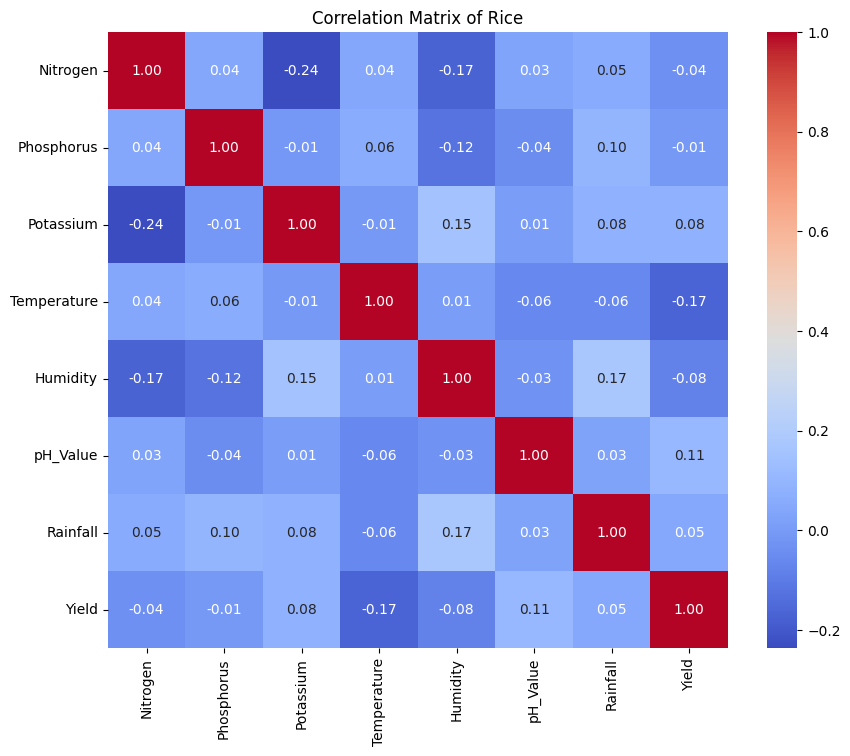

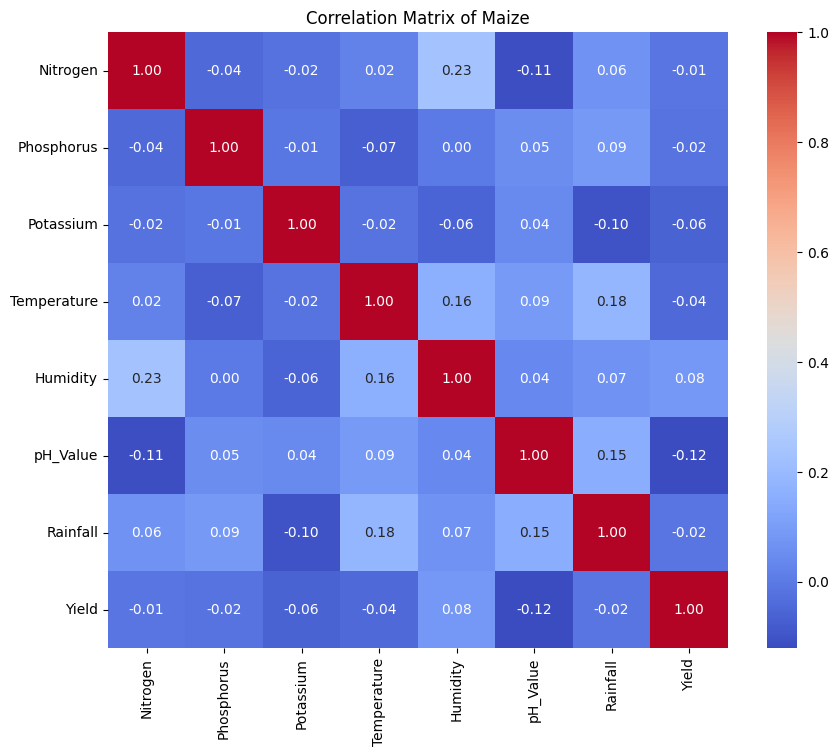

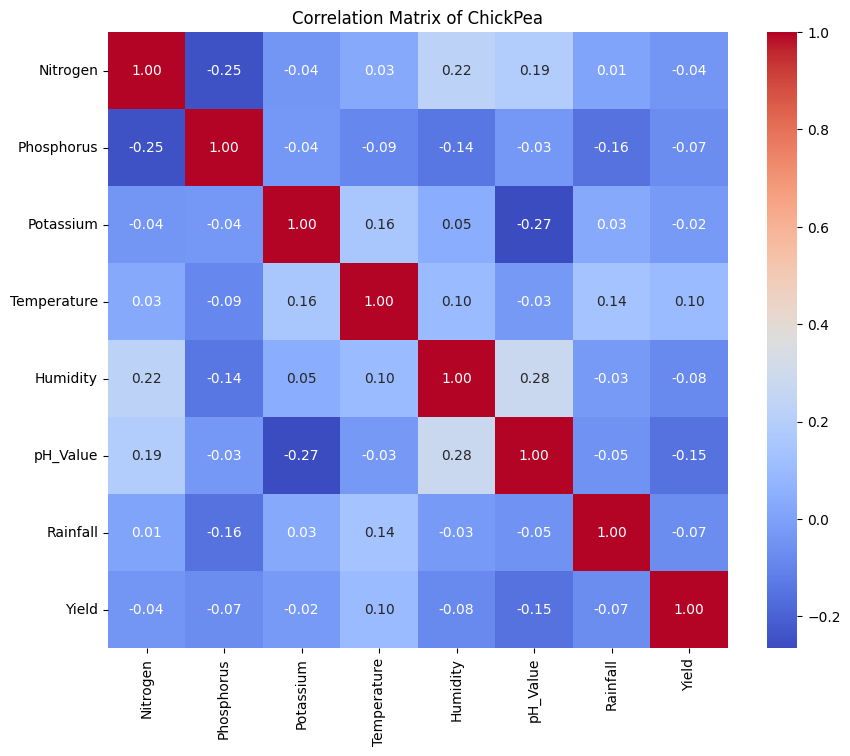

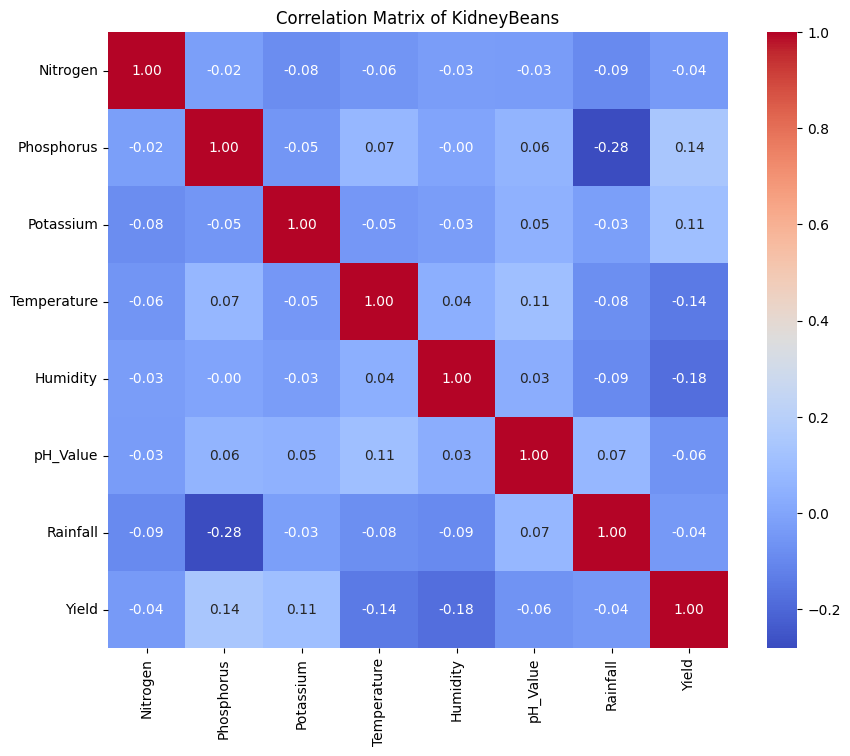

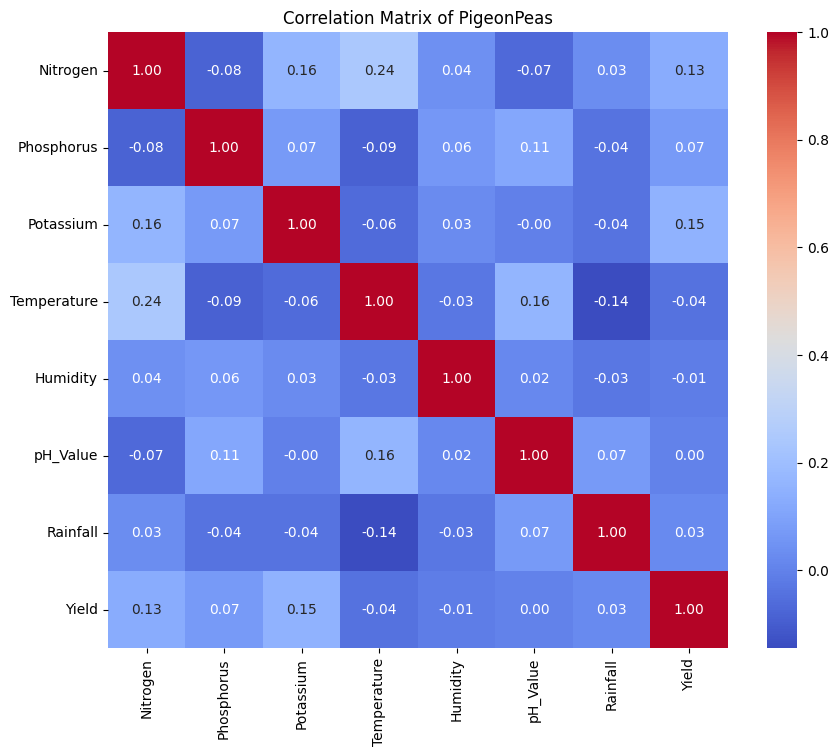

...

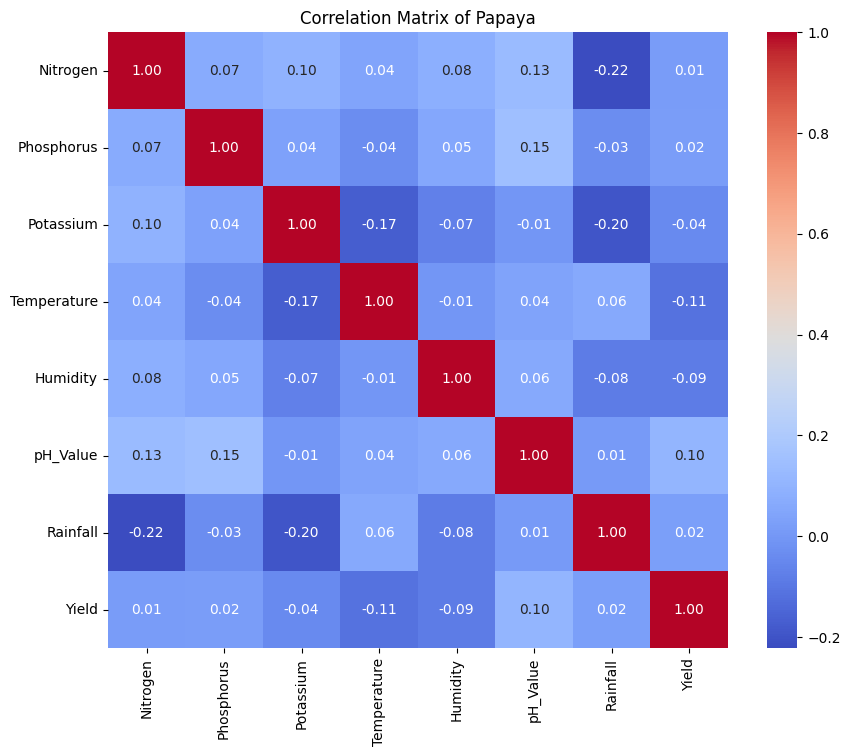

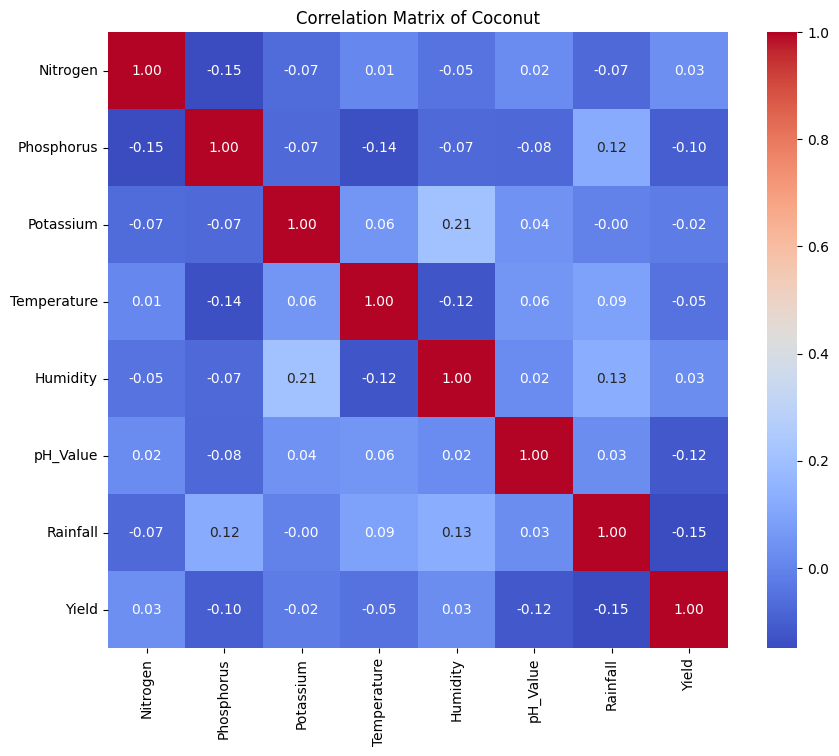

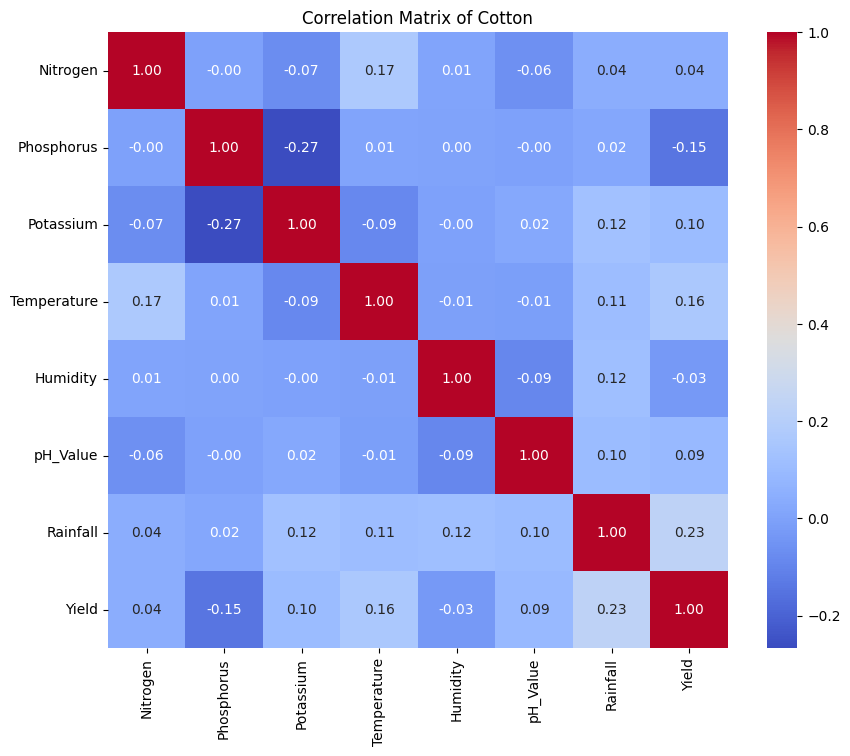

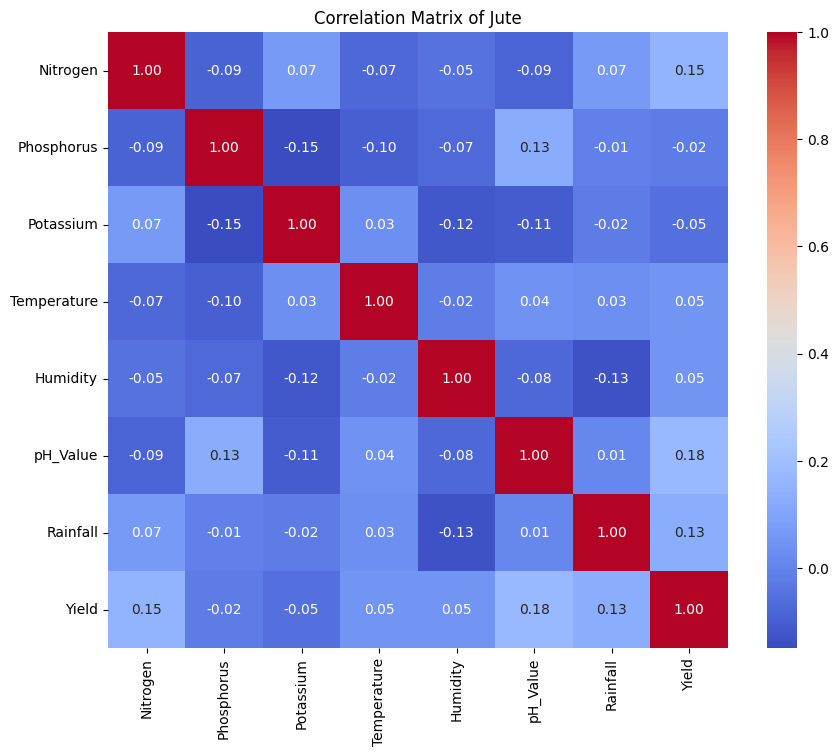

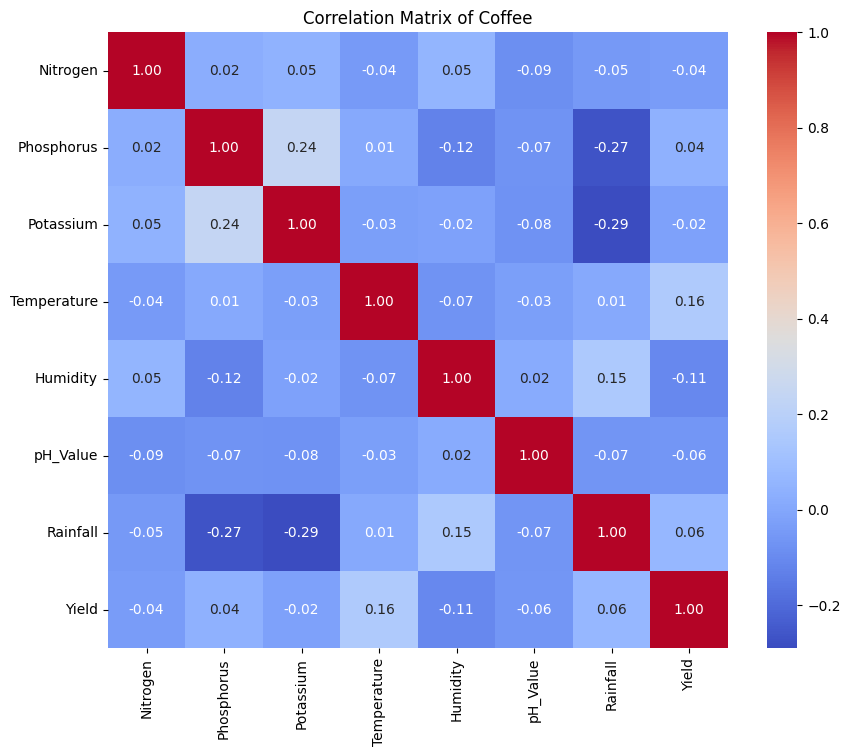

In [ ]:
import seaborn as sns

for crop in crops:
    temp_crop = crop_df[crop_df['Crop'] == crop]
    corr_df=temp_crop.drop(['Period','Crop','Crop Category'],axis=1)
    correlation_matrix =corr_df.corr()
    plt.figure(figsize=(10, 8))
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
    plt.title(f'Correlation Matrix of {crop}')
    plt.show()

# SARIMAX

## checking either to use ARIMAX or SARIMAX

In [2]:
# !pip install pmdarima

In [1]:
# !pip install --upgrade numpy==1.24.3 --force-reinstall
# !pip install --upgrade pmdarima --force-reinstall

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.seasonal import STL
#sesonal decomposition does not work if there are less than 104 observations as weekly period requires 52
#so intaed use STL as they have more flexibility
import warnings
warnings.filterwarnings("ignore")

df = pd.read_csv('Crop_Data.csv', parse_dates=['Period'])

df['Date'] = pd.to_datetime(df['Period'])
crop_groups = df.groupby('Crop')

def check_stl(crop_df, crop_name):
    crop_df = crop_df.set_index('Date').sort_index()

    weekly = crop_df['Yield'].resample('W').sum()

    try:
        stl = STL(weekly, period=52)
        result = stl.fit()
        seasonality_strength = result.seasonal.std() / weekly.std()

        if seasonality_strength > 0.3:
            print(f"[{crop_name}]  Use SARIMA (STL detected strong seasonality)")
        else:
            print(f"[{crop_name}]  Use ARIMA (Weak/no seasonality)")
    except Exception as e:
        print(f"[{crop_name}] STL failed — Defaulting to ARIMA | Error: {e}")

for crop, group in crop_groups:
    check_stl(group.copy(), crop)

[Apple]  Use SARIMA (STL detected strong seasonality)
[Banana]  Use SARIMA (STL detected strong seasonality)
[Blackgram]  Use SARIMA (STL detected strong seasonality)
[ChickPea]  Use SARIMA (STL detected strong seasonality)
[Coconut]  Use SARIMA (STL detected strong seasonality)
[Coffee]  Use SARIMA (STL detected strong seasonality)
[Cotton]  Use SARIMA (STL detected strong seasonality)
[Grapes]  Use SARIMA (STL detected strong seasonality)
[Jute]  Use SARIMA (STL detected strong seasonality)
[KidneyBeans]  Use SARIMA (STL detected strong seasonality)
[Lentil]  Use SARIMA (STL detected strong seasonality)
[Maize]  Use SARIMA (STL detected strong seasonality)
[Mango]  Use SARIMA (STL detected strong seasonality)
[MothBeans]  Use SARIMA (STL detected strong seasonality)
[MungBean]  Use SARIMA (STL detected strong seasonality)
[Muskmelon]  Use SARIMA (STL detected strong seasonality)
[Orange]  Use SARIMA (STL detected strong seasonality)
[Papaya]  Use SARIMA (STL detected strong seasonali

In [3]:
# pip install --upgrade scikit-learn

## 1st model: SARIMAX without exogenous


Processing crop: Apple
[Evaluation Metrics]
RMSE: 1968.83 | MAE: 1529.19 | MAPE: 135.37%


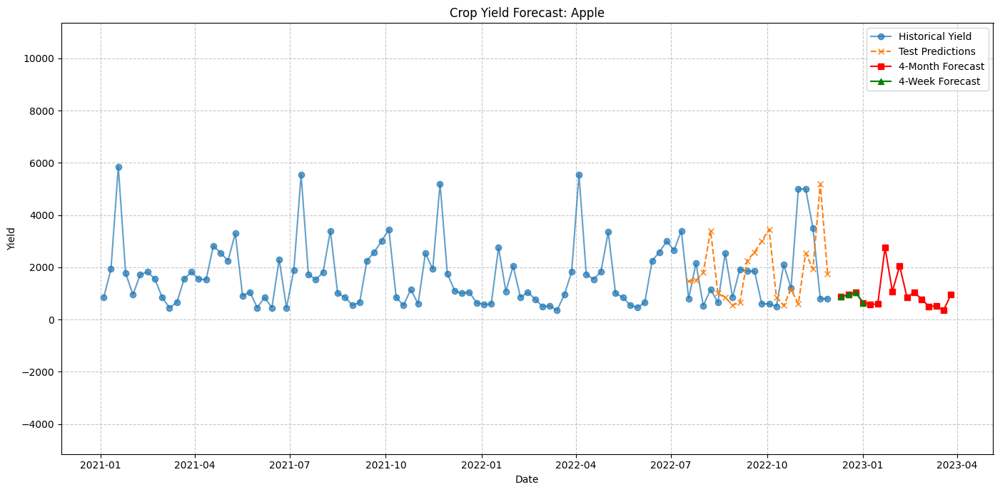


Processing crop: Banana
[Evaluation Metrics]
RMSE: 3408.04 | MAE: 2659.45 | MAPE: 196.47%


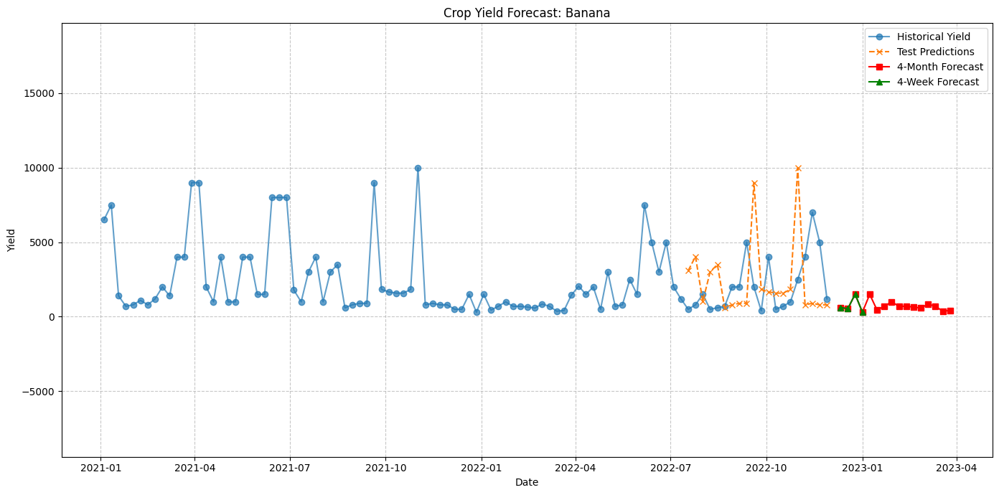


Processing crop: Blackgram
[Evaluation Metrics]
RMSE: 2435.89 | MAE: 1886.67 | MAPE: 19495.00%


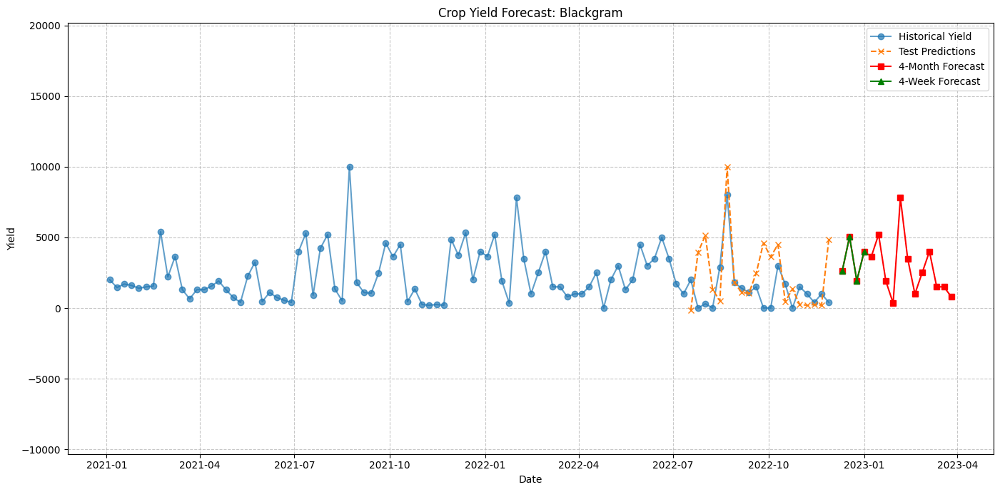


Processing crop: ChickPea
[Evaluation Metrics]
RMSE: 3012.99 | MAE: 2171.10 | MAPE: 63.55%


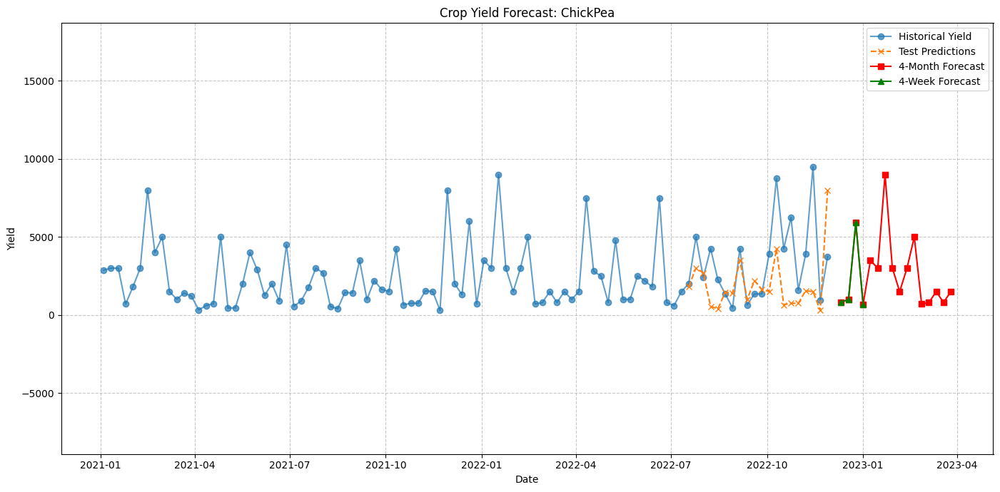


Processing crop: Coconut
[Evaluation Metrics]
RMSE: 2637.13 | MAE: 1848.69 | MAPE: 198.47%


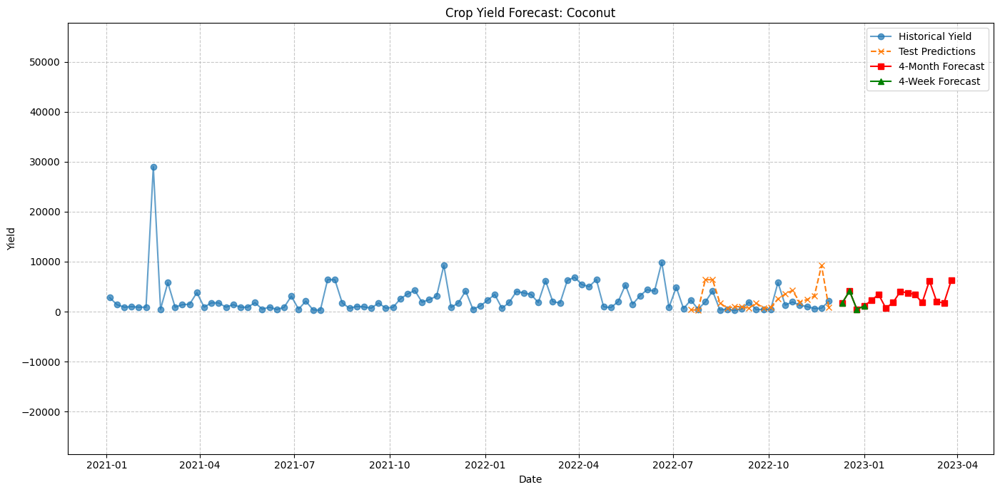


Processing crop: Coffee
[Evaluation Metrics]
RMSE: 3860.94 | MAE: 2964.44 | MAPE: 199.21%


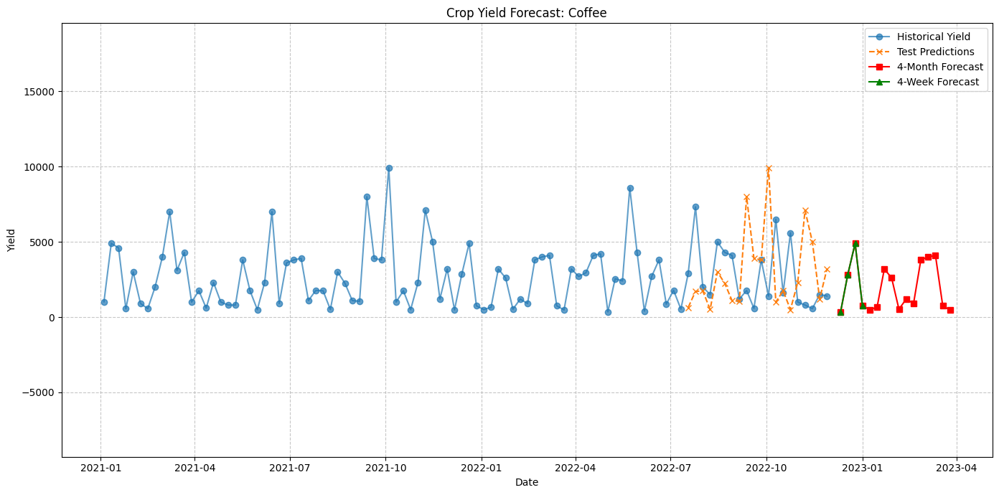


Processing crop: Cotton
[Evaluation Metrics]
RMSE: 1519.04 | MAE: 987.05 | MAPE: 135.15%


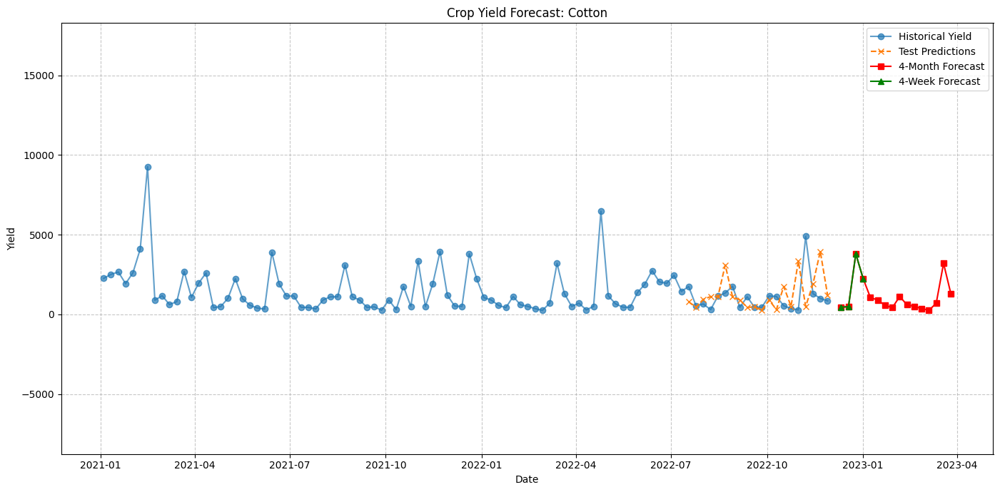


Processing crop: Grapes
[Evaluation Metrics]
RMSE: 3267.52 | MAE: 2510.21 | MAPE: 66.91%


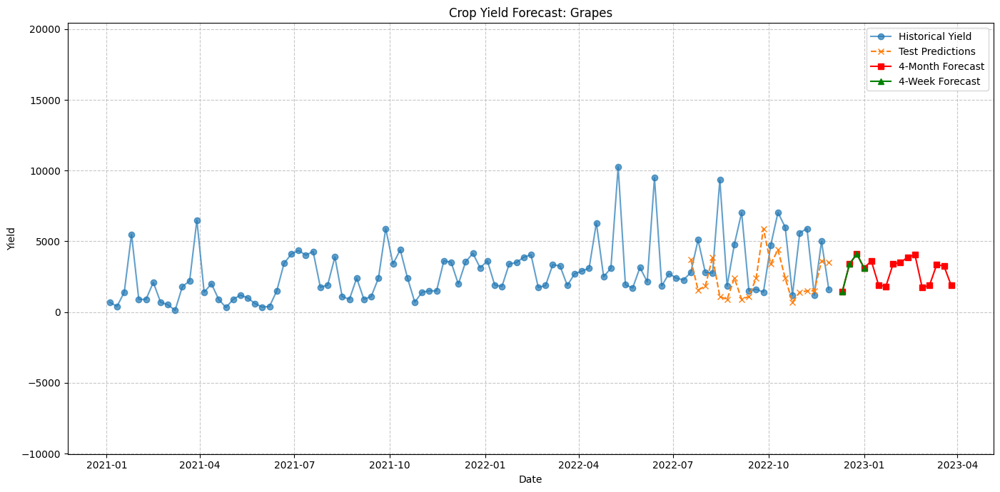


Processing crop: Jute
[Evaluation Metrics]
RMSE: 3412.06 | MAE: 2465.76 | MAPE: 71.83%


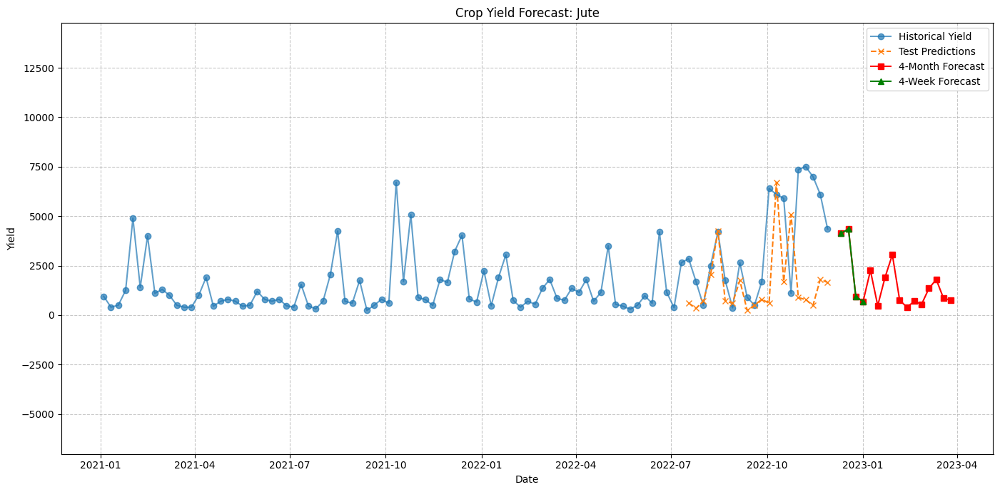


Processing crop: KidneyBeans
[Evaluation Metrics]
RMSE: 3221.92 | MAE: 2246.59 | MAPE: 95.26%


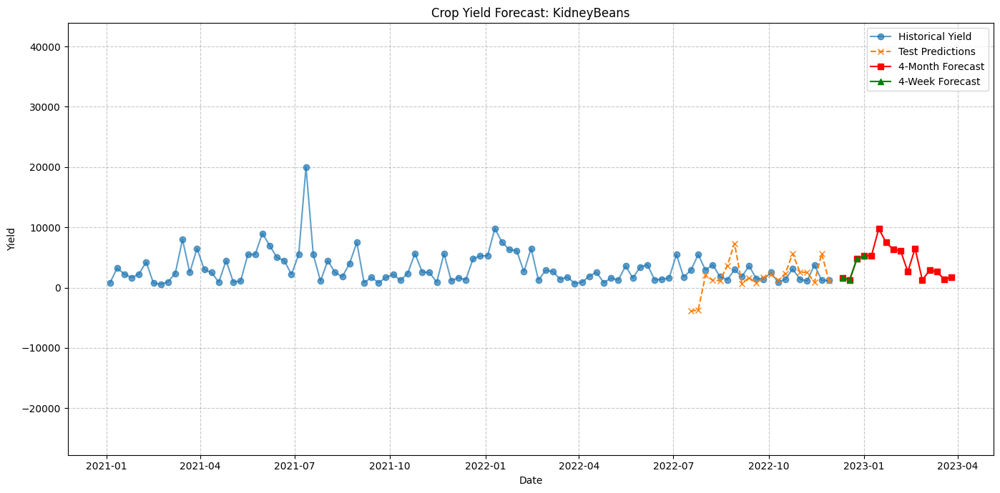


Processing crop: Lentil
[Evaluation Metrics]
RMSE: 3082.81 | MAE: 2137.99 | MAPE: 3372.80%


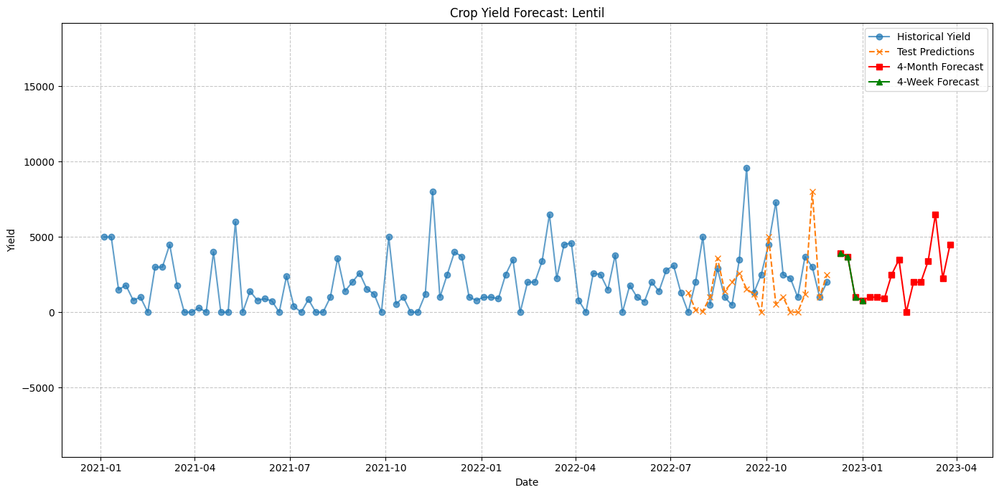


Processing crop: Maize
[Evaluation Metrics]
RMSE: 1783.10 | MAE: 1459.70 | MAPE: 115.44%


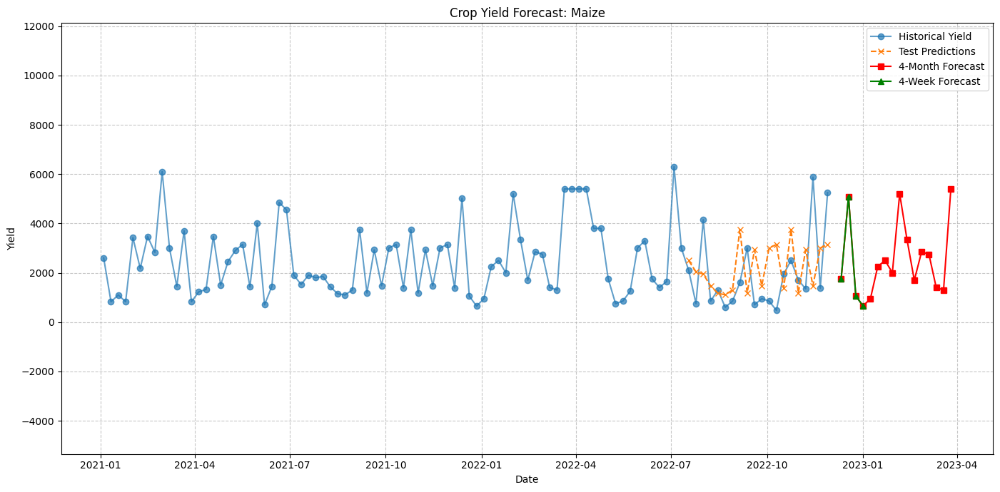


Processing crop: Mango
[Evaluation Metrics]
RMSE: 2324.40 | MAE: 1576.52 | MAPE: 218.86%


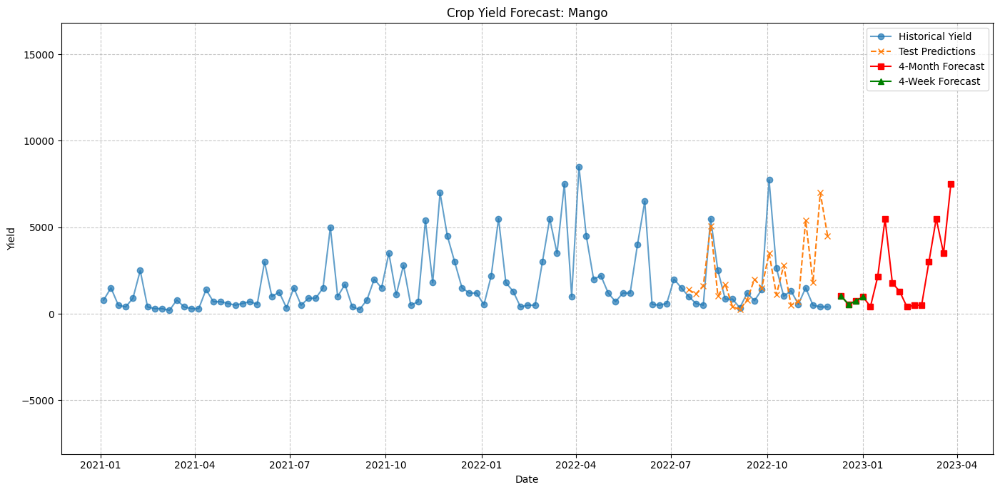


Processing crop: MothBeans
[Evaluation Metrics]
RMSE: 1820.80 | MAE: 1202.16 | MAPE: 52.92%


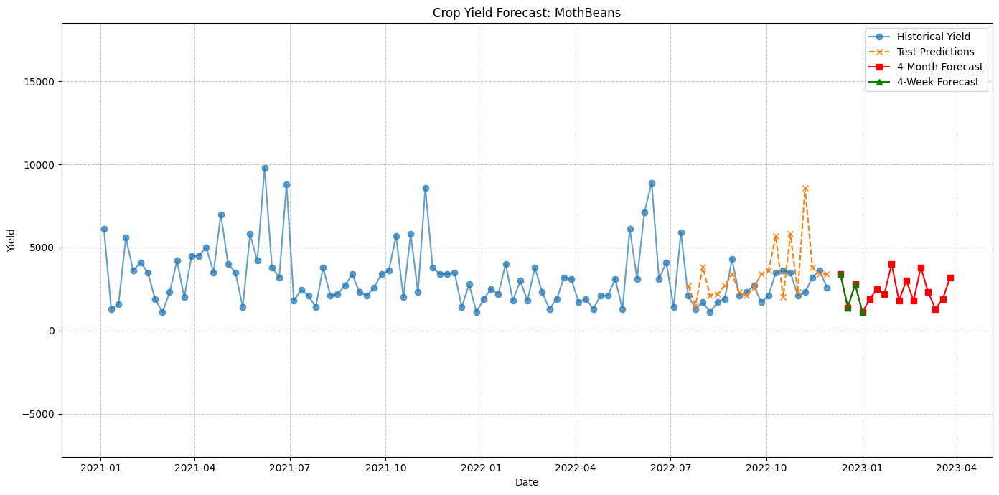


Processing crop: MungBean
[Evaluation Metrics]
RMSE: 1990.25 | MAE: 1516.64 | MAPE: 147.63%


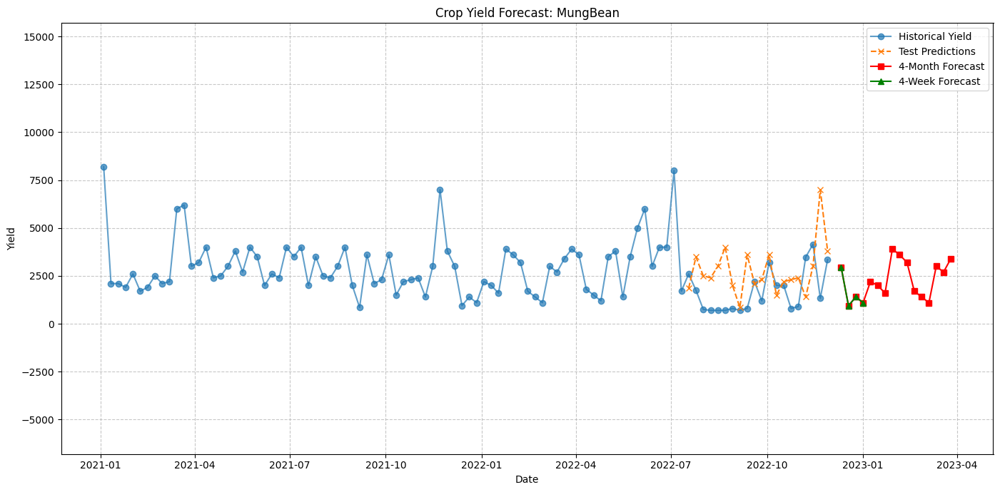


Processing crop: Muskmelon
[Evaluation Metrics]
RMSE: 3647.28 | MAE: 2257.26 | MAPE: 301.43%


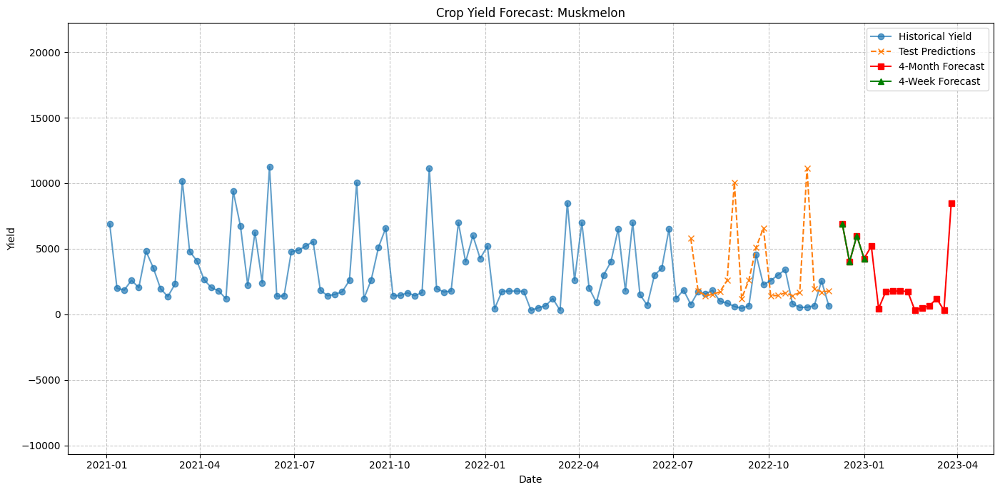


Processing crop: Orange
[Evaluation Metrics]
RMSE: 1395.24 | MAE: 1097.51 | MAPE: 154.76%


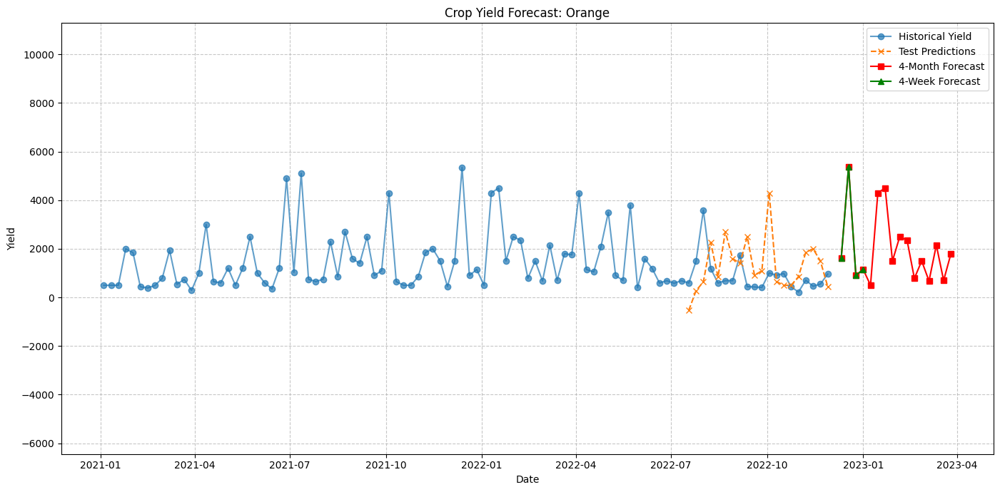


Processing crop: Papaya
[Evaluation Metrics]
RMSE: 2579.48 | MAE: 1735.65 | MAPE: 66.80%


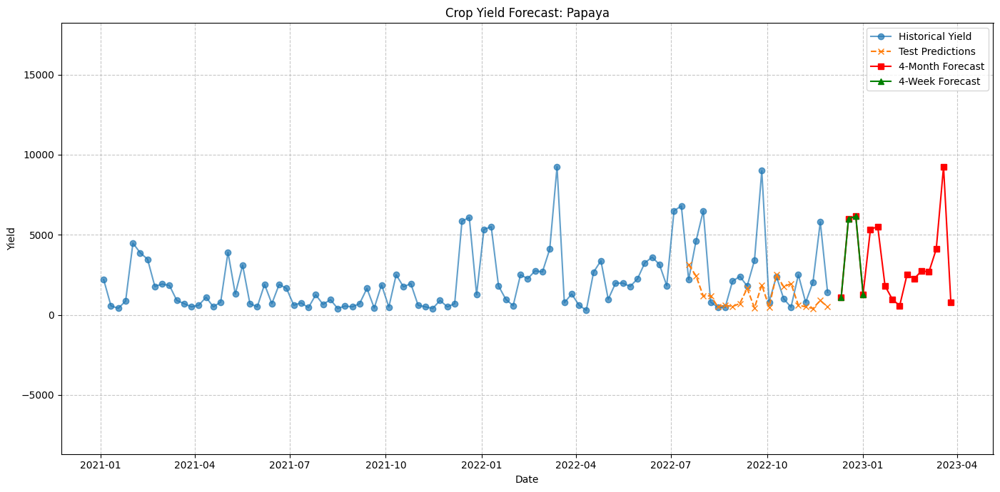


Processing crop: PigeonPeas
[Evaluation Metrics]
RMSE: 9580.96 | MAE: 5320.86 | MAPE: 129.87%


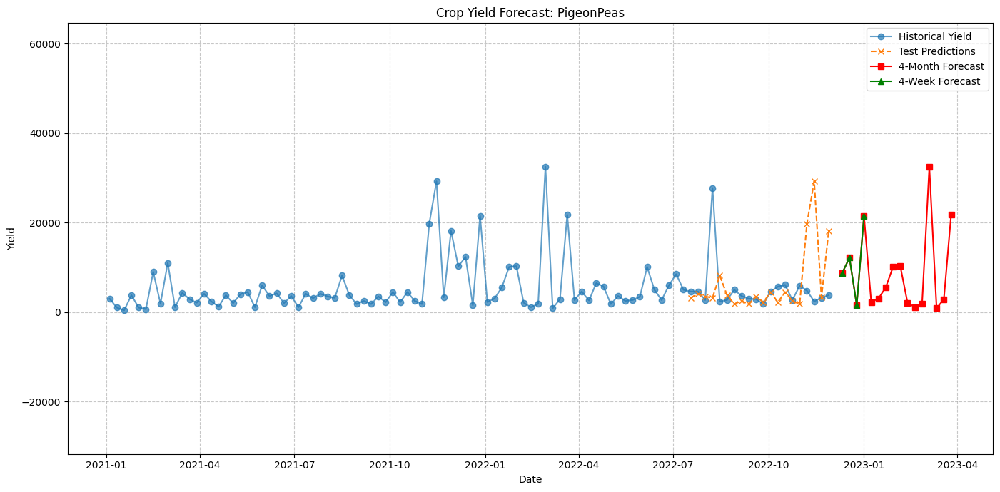


Processing crop: Pomegranate
[Evaluation Metrics]
RMSE: 7347.73 | MAE: 4216.46 | MAPE: 327.31%


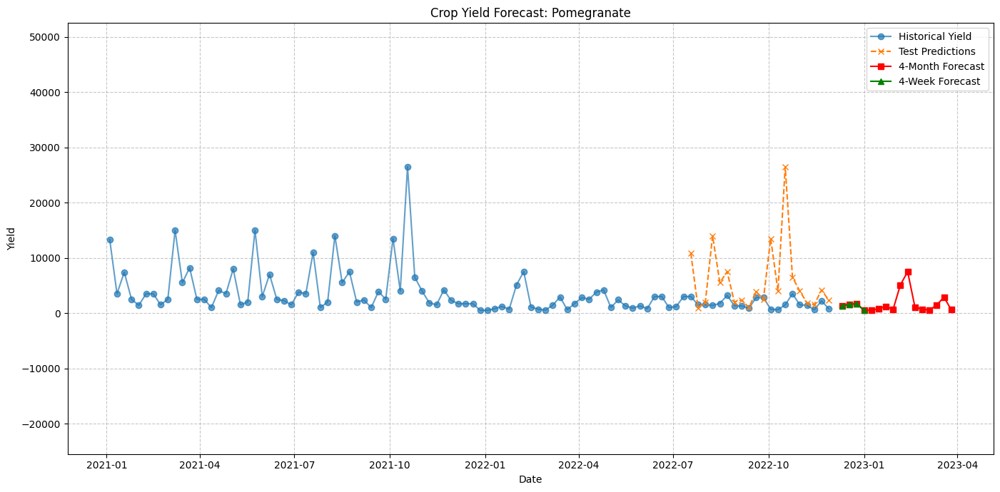


Processing crop: Rice
[Evaluation Metrics]
RMSE: 7218.80 | MAE: 4102.13 | MAPE: 100.13%


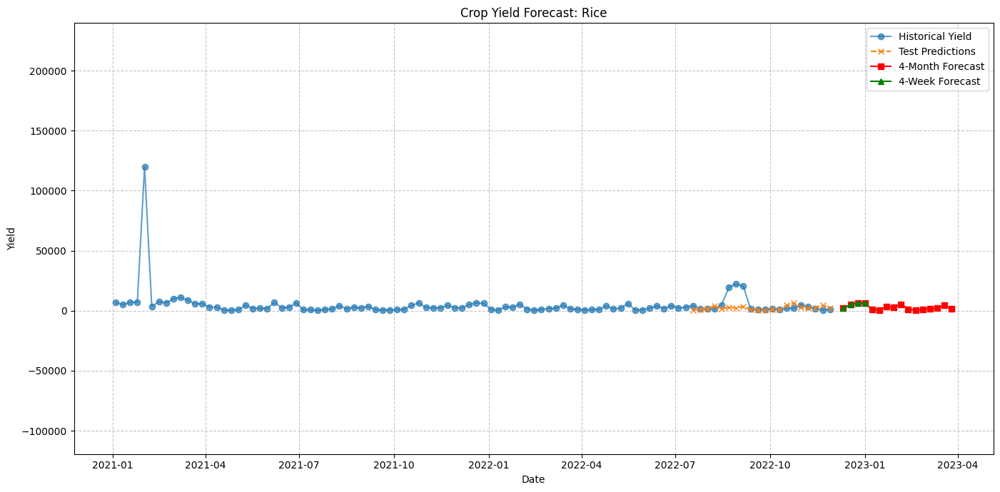


Processing crop: Watermelon
[Evaluation Metrics]
RMSE: 4540.00 | MAE: 3468.82 | MAPE: 101.17%


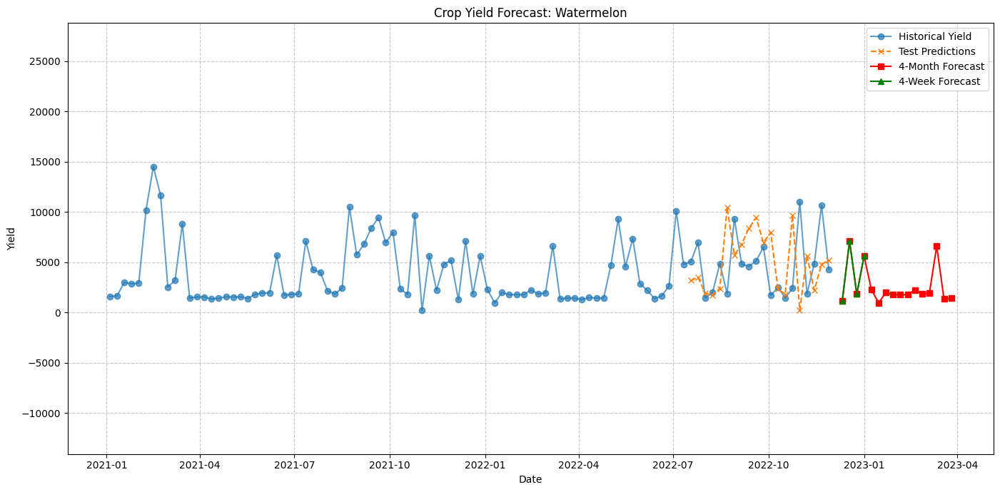



 Final Results Summary:

Apple

4-Week Forecast:
                      0
2022-12-11   869.743411
2022-12-18   944.772816
2022-12-25  1036.753726
2023-01-01   636.822873

4-Month Forecast:
                      0
2022-12-11   869.743411
2022-12-18   944.772816
2022-12-25  1036.753726
2023-01-01   636.822873
2023-01-08   579.237964
2023-01-15   589.817225
2023-01-22  2749.956161
2023-01-29  1079.989485
2023-02-05  2049.997478
2023-02-12   849.999395
2023-02-19  1039.999855
2023-02-26   779.999965
2023-03-05   499.999992
2023-03-12   519.999998
2023-03-19   350.000000
2023-03-26   950.000000

Banana

4-Week Forecast:
                      0
2022-12-11   623.403360
2022-12-18   538.070973
2022-12-25  1511.745215
2023-01-01   303.623497

4-Month Forecast:
                      0
2022-12-11   623.403360
2022-12-18   538.070973
2022-12-25  1511.745215
2023-01-01   303.623497
2023-01-08  1501.117879
2023-01-15   450.344875
2023-01-22   700.106397
2023-01-29  1000.032824
2023-02-05   700.0101

In [5]:
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
import numpy as np
import warnings
warnings.filterwarnings("ignore")

df = pd.read_csv('Crop_Data.csv', parse_dates=['Period'])
df['Period'] = pd.to_datetime(df['Period'])
df.set_index('Period', inplace=True)

crop_groups = df.groupby('Crop')
results = {}

#looping for every crop in the csv
for crop, group in crop_groups:
    print(f"\n{'='*40}\nProcessing crop: {crop}\n{'='*40}")

    crop_df = group.copy().sort_index()

#spiltling the data into 80 - 20 % for model evalution
    train_size = int(len(crop_df) * 0.8)
    train_data, test_data = crop_df.iloc[:train_size], crop_df.iloc[train_size:]

    order = (1, 0, 0)
    seasonal_order = (0, 1, 1, 52)
#training with 80% data
    try:
        model_train = SARIMAX(train_data['Yield'],
                             order=order,
                             seasonal_order=seasonal_order,
                             enforce_stationarity=False)
        sarimax_train = model_train.fit(disp=False)
#prediction
        test_pred = sarimax_train.get_prediction(
            start=test_data.index[0],
            end=test_data.index[-1],
            dynamic=False
        )
        test_data['Predicted'] = test_pred.predicted_mean
#metrics calcualtion
        test_rmse = np.sqrt(mean_squared_error(test_data['Yield'], test_data['Predicted']))
        test_mae = mean_absolute_error(test_data['Yield'], test_data['Predicted'])
        test_mape = np.mean(np.abs((test_data['Yield'] - test_data['Predicted']) / test_data['Yield'])) * 100

        print(f"[Evaluation Metrics]")
        print(f"RMSE: {test_rmse:.2f} | MAE: {test_mae:.2f} | MAPE: {test_mape:.2f}%")

#using full data to forecast into 4 weeks and 4 motnhs
        model_full = SARIMAX(crop_df['Yield'],
                            order=order,
                            seasonal_order=seasonal_order,
                            enforce_stationarity=False)
        sarimax_full = model_full.fit(disp=False)

        last_date = crop_df.index[-1]

        # 4-week forecast
        forecast_4w = sarimax_full.get_forecast(steps=4)
        forecast_4w_dates = pd.date_range(
            start=last_date + pd.DateOffset(weeks=1),
            periods=4,
            freq='W'
        )

        # 4-month forecast (16 weeks)
        forecast_4m = sarimax_full.get_forecast(steps=16)
        forecast_4m_dates = pd.date_range(
            start=last_date + pd.DateOffset(weeks=1),
            periods=16,
            freq='W'
        )

        results[crop] = {
            'Test_RMSE': test_rmse,
            'Test_MAE': test_mae,
            'Test_MAPE': test_mape,
            'Forecast_4_weeks': pd.Series(forecast_4w.predicted_mean.values, index=forecast_4w_dates),
            'Forecast_4_months': pd.Series(forecast_4m.predicted_mean.values, index=forecast_4m_dates)
        }

        plt.figure(figsize=(14, 7))

        plt.plot(crop_df['Yield'], label='Historical Yield', marker='o', alpha=0.7)

        plt.plot(test_data['Predicted'], label='Test Predictions', linestyle='--', marker='x')

        plt.plot(results[crop]['Forecast_4_months'], label='4-Month Forecast', marker='s', color='red')
        plt.plot(results[crop]['Forecast_4_weeks'], label='4-Week Forecast', marker='^', color='green')

        plt.title(f"Crop Yield Forecast: {crop}")
        plt.xlabel("Date")
        plt.ylabel("Yield")
        plt.grid(True, linestyle='--', alpha=0.7)
        plt.legend()
        plt.tight_layout()

        all_yield_values = pd.concat([
            crop_df['Yield'],
            test_data['Predicted'],
            results[crop]['Forecast_4_weeks'],
            results[crop]['Forecast_4_months']
        ])

        data_min = all_yield_values.min()
        data_max = all_yield_values.max()
        data_range = data_max - data_min


        padding = data_range * 1

        ymin = data_min - padding
        ymax = data_max + padding

        plt.ylim(ymin, ymax)

        plt.show()

    except Exception as e:
        print(f" Model failed: {str(e)}")
        results[crop] = {
            'Test_RMSE': None,
            'Test_MAE': None,
            'Test_MAPE': None,
            'Forecast_4_weeks': None,
            'Forecast_4_months': None
        }

print("\n\n Final Results Summary:")
for crop, res in results.items():
    print(f"\n{'='*30}\n{crop}\n{'='*30}")
    print("\n4-Week Forecast:")
    print(res['Forecast_4_weeks'].to_frame() if res['Forecast_4_weeks'] is not None else "No forecast available")

    print("\n4-Month Forecast:")
    print(res['Forecast_4_months'].to_frame() if res['Forecast_4_months'] is not None else "No forecast available")

In [6]:
for crop, res in results.items():
    print(f"\n{'='*30}\n{crop}\n{'='*30}")
    print(f"Evaluation Metrics:")
    print(f"  RMSE: {res['Test_RMSE']:.2f} | MAE: {res['Test_MAE']:.2f} | MAPE: {res['Test_MAPE']:.2f}%")



Apple
Evaluation Metrics:
  RMSE: 1968.83 | MAE: 1529.19 | MAPE: 135.37%

Banana
Evaluation Metrics:
  RMSE: 3408.04 | MAE: 2659.45 | MAPE: 196.47%

Blackgram
Evaluation Metrics:
  RMSE: 2435.89 | MAE: 1886.67 | MAPE: 19495.00%

ChickPea
Evaluation Metrics:
  RMSE: 3012.99 | MAE: 2171.10 | MAPE: 63.55%

Coconut
Evaluation Metrics:
  RMSE: 2637.13 | MAE: 1848.69 | MAPE: 198.47%

Coffee
Evaluation Metrics:
  RMSE: 3860.94 | MAE: 2964.44 | MAPE: 199.21%

Cotton
Evaluation Metrics:
  RMSE: 1519.04 | MAE: 987.05 | MAPE: 135.15%

Grapes
Evaluation Metrics:
  RMSE: 3267.52 | MAE: 2510.21 | MAPE: 66.91%

Jute
Evaluation Metrics:
  RMSE: 3412.06 | MAE: 2465.76 | MAPE: 71.83%

KidneyBeans
Evaluation Metrics:
  RMSE: 3221.92 | MAE: 2246.59 | MAPE: 95.26%

Lentil
Evaluation Metrics:
  RMSE: 3082.81 | MAE: 2137.99 | MAPE: 3372.80%

Maize
Evaluation Metrics:
  RMSE: 1783.10 | MAE: 1459.70 | MAPE: 115.44%

Mango
Evaluation Metrics:
  RMSE: 2324.40 | MAE: 1576.52 | MAPE: 218.86%

MothBeans
Evaluation

## 2nd model: SARIMAX with exogenous


Processing crop: Apple
[Evaluation Metrics]
RMSE: 2003.98 | MAE: 1551.86 | MAPE: 145.34%


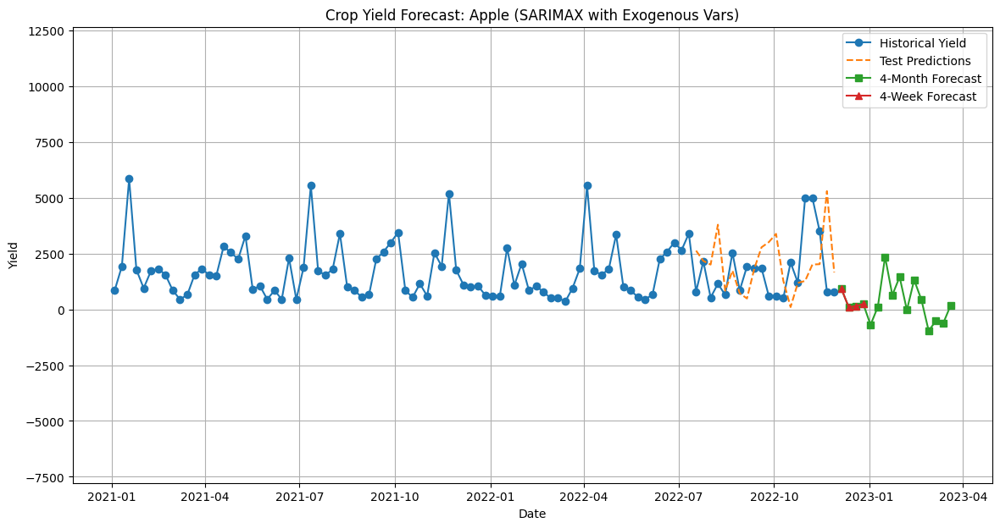


Processing crop: Banana
[Evaluation Metrics]
RMSE: 5234.59 | MAE: 4386.03 | MAPE: 404.59%


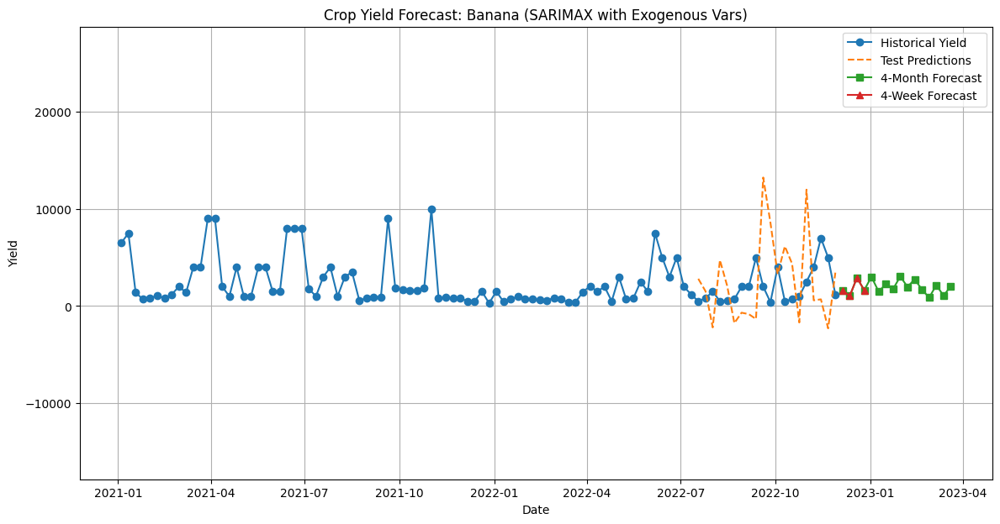


Processing crop: Blackgram
[Evaluation Metrics]
RMSE: 3361.64 | MAE: 2673.45 | MAPE: 32764.72%


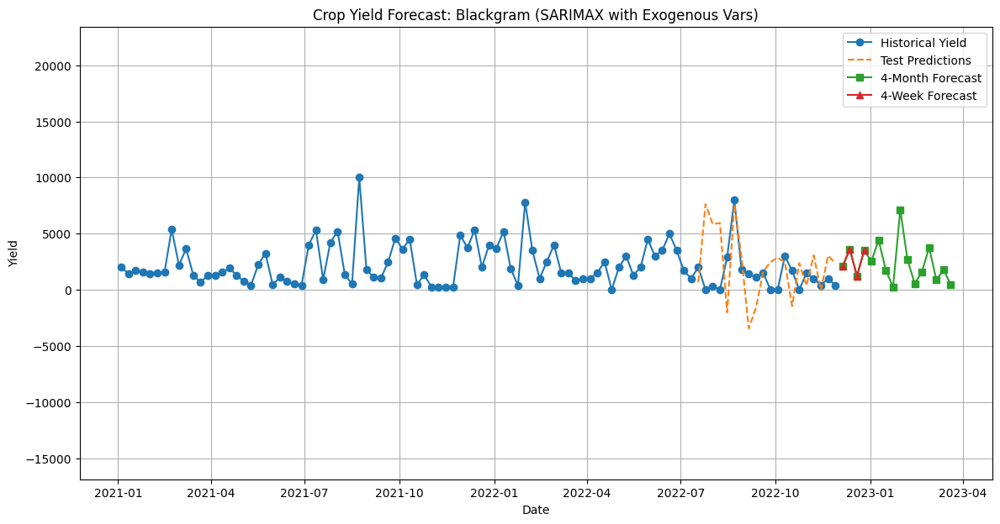


Processing crop: ChickPea
[Evaluation Metrics]
RMSE: 3233.23 | MAE: 2366.24 | MAPE: 69.04%


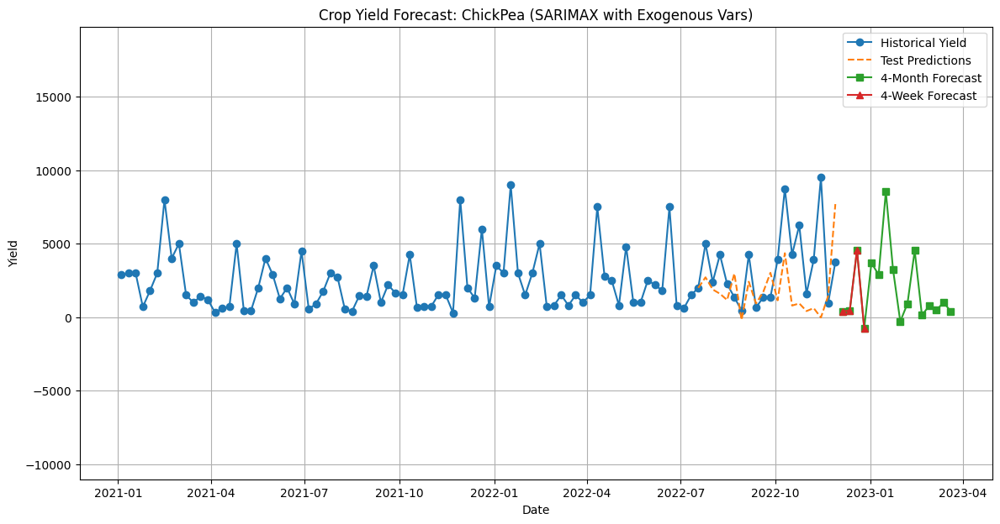


Processing crop: Coconut
[Evaluation Metrics]
RMSE: 6080.16 | MAE: 4859.17 | MAPE: 745.21%


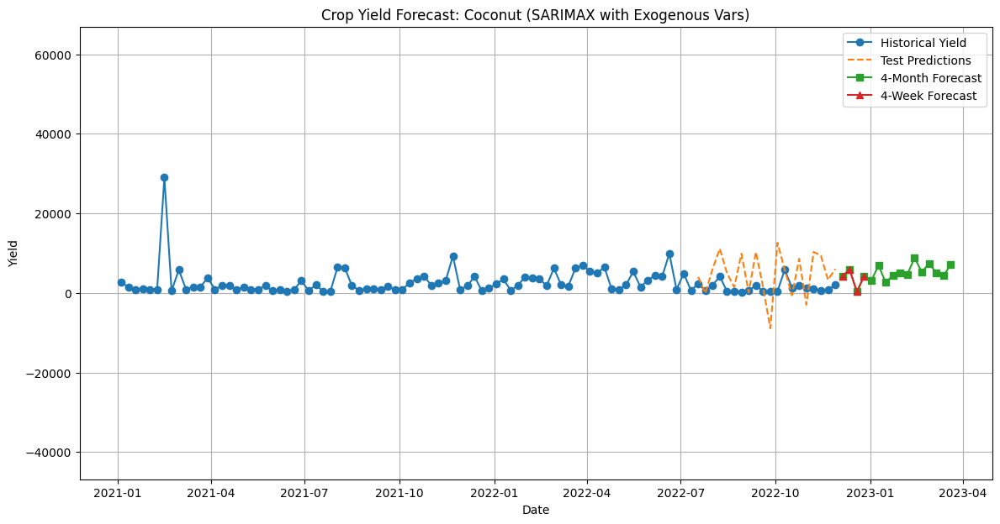


Processing crop: Coffee
[Evaluation Metrics]
RMSE: 4248.03 | MAE: 2955.42 | MAPE: 203.15%


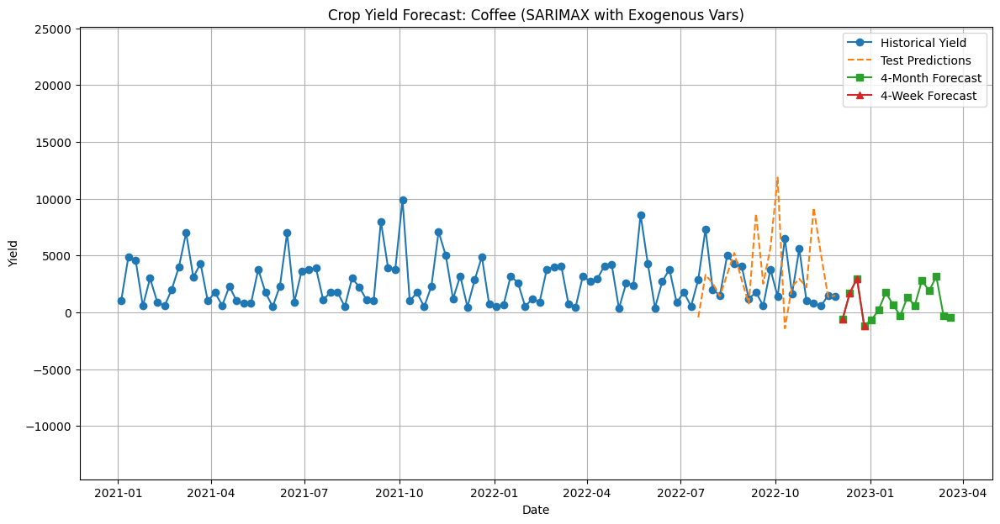


Processing crop: Cotton
[Evaluation Metrics]
RMSE: 2077.96 | MAE: 1567.57 | MAPE: 199.05%


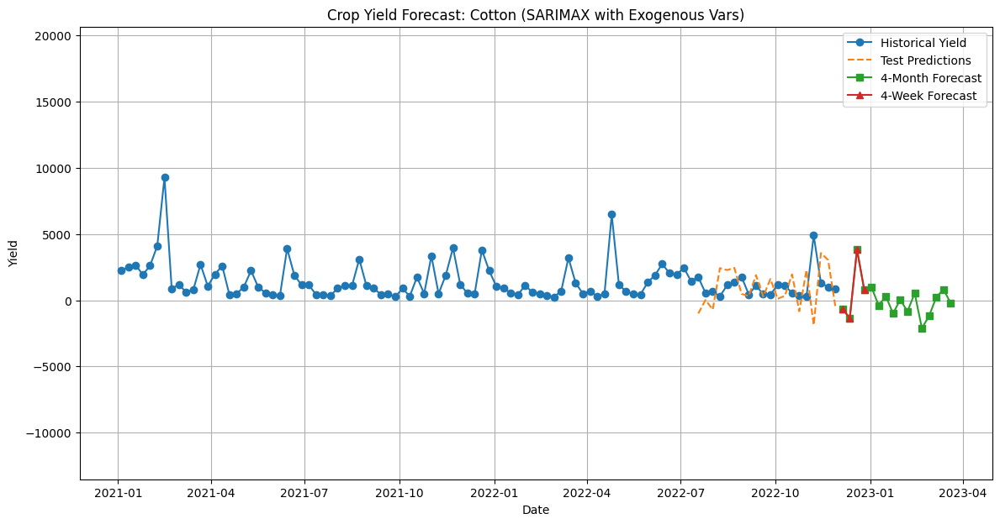


Processing crop: Grapes
[Evaluation Metrics]
RMSE: 3664.50 | MAE: 2899.08 | MAPE: 85.90%


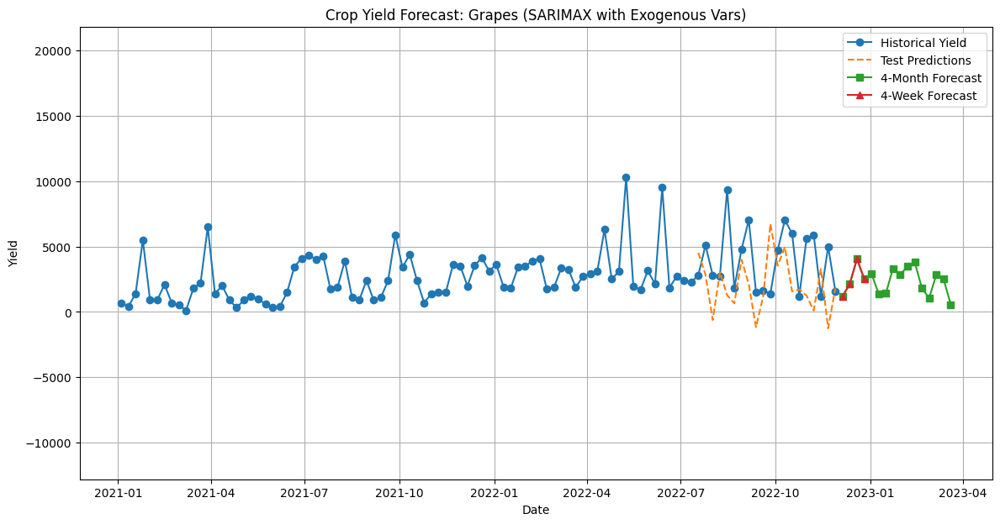


Processing crop: Jute
[Evaluation Metrics]
RMSE: 3606.12 | MAE: 2741.91 | MAPE: 102.45%


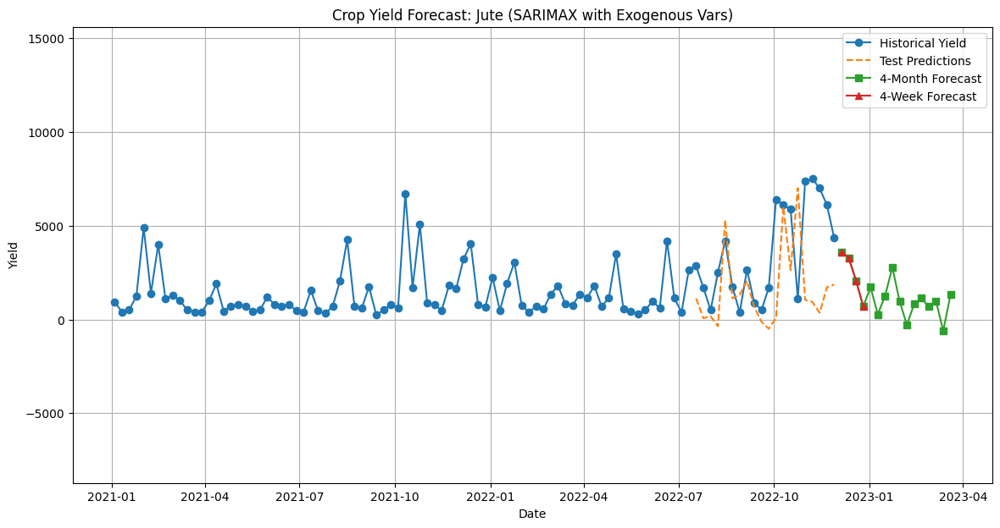


Processing crop: KidneyBeans
[Evaluation Metrics]
RMSE: 4269.98 | MAE: 3084.09 | MAPE: 166.14%


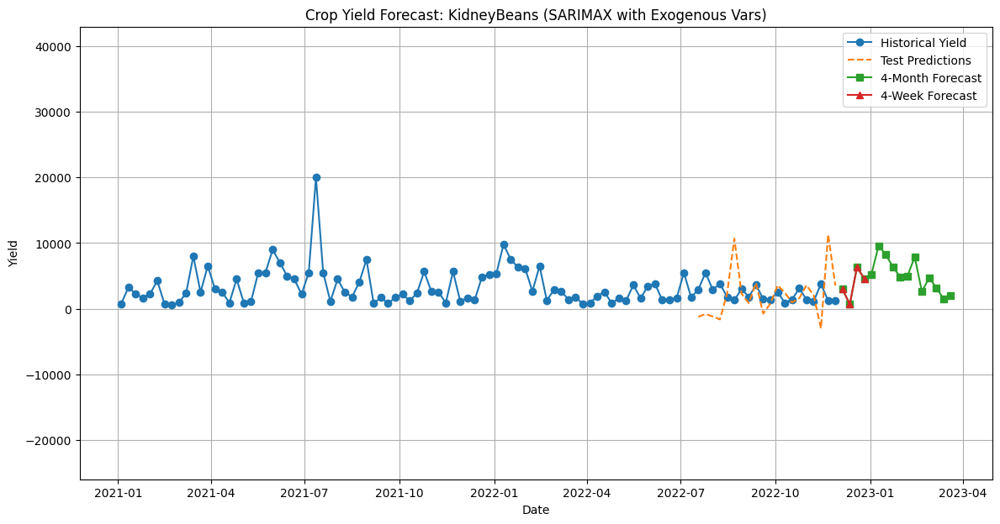


Processing crop: Lentil
[Evaluation Metrics]
RMSE: 3047.29 | MAE: 2308.88 | MAPE: 360.54%


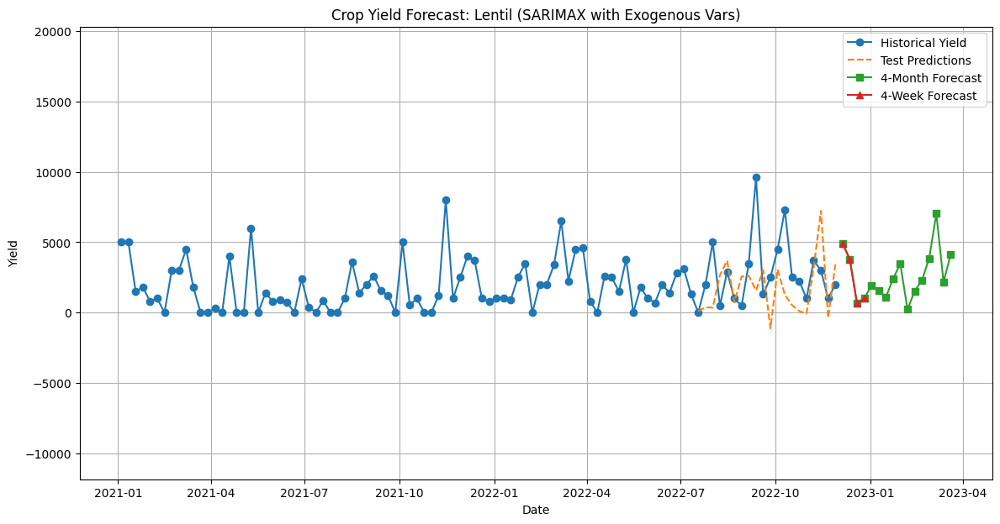


Processing crop: Maize
[Evaluation Metrics]
RMSE: 2550.98 | MAE: 2149.85 | MAPE: 176.65%


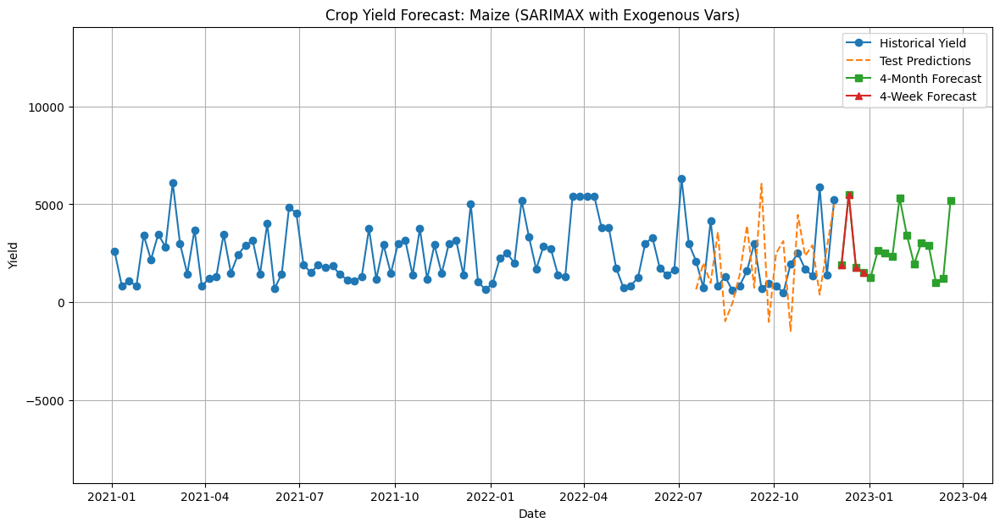


Processing crop: Mango
[Evaluation Metrics]
RMSE: 2455.23 | MAE: 1811.66 | MAPE: 265.56%


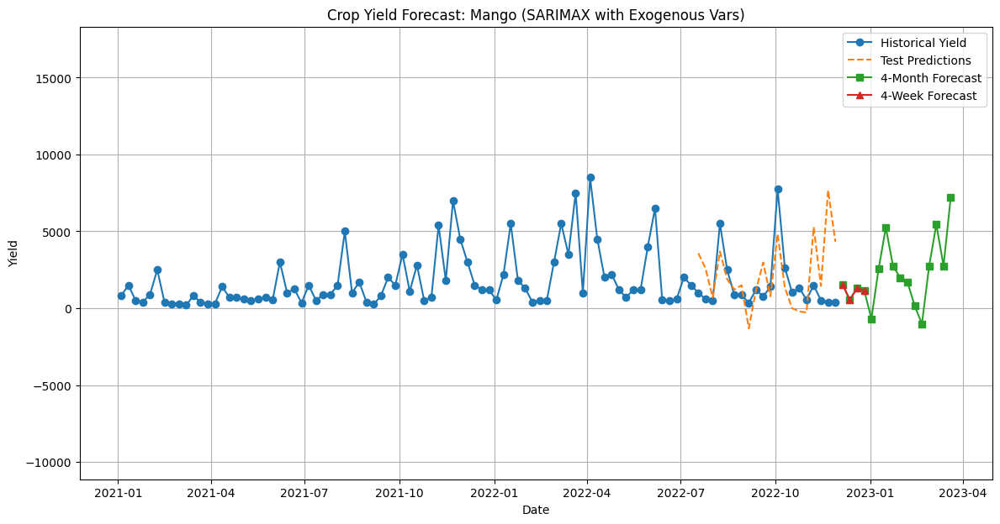


Processing crop: MothBeans
[Evaluation Metrics]
RMSE: 2445.77 | MAE: 1919.73 | MAPE: 86.61%


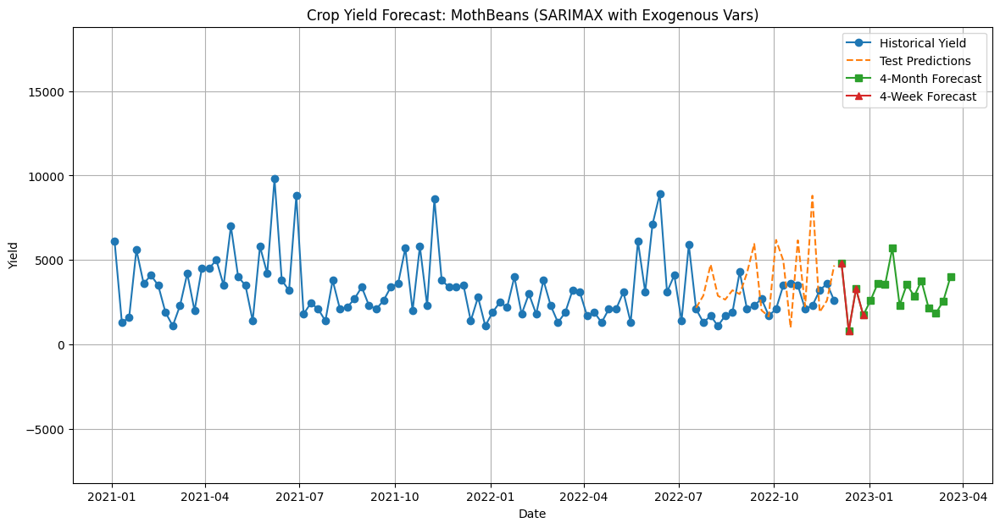


Processing crop: MungBean
[Evaluation Metrics]
RMSE: 2218.25 | MAE: 1812.07 | MAPE: 172.42%


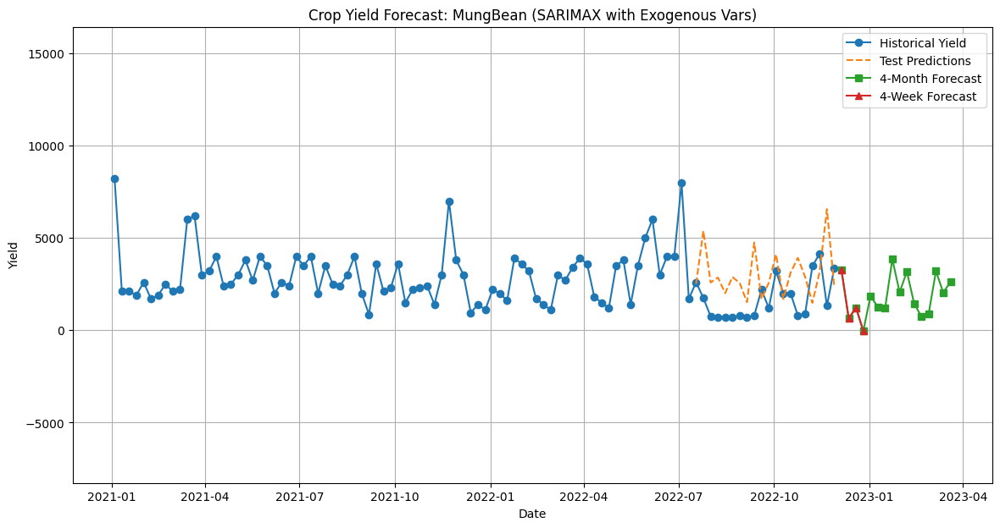


Processing crop: Muskmelon
[Evaluation Metrics]
RMSE: 3722.29 | MAE: 2310.52 | MAPE: 301.59%


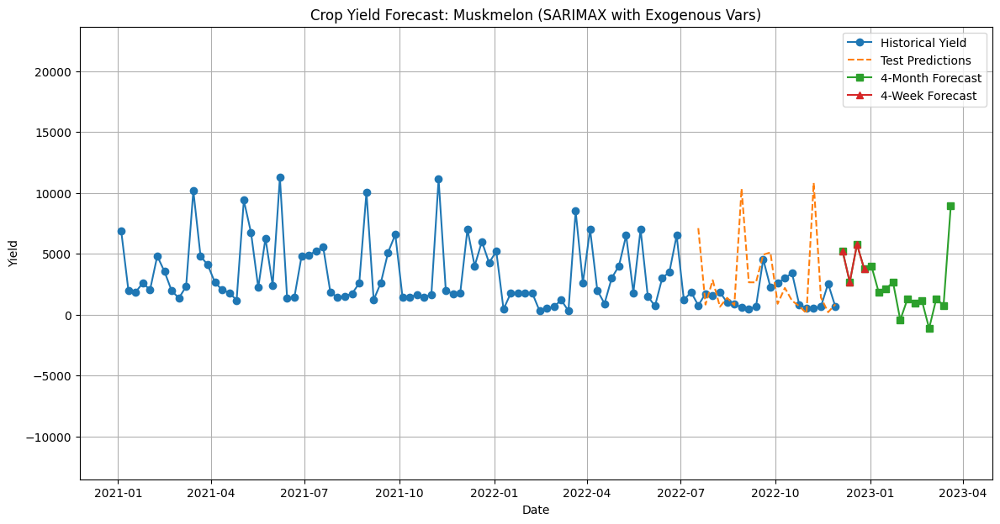


Processing crop: Orange
[Evaluation Metrics]
RMSE: 1583.89 | MAE: 1262.33 | MAPE: 175.25%


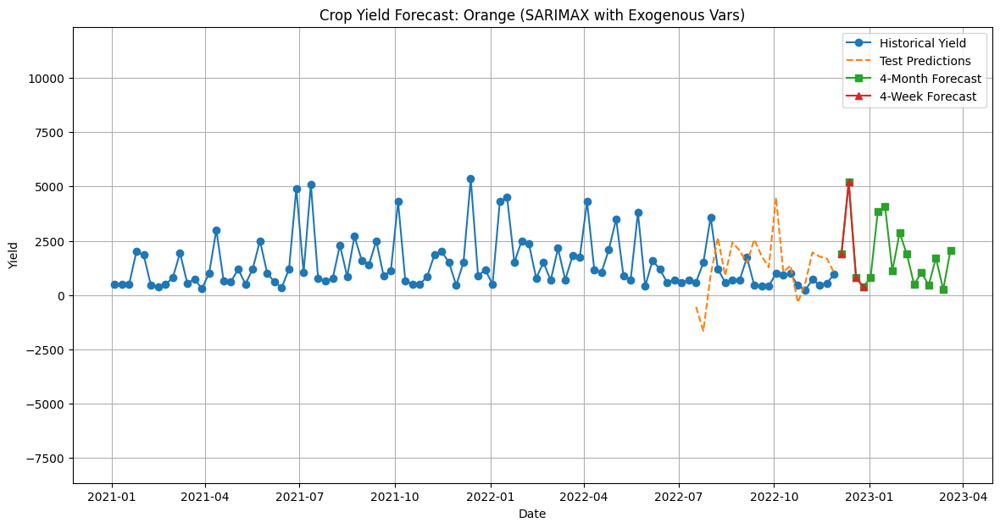


Processing crop: Papaya
[Evaluation Metrics]
RMSE: 3532.95 | MAE: 2572.96 | MAPE: 152.95%


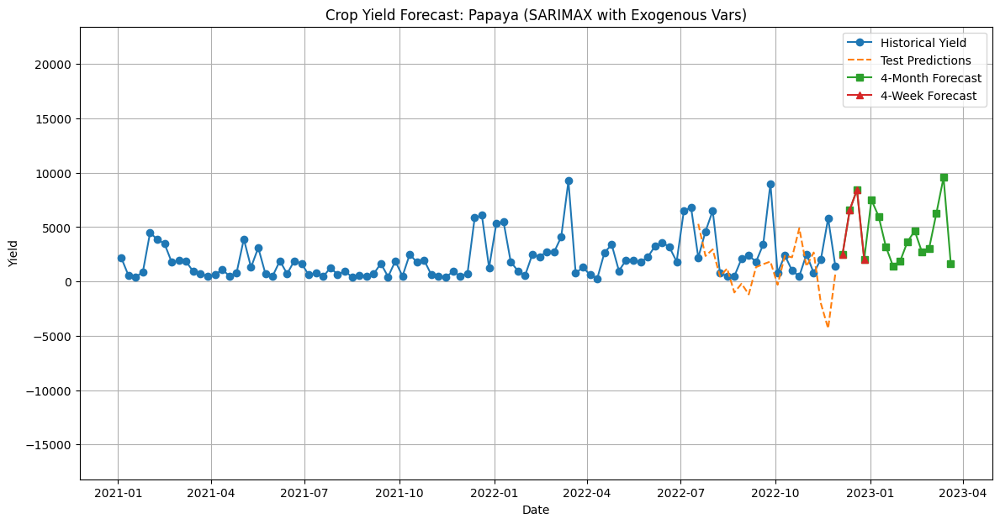


Processing crop: PigeonPeas
[Evaluation Metrics]
RMSE: 11086.50 | MAE: 6815.05 | MAPE: 169.19%


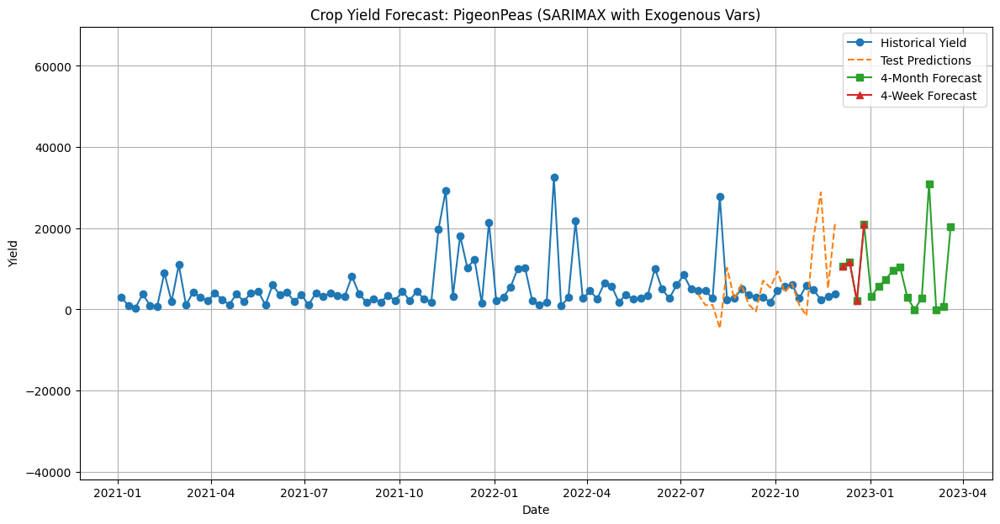


Processing crop: Pomegranate
[Evaluation Metrics]
RMSE: 7390.35 | MAE: 5160.77 | MAPE: 377.70%


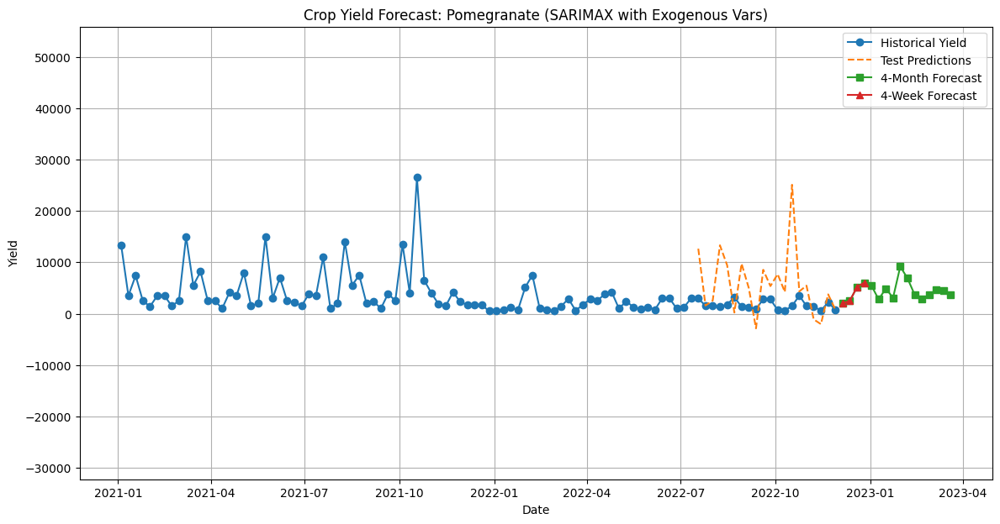


Processing crop: Rice
[Evaluation Metrics]
RMSE: 14675.46 | MAE: 11892.34 | MAPE: 534.75%


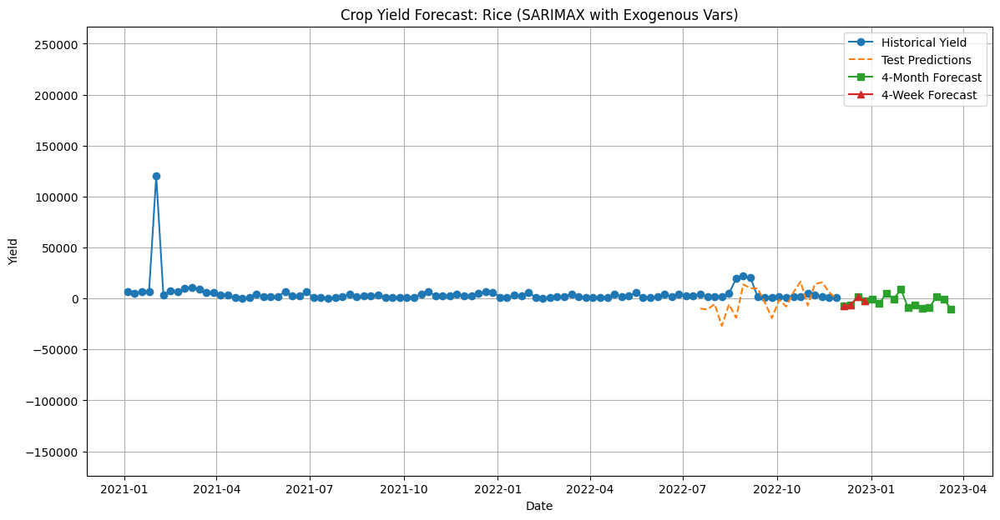


Processing crop: Watermelon
[Evaluation Metrics]
RMSE: 5941.56 | MAE: 4764.97 | MAPE: 144.01%


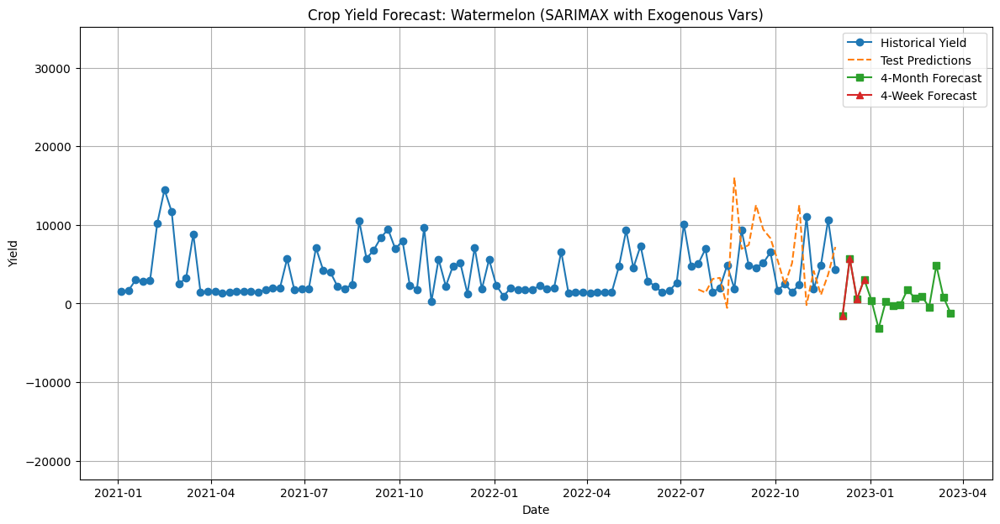



=== Final Results ===

Apple

4-Week Forecast:
                 Yield
2022-12-05  915.973393
2022-12-12   98.205395
2022-12-19  148.092067
2022-12-26  243.151196

4-Month Forecast:
                  Yield
2022-12-05   915.973393
2022-12-12    98.205395
2022-12-19   148.092067
2022-12-26   243.151196
2023-01-02  -691.153568
2023-01-09   107.904316
2023-01-16  2355.550120
2023-01-23   640.127280
2023-01-30  1455.354479
2023-02-06   -29.830913
2023-02-13  1317.596709
2023-02-20   430.526680
2023-02-27  -964.035085
2023-03-06  -506.491891
2023-03-13  -619.423774
2023-03-20   163.139017

Banana

4-Week Forecast:
                  Yield
2022-12-05  1571.588228
2022-12-12  1038.943109
2022-12-19  2931.319688
2022-12-26  1626.566249

4-Month Forecast:
                  Yield
2022-12-05  1571.588228
2022-12-12  1038.943109
2022-12-19  2931.319688
2022-12-26  1626.566249
2023-01-02  3013.647172
2023-01-09  1495.184928
2023-01-16  2249.089660
2023-01-23  1747.381982
2023-01-30  3050.135673
2023

In [7]:
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
import numpy as np
import warnings
warnings.filterwarnings("ignore")

df = pd.read_csv('Crop_Data.csv', parse_dates=['Period'])
df.set_index('Period', inplace=True)

#including all other external factors
#everythinh else same as 1st model

exog_features = ['Nitrogen', 'Phosphorus', 'Potassium', 'Temperature', 'Humidity', 'pH_Value', 'Rainfall']

crop_groups = df.groupby('Crop')
results = {}

for crop, group in crop_groups:
    print(f"\n{'='*40}\nProcessing crop: {crop}\n{'='*40}")
    crop_df = group.copy().sort_index()

    crop_df['Yield'] = crop_df['Yield'].ffill()
    crop_df[exog_features] = crop_df[exog_features].ffill()
#splitting data into 80-20
    train_size = int(len(crop_df) * 0.8)
    train_data, test_data = crop_df.iloc[:train_size], crop_df.iloc[train_size:]
    exog_train, exog_test = train_data[exog_features], test_data[exog_features]


    order = (1, 0, 0)
    seasonal_order = (0, 1, 1, 52)
#trainign with 80% data
    try:
        model = SARIMAX(
            train_data['Yield'],
            exog=exog_train,    #including exogenous features
            order=order,
            seasonal_order=seasonal_order,
            enforce_stationarity=False
        )
        fitted_model = model.fit(disp=False)
#predicting
        test_pred = fitted_model.get_prediction(
            start=test_data.index[0],
            end=test_data.index[-1],
            exog=exog_test,
            dynamic=False
        )
        test_data['Predicted'] = test_pred.predicted_mean

#metrics calculation
        test_rmse = np.sqrt(mean_squared_error(test_data['Yield'], test_data['Predicted']))
        test_mae = mean_absolute_error(test_data['Yield'], test_data['Predicted'])
        test_mape = np.mean(np.abs((test_data['Yield'] - test_data['Predicted']) / test_data['Yield'])) * 100

        print(f"[Evaluation Metrics]\nRMSE: {test_rmse:.2f} | MAE: {test_mae:.2f} | MAPE: {test_mape:.2f}%")
#full modelling fitting for forecasting
        full_model = SARIMAX(
            crop_df['Yield'],
            exog=crop_df[exog_features],
            order=order,
            seasonal_order=seasonal_order,
            enforce_stationarity=False
        )
        full_fit = full_model.fit(disp=False)

        last_exog = crop_df[exog_features].iloc[-1]
        forecast_steps_4w = 4
        forecast_steps_4m = 16

        future_exog_4w = pd.DataFrame(
            [last_exog] * forecast_steps_4w,
            index=pd.date_range(start=crop_df.index[-1] + pd.DateOffset(weeks=1), periods=forecast_steps_4w, freq='W'),
            columns=exog_features
        )

        future_exog_4m = pd.DataFrame(
            [last_exog] * forecast_steps_4m,
            index=pd.date_range(start=crop_df.index[-1] + pd.DateOffset(weeks=1), periods=forecast_steps_4m, freq='W'),
            columns=exog_features
        )

        forecast_4w = full_fit.get_forecast(steps=forecast_steps_4w, exog=future_exog_4w)
        forecast_4m = full_fit.get_forecast(steps=forecast_steps_4m, exog=future_exog_4m)

        results[crop] = {
            'Test_RMSE': test_rmse,
            'Test_MAE': test_mae,
            'Test_MAPE': test_mape,
            '4_Week_Forecast': forecast_4w.predicted_mean,
            '4_Month_Forecast': forecast_4m.predicted_mean
        }

        plt.figure(figsize=(14, 7))
        plt.plot(crop_df['Yield'], label='Historical Yield', marker='o')
        plt.plot(test_data['Predicted'], label='Test Predictions', linestyle='--')

        plt.plot(forecast_4m.predicted_mean, label='4-Month Forecast', marker='s')
        plt.plot(forecast_4w.predicted_mean, label='4-Week Forecast', marker='^')

        plt.title(f"Crop Yield Forecast: {crop} (SARIMAX with Exogenous Vars)")
        plt.xlabel("Date")
        plt.ylabel("Yield")
        plt.legend()
        plt.grid(True)

        all_yield_values = pd.concat([
            crop_df['Yield'],
            test_data['Predicted'],
            results[crop]['4_Week_Forecast'],
            results[crop]['4_Month_Forecast']
        ])

        data_min = all_yield_values.min()
        data_max = all_yield_values.max()
        data_range = data_max - data_min

        padding = data_range * 1

        ymin = data_min - padding
        ymax = data_max + padding

        plt.ylim(ymin, ymax)

        plt.show()

    except Exception as e:
        print(f"Model failed for {crop}: {str(e)}")
        results[crop] = {
            'Test_RMSE': None,
            'Test_MAE': None,
            'Test_MAPE': None,
            '4_Week_Forecast': None,
            '4_Month_Forecast': None
        }


print("\n\n=== Final Results ===")
for crop, res in results.items():
    print(f"\n{'='*30}\n{crop}\n{'='*30}")
    print("\n4-Week Forecast:")
    print(res['4_Week_Forecast'].to_frame(name='Yield') if res['4_Week_Forecast'] is not None else "No forecast")

    print("\n4-Month Forecast:")
    print(res['4_Month_Forecast'].to_frame(name='Yield') if res['4_Month_Forecast'] is not None else "No forecast")

In [8]:
for crop, res in results.items():
    print(f"\n{'='*30}\n{crop}\n{'='*30}")
    print(f"Metrics -> RMSE: {res['Test_RMSE']:.2f}, MAE: {res['Test_MAE']:.2f}, MAPE: {res['Test_MAPE']:.2f}%")


Apple
Metrics -> RMSE: 2003.98, MAE: 1551.86, MAPE: 145.34%

Banana
Metrics -> RMSE: 5234.59, MAE: 4386.03, MAPE: 404.59%

Blackgram
Metrics -> RMSE: 3361.64, MAE: 2673.45, MAPE: 32764.72%

ChickPea
Metrics -> RMSE: 3233.23, MAE: 2366.24, MAPE: 69.04%

Coconut
Metrics -> RMSE: 6080.16, MAE: 4859.17, MAPE: 745.21%

Coffee
Metrics -> RMSE: 4248.03, MAE: 2955.42, MAPE: 203.15%

Cotton
Metrics -> RMSE: 2077.96, MAE: 1567.57, MAPE: 199.05%

Grapes
Metrics -> RMSE: 3664.50, MAE: 2899.08, MAPE: 85.90%

Jute
Metrics -> RMSE: 3606.12, MAE: 2741.91, MAPE: 102.45%

KidneyBeans
Metrics -> RMSE: 4269.98, MAE: 3084.09, MAPE: 166.14%

Lentil
Metrics -> RMSE: 3047.29, MAE: 2308.88, MAPE: 360.54%

Maize
Metrics -> RMSE: 2550.98, MAE: 2149.85, MAPE: 176.65%

Mango
Metrics -> RMSE: 2455.23, MAE: 1811.66, MAPE: 265.56%

MothBeans
Metrics -> RMSE: 2445.77, MAE: 1919.73, MAPE: 86.61%

MungBean
Metrics -> RMSE: 2218.25, MAE: 1812.07, MAPE: 172.42%

Muskmelon
Metrics -> RMSE: 3722.29, MAE: 2310.52, MAPE: 301

# XGBoost

## 3rd model: xgboost without exo factors


Processing crop: Apple
Best parameters for Apple: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 598.49 | MAE: 433.45 | MAPE: 26.62%


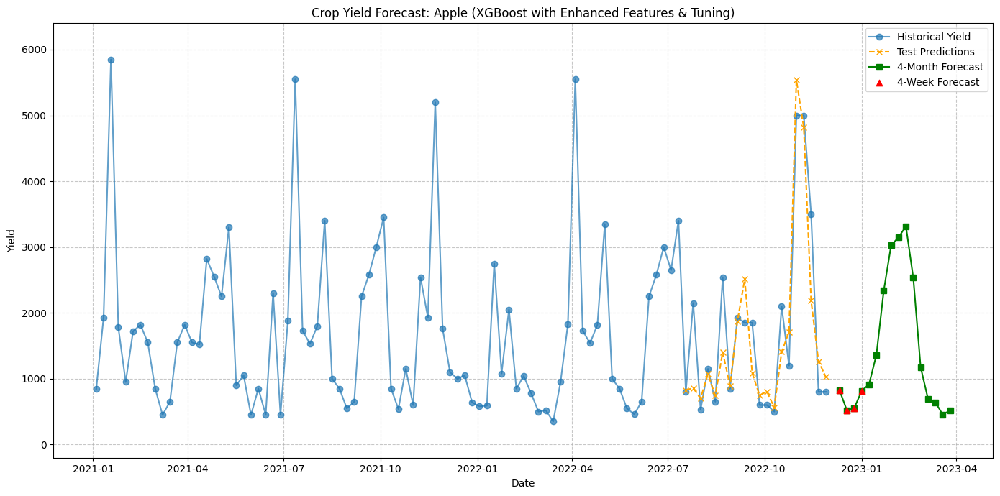


Processing crop: Banana
Best parameters for Banana: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 756.51 | MAE: 596.96 | MAPE: 45.08%


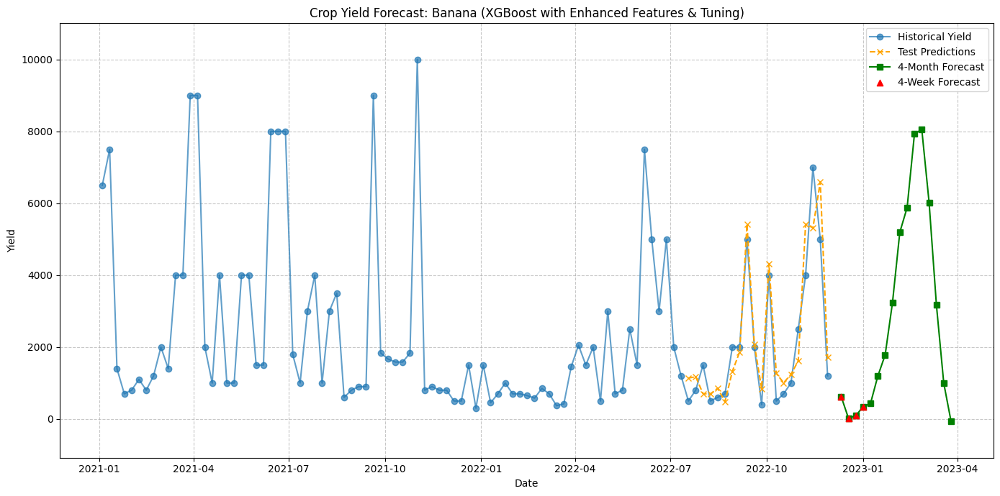


Processing crop: Blackgram
Best parameters for Blackgram: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 740.24 | MAE: 478.45 | MAPE: 3639.49%


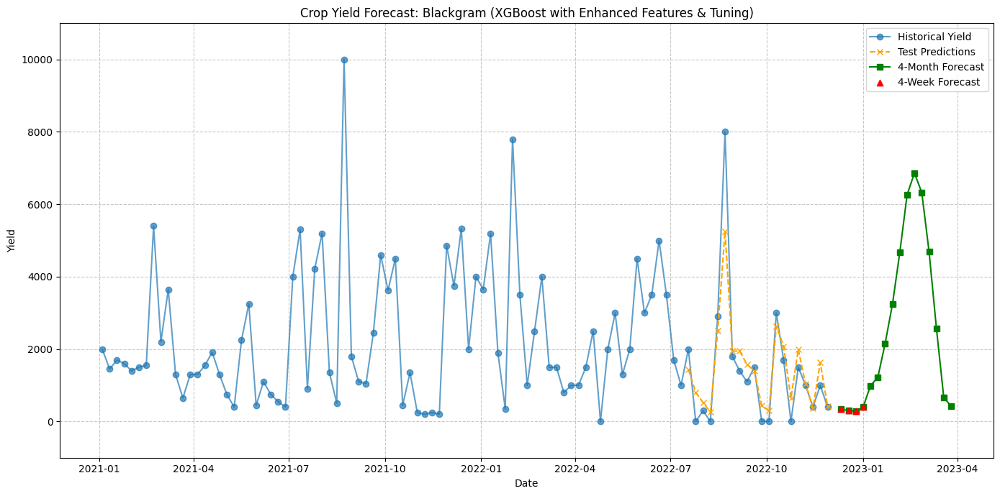


Processing crop: ChickPea
Best parameters for ChickPea: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 50}
[Evaluation Metrics] RMSE: 1533.07 | MAE: 1093.94 | MAPE: 30.71%


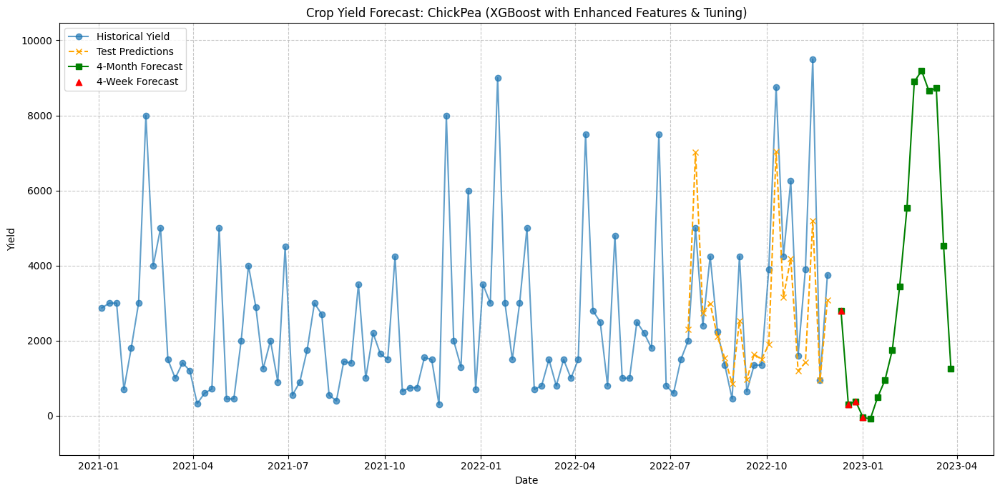


Processing crop: Coconut
Best parameters for Coconut: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 50}
[Evaluation Metrics] RMSE: 1457.93 | MAE: 1307.63 | MAPE: 220.18%


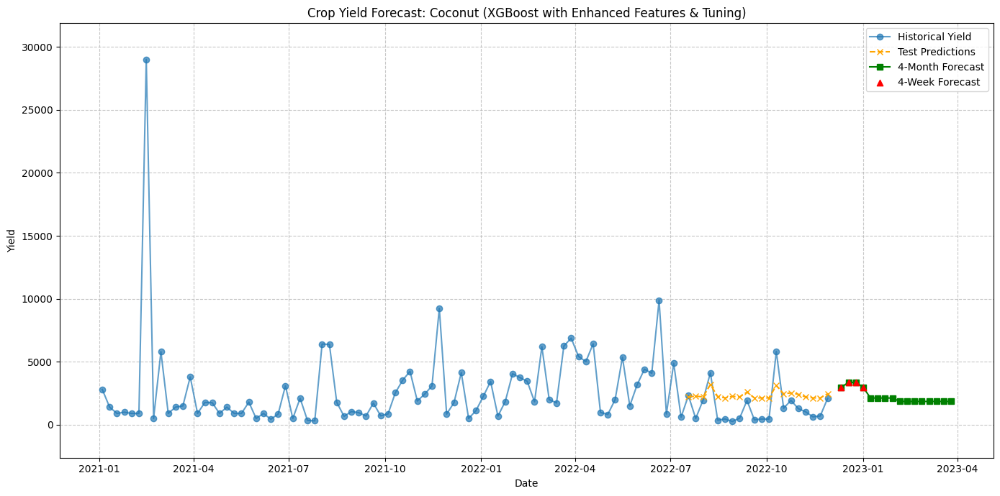


Processing crop: Coffee
Best parameters for Coffee: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100}
[Evaluation Metrics] RMSE: 791.42 | MAE: 605.48 | MAPE: 26.53%


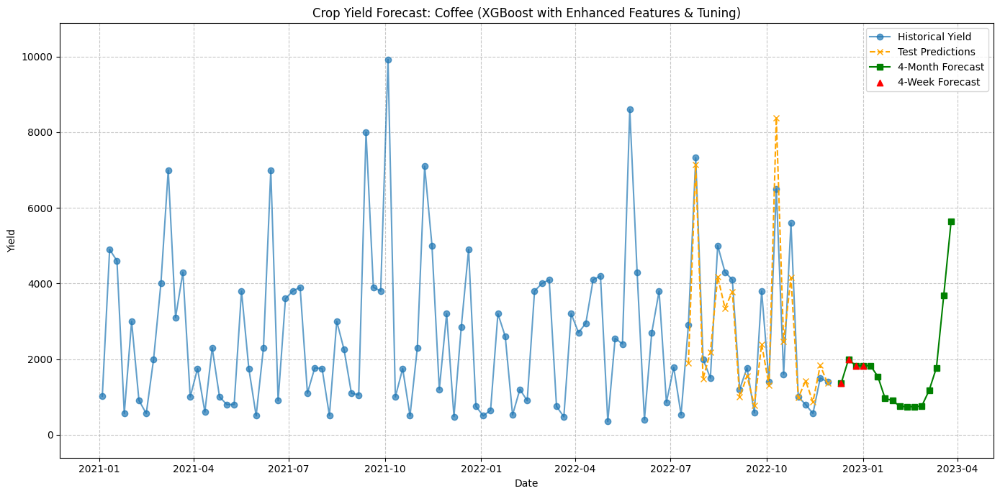


Processing crop: Cotton
Best parameters for Cotton: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 100}
[Evaluation Metrics] RMSE: 261.64 | MAE: 182.88 | MAPE: 21.07%


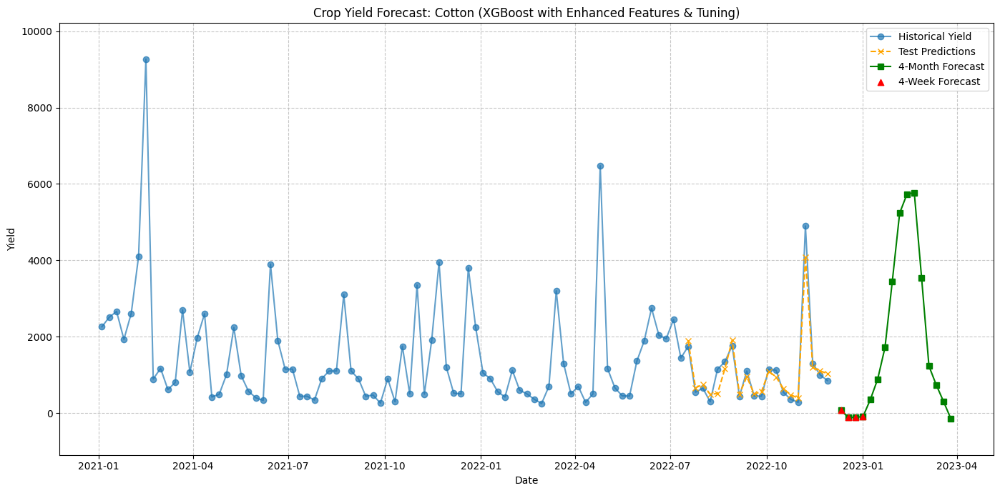


Processing crop: Grapes
Best parameters for Grapes: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 1436.35 | MAE: 919.33 | MAPE: 23.23%


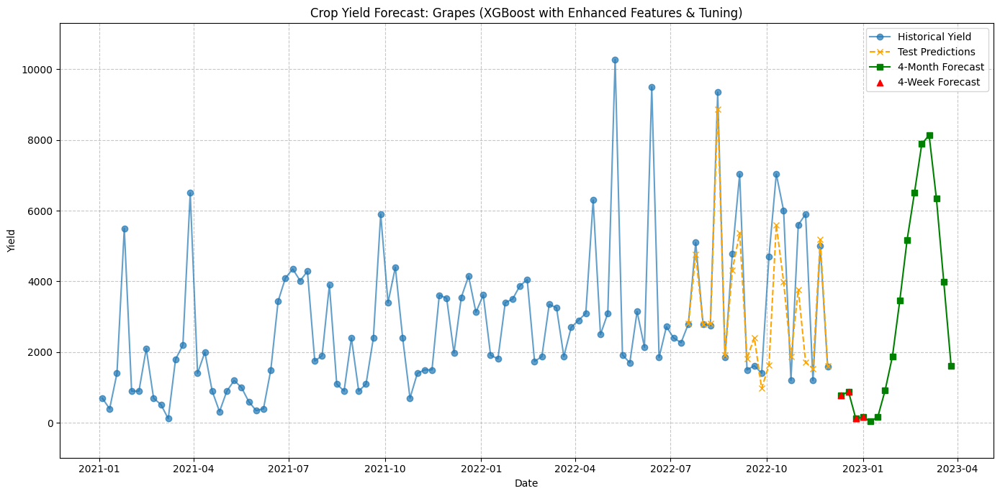


Processing crop: Jute
Best parameters for Jute: {'learning_rate': 0.2, 'max_depth': 7, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 2612.78 | MAE: 1774.62 | MAPE: 42.11%


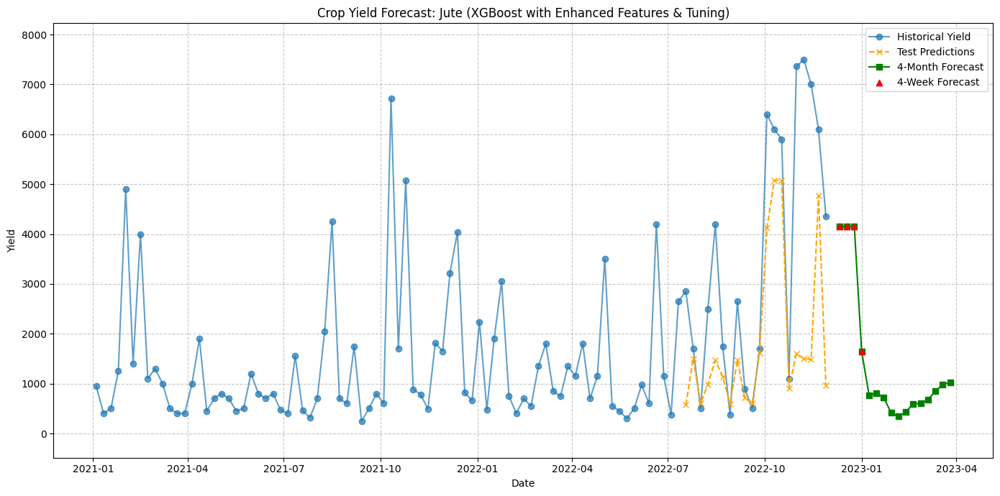


Processing crop: KidneyBeans
Best parameters for KidneyBeans: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 448.79 | MAE: 353.79 | MAPE: 16.60%


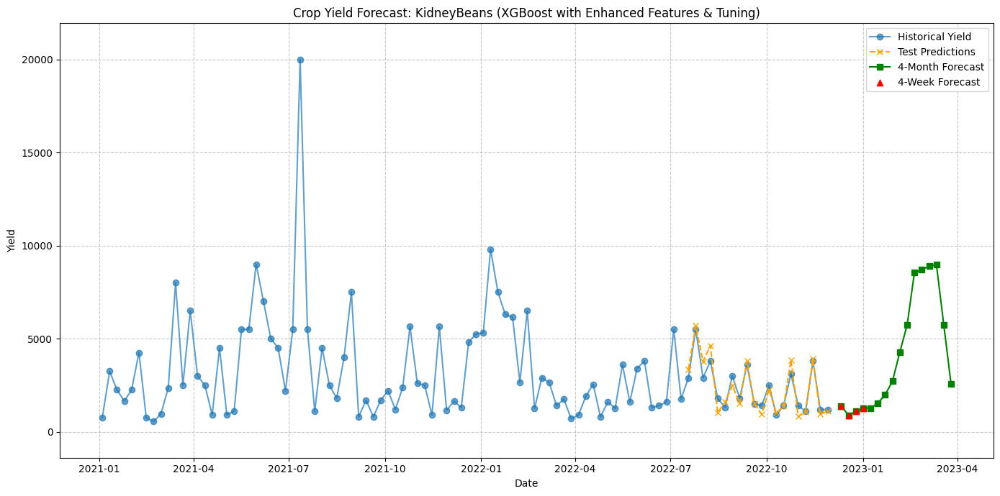


Processing crop: Lentil
Best parameters for Lentil: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 100}
[Evaluation Metrics] RMSE: 1213.62 | MAE: 843.42 | MAPE: 559.19%


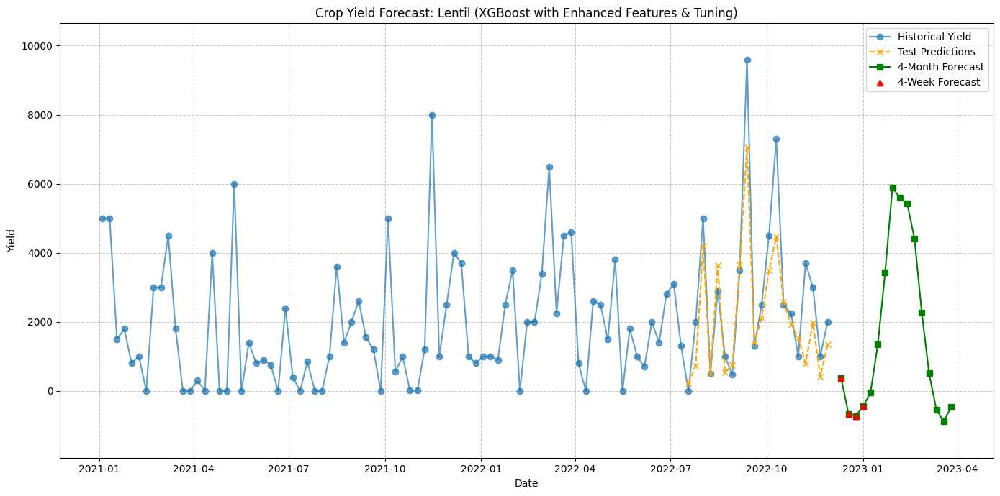


Processing crop: Maize
Best parameters for Maize: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 670.07 | MAE: 463.39 | MAPE: 40.55%


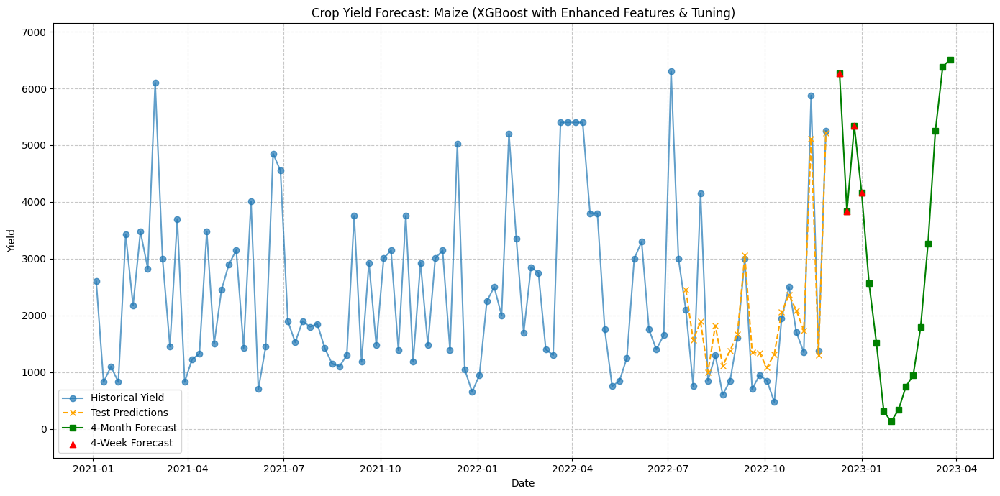


Processing crop: Mango
Best parameters for Mango: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 616.00 | MAE: 409.89 | MAPE: 40.19%


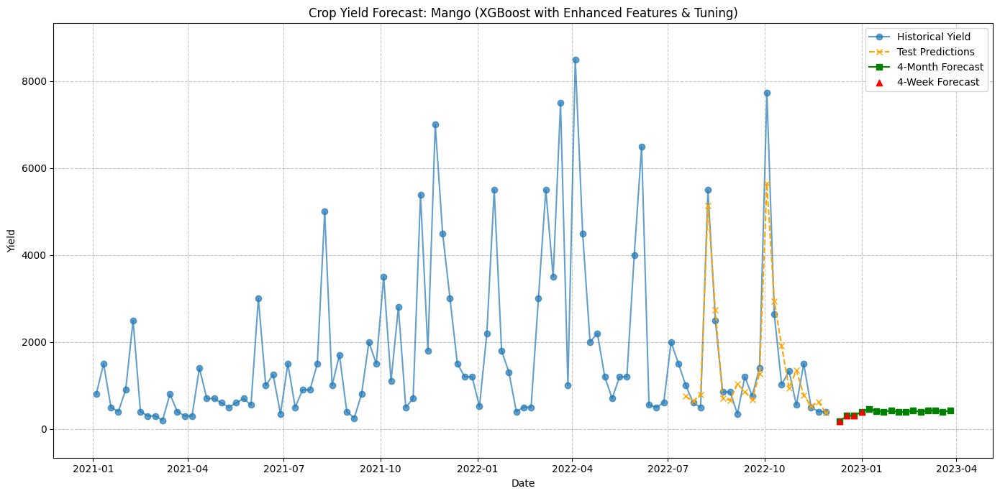


Processing crop: MothBeans
Best parameters for MothBeans: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 667.52 | MAE: 502.85 | MAPE: 28.37%


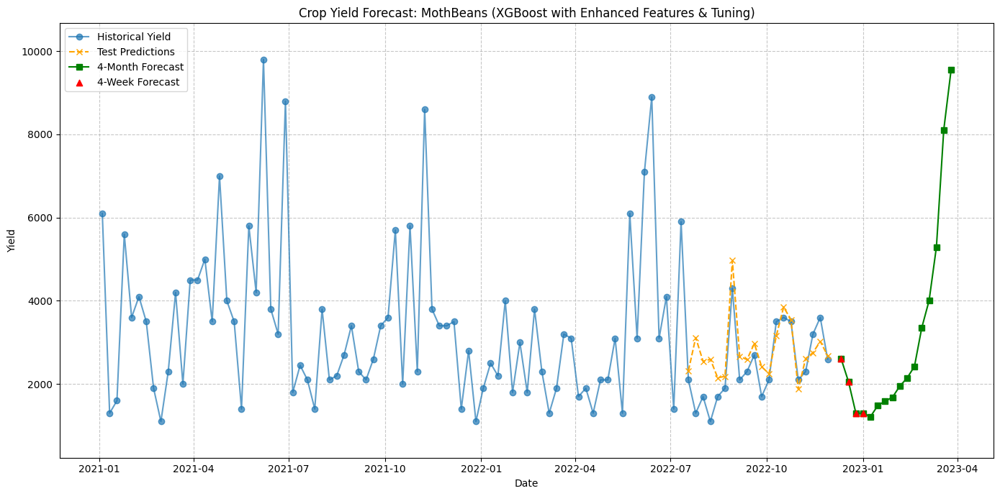


Processing crop: MungBean
Best parameters for MungBean: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 794.69 | MAE: 710.63 | MAPE: 69.15%


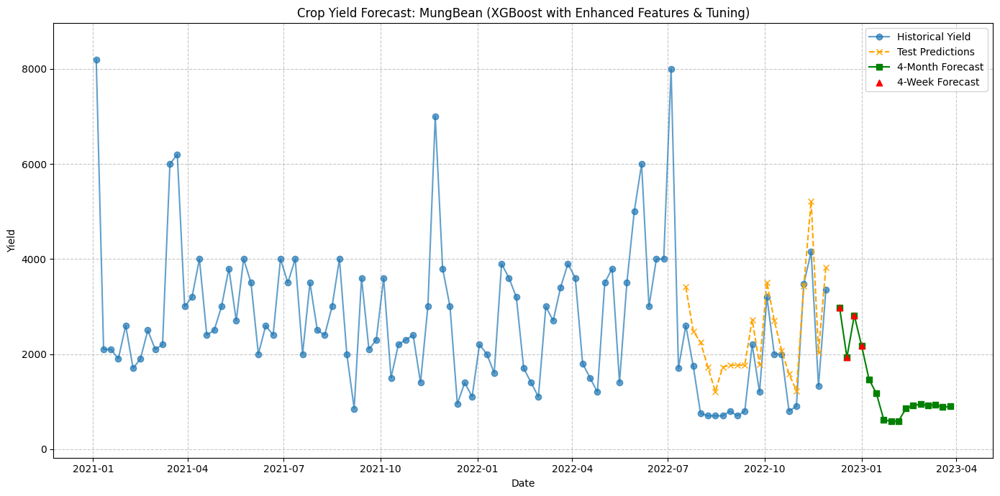


Processing crop: Muskmelon
Best parameters for Muskmelon: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 672.48 | MAE: 457.32 | MAPE: 47.94%


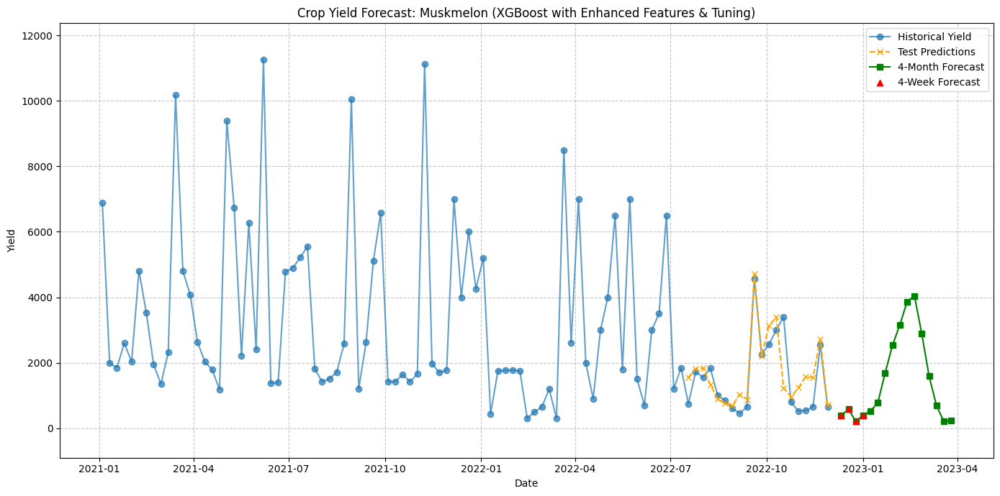


Processing crop: Orange
Best parameters for Orange: {'learning_rate': 0.2, 'max_depth': 5, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 269.66 | MAE: 192.73 | MAPE: 28.82%


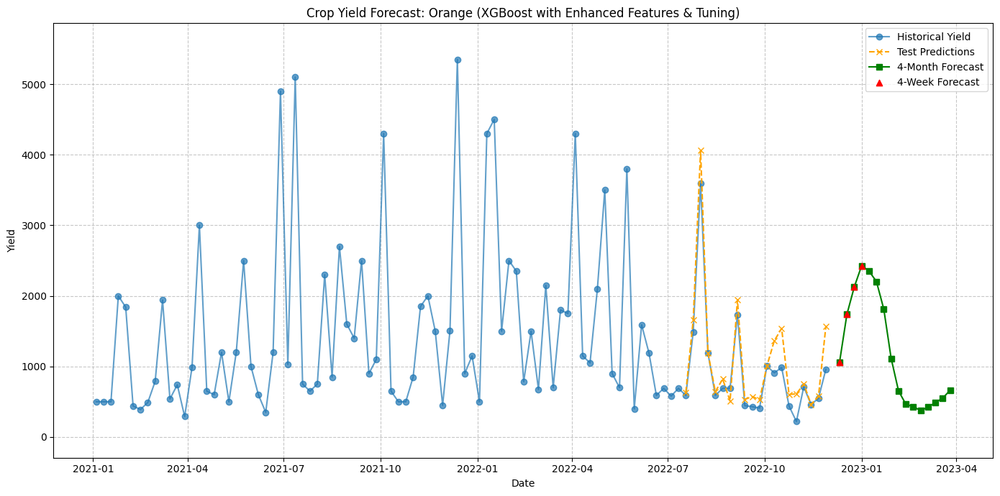


Processing crop: Papaya
Best parameters for Papaya: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 745.40 | MAE: 547.96 | MAPE: 44.28%


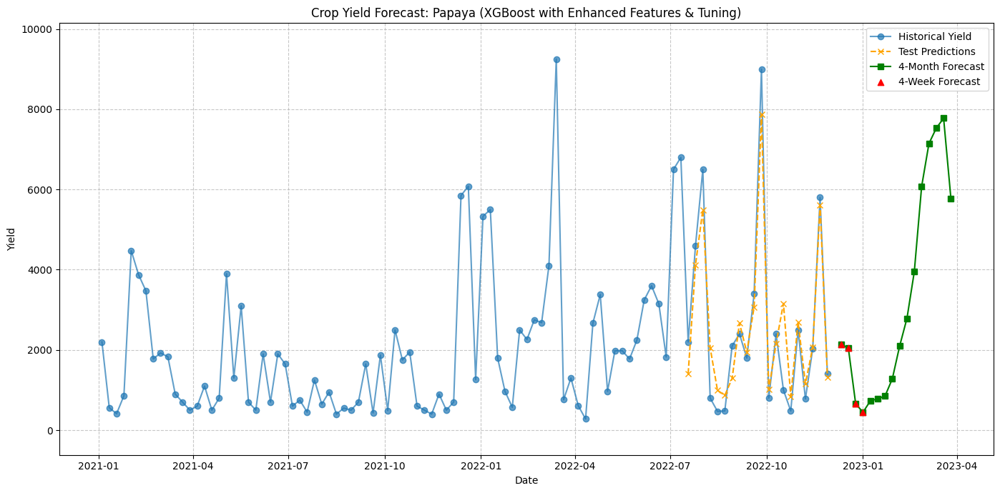


Processing crop: PigeonPeas
Best parameters for PigeonPeas: {'learning_rate': 0.2, 'max_depth': 5, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 1683.22 | MAE: 812.47 | MAPE: 16.09%


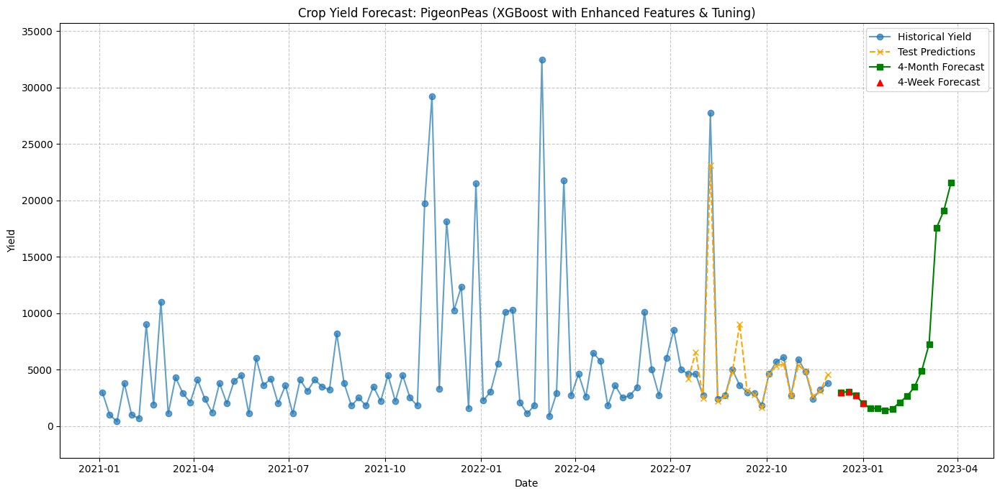


Processing crop: Pomegranate
Best parameters for Pomegranate: {'learning_rate': 0.2, 'max_depth': 5, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 415.05 | MAE: 343.57 | MAPE: 27.05%


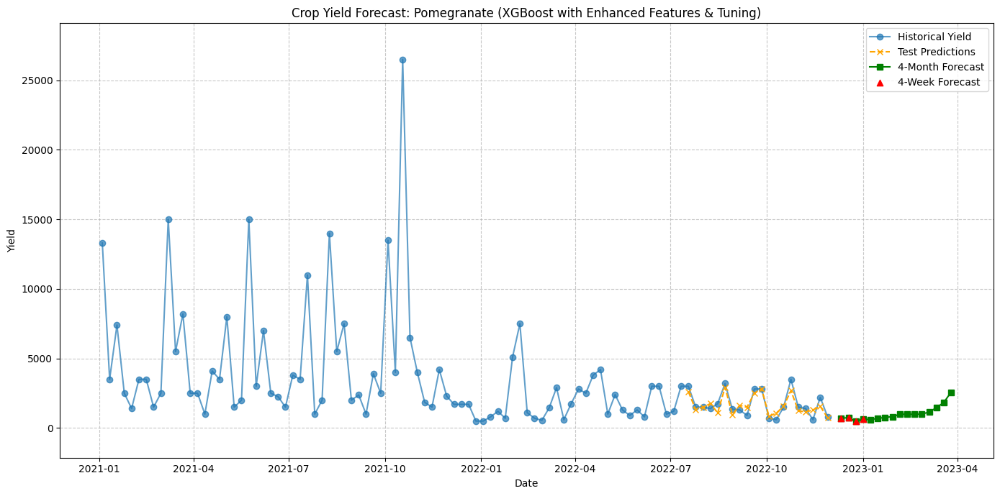


Processing crop: Rice
Best parameters for Rice: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 50}
[Evaluation Metrics] RMSE: 6394.38 | MAE: 4068.44 | MAPE: 140.77%


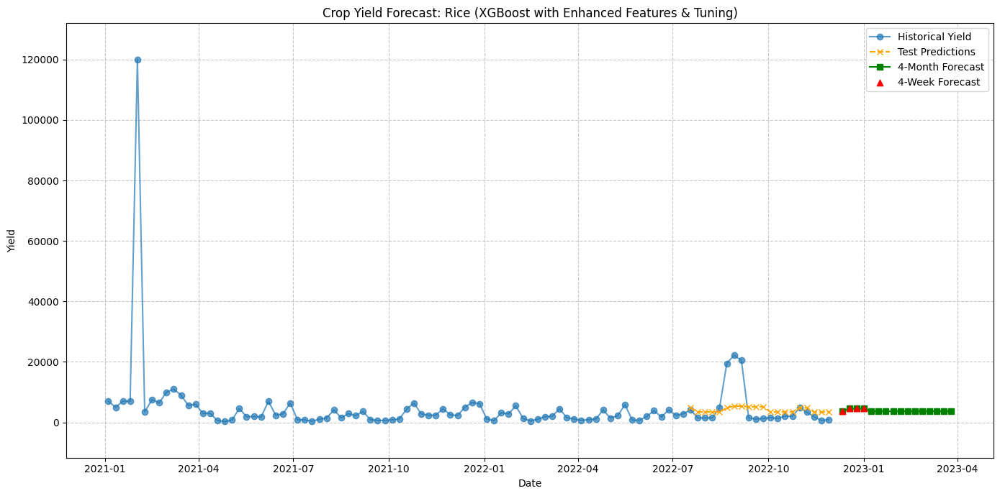


Processing crop: Watermelon
Best parameters for Watermelon: {'learning_rate': 0.01, 'max_depth': 5, 'n_estimators': 100}
[Evaluation Metrics] RMSE: 1659.49 | MAE: 1276.13 | MAPE: 31.50%


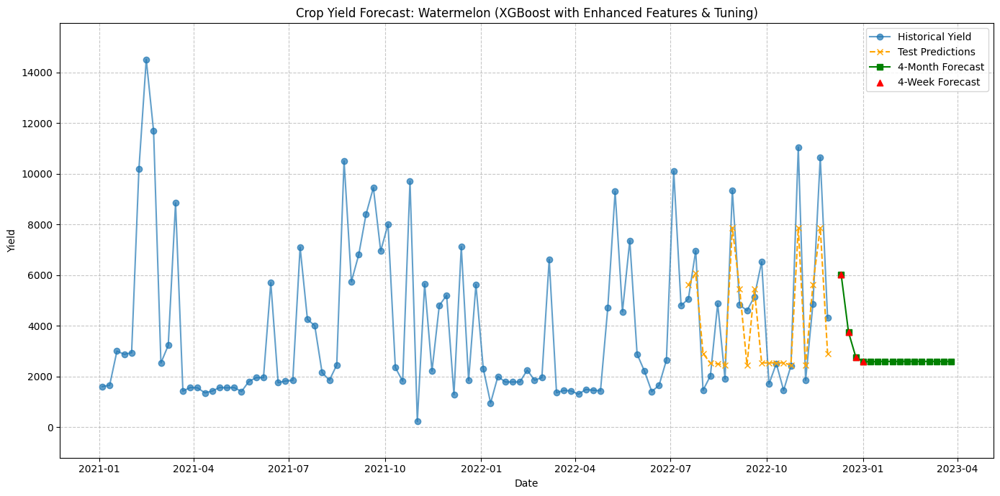



 Final Results Summary:

Apple

4-Week Forecast:
                 Yield
2022-12-11  823.017822
2022-12-18  518.653809
2022-12-25  555.800903
2023-01-01  815.246704

4-Month Forecast:
                  Yield
2022-12-11   823.017822
2022-12-18   518.653809
2022-12-25   555.800903
2023-01-01   815.246704
2023-01-08   915.879883
2023-01-15  1362.258057
2023-01-22  2340.631592
2023-01-29  3029.454590
2023-02-05  3146.142578
2023-02-12  3316.847656
2023-02-19  2537.454590
2023-02-26  1176.740112
2023-03-05   694.651672
2023-03-12   642.389771
2023-03-19   454.527191
2023-03-26   520.399414

Banana

4-Week Forecast:
                 Yield
2022-12-11  622.794434
2022-12-18   15.488794
2022-12-25   91.951538
2023-01-01  343.383179

4-Month Forecast:
                  Yield
2022-12-11   622.794434
2022-12-18    15.488794
2022-12-25    91.951538
2023-01-01   343.383179
2023-01-08   429.974060
2023-01-15  1191.882690
2023-01-22  1780.356445
2023-01-29  3232.403564
2023-02-05  5191.822754
2023-02

In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
import warnings
warnings.filterwarnings("ignore")

def create_features(series, n_lags=4):

    df = pd.DataFrame(series)
    #xgboost need lag fucntion to perfrom as forecating models
    for lag in range(1, n_lags + 1):
        df[f'lag_{lag}'] = df['Yield'].shift(lag)
    #rolling mean and rolling std futher help in forecasting usimng xgboost
    df[f'rolling_mean_{n_lags}'] = df['Yield'].rolling(window=n_lags).mean().shift(1)
    df[f'rolling_std_{n_lags}']  = df['Yield'].rolling(window=n_lags).std().shift(1)
    #lagg diff futher help in forecasting usimng xgboost
    df['lag_diff'] = df['Yield'] - df['Yield'].shift(n_lags)

    df = df.dropna()
    return df

#this function recursively predicts future values by feeding each new prediction back as input.
def iterative_forecast(model, last_obs, steps, n_lags=4, extra_features_func=None):
    preds = []
    current_obs = list(last_obs)
    for _ in range(steps):
        X_pred = np.array(current_obs[-n_lags:]).reshape(1, -1)
        features = []
        if extra_features_func is not None:
            features = extra_features_func(current_obs[-n_lags:])
            features = np.array(features).reshape(1, -1)

            X_pred = np.concatenate([X_pred, features], axis=1)
        pred = model.predict(X_pred)[0]
        preds.append(pred)
        current_obs.append(pred)
    return preds

#this function calculates the mean, standard deviation, and range of a given window.
def compute_extra_features(window):
    window = np.array(window)
    roll_mean = window.mean()
    roll_std = window.std()
    diff = window[-1] - window[0]
    return [roll_mean, roll_std, diff]

df = pd.read_csv('Crop_Data.csv', parse_dates=['Period'])
df['Period'] = pd.to_datetime(df['Period'])
df.set_index('Period', inplace=True)

crop_groups = df.groupby('Crop')
results = {}
n_lags = 4

for crop, group in crop_groups:
    print(f"\n{'='*40}\nProcessing crop: {crop}\n{'='*40}")

    crop_df = group.copy().sort_index()
    crop_df['Yield'] = crop_df['Yield'].ffill().bfill()
    sup_df = create_features(crop_df['Yield'], n_lags=n_lags)
 #splititngh to get metreics evaluations
    split_idx = int(len(sup_df) * 0.8)
    train_df = sup_df.iloc[:split_idx]
    test_df = sup_df.iloc[split_idx:]

    X_train = train_df.drop('Yield', axis=1)
    y_train = train_df['Yield']
    X_test = test_df.drop('Yield', axis=1)
    y_test = test_df['Yield']


    tscv = TimeSeriesSplit(n_splits=3)
    param_grid = {
        'n_estimators': [50, 100, 200],
        'max_depth': [3, 5, 7],
        'learning_rate': [0.01, 0.1, 0.2]
    }
    #hyper parameter tunning
    xgb_model = XGBRegressor(objective='reg:squarederror', random_state=42)
    grid_search = GridSearchCV(estimator=xgb_model,
                               param_grid=param_grid,
                               cv=tscv,
                               scoring='neg_mean_squared_error',
                               verbose=0)
    grid_search.fit(X_train, y_train)
    best_params = grid_search.best_params_
    print(f"Best parameters for {crop}: {best_params}")

    model = XGBRegressor(objective='reg:squarederror', random_state=42, **best_params)
    model.fit(X_train, y_train)

    test_pred = model.predict(X_test)

    test_rmse = np.sqrt(mean_squared_error(y_test, test_pred))
    test_mae = mean_absolute_error(y_test, test_pred)
    epsilon = 1e-10
    test_mape = np.mean(np.abs((y_test - test_pred) / (y_test + epsilon))) * 100

    print(f"[Evaluation Metrics] RMSE: {test_rmse:.2f} | MAE: {test_mae:.2f} | MAPE: {test_mape:.2f}%")

#full model traing for forecasting
    full_X = sup_df.drop('Yield', axis=1)
    full_y = sup_df['Yield']
    full_model = XGBRegressor(objective='reg:squarederror', random_state=42, **best_params)
    full_model.fit(full_X, full_y)


    last_obs = list(crop_df['Yield'].iloc[-n_lags:])

#forecasting
    forecast_4w_vals = iterative_forecast(full_model, last_obs, steps=4, n_lags=n_lags,
                                          extra_features_func=compute_extra_features)
    forecast_4m_vals = iterative_forecast(full_model, last_obs, steps=16, n_lags=n_lags,
                                          extra_features_func=compute_extra_features)

    last_date = crop_df.index[-1]
    forecast_4w_dates = pd.date_range(start=last_date + pd.DateOffset(weeks=1), periods=4, freq='W')
    forecast_4m_dates = pd.date_range(start=last_date + pd.DateOffset(weeks=1), periods=16, freq='W')

    results[crop] = {
        'Test_RMSE': test_rmse,
        'Test_MAE': test_mae,
        'Test_MAPE': test_mape,
        'Forecast_4_weeks': pd.Series(forecast_4w_vals, index=forecast_4w_dates),
        'Forecast_4_months': pd.Series(forecast_4m_vals, index=forecast_4m_dates)
    }

    plt.figure(figsize=(14, 7))
    plt.plot(crop_df.index, crop_df['Yield'], label='Historical Yield', marker='o', alpha=0.7)

    test_dates = test_df.index
    plt.plot(test_dates, test_pred, label='Test Predictions', linestyle='--', marker='x', color='orange')

    plt.plot(results[crop]['Forecast_4_months'].index, results[crop]['Forecast_4_months'].values,
             label='4-Month Forecast', marker='s', color='green')
    plt.scatter(results[crop]['Forecast_4_weeks'].index, results[crop]['Forecast_4_weeks'].values,
                label='4-Week Forecast', marker='^', color='red', zorder=5)

    plt.title(f"Crop Yield Forecast: {crop} (XGBoost with Enhanced Features & Tuning)")
    plt.xlabel("Date")
    plt.ylabel("Yield")
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()

    all_vals = pd.concat([
        crop_df['Yield'],
        pd.Series(test_pred, index=test_dates),
        results[crop]['Forecast_4_weeks'],
        results[crop]['Forecast_4_months']
    ])
    pad = (all_vals.max() - all_vals.min()) * 0.1
    plt.ylim(all_vals.min() - pad, all_vals.max() + pad)
    plt.show()

print("\n\n Final Results Summary:")
for crop, res in results.items():
    print(f"\n{'='*30}\n{crop}\n{'='*30}")
    print("\n4-Week Forecast:")
    print(res['Forecast_4_weeks'].to_frame(name='Yield') if res['Forecast_4_weeks'] is not None else "No forecast available")
    print("\n4-Month Forecast:")
    print(res['Forecast_4_months'].to_frame(name='Yield') if res['Forecast_4_months'] is not None else "No forecast available")


In [11]:
for crop, res in results.items():
    print(f"\n{'='*30}\n{crop}\n{'='*30}")
    print("Evaluation Metrics:")
    print(f"  RMSE: {res['Test_RMSE']:.2f} | MAE: {res['Test_MAE']:.2f} | MAPE: {res['Test_MAPE']:.2f}%")


Apple
Evaluation Metrics:
  RMSE: 598.49 | MAE: 433.45 | MAPE: 26.62%

Banana
Evaluation Metrics:
  RMSE: 756.51 | MAE: 596.96 | MAPE: 45.08%

Blackgram
Evaluation Metrics:
  RMSE: 740.24 | MAE: 478.45 | MAPE: 3639.49%

ChickPea
Evaluation Metrics:
  RMSE: 1533.07 | MAE: 1093.94 | MAPE: 30.71%

Coconut
Evaluation Metrics:
  RMSE: 1457.93 | MAE: 1307.63 | MAPE: 220.18%

Coffee
Evaluation Metrics:
  RMSE: 791.42 | MAE: 605.48 | MAPE: 26.53%

Cotton
Evaluation Metrics:
  RMSE: 261.64 | MAE: 182.88 | MAPE: 21.07%

Grapes
Evaluation Metrics:
  RMSE: 1436.35 | MAE: 919.33 | MAPE: 23.23%

Jute
Evaluation Metrics:
  RMSE: 2612.78 | MAE: 1774.62 | MAPE: 42.11%

KidneyBeans
Evaluation Metrics:
  RMSE: 448.79 | MAE: 353.79 | MAPE: 16.60%

Lentil
Evaluation Metrics:
  RMSE: 1213.62 | MAE: 843.42 | MAPE: 559.19%

Maize
Evaluation Metrics:
  RMSE: 670.07 | MAE: 463.39 | MAPE: 40.55%

Mango
Evaluation Metrics:
  RMSE: 616.00 | MAE: 409.89 | MAPE: 40.19%

MothBeans
Evaluation Metrics:
  RMSE: 667.52 

## 4th model: xgboost with exo


Processing crop: Apple
Best parameters for Apple: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 623.25 | MAE: 477.15 | MAPE: 31.07%


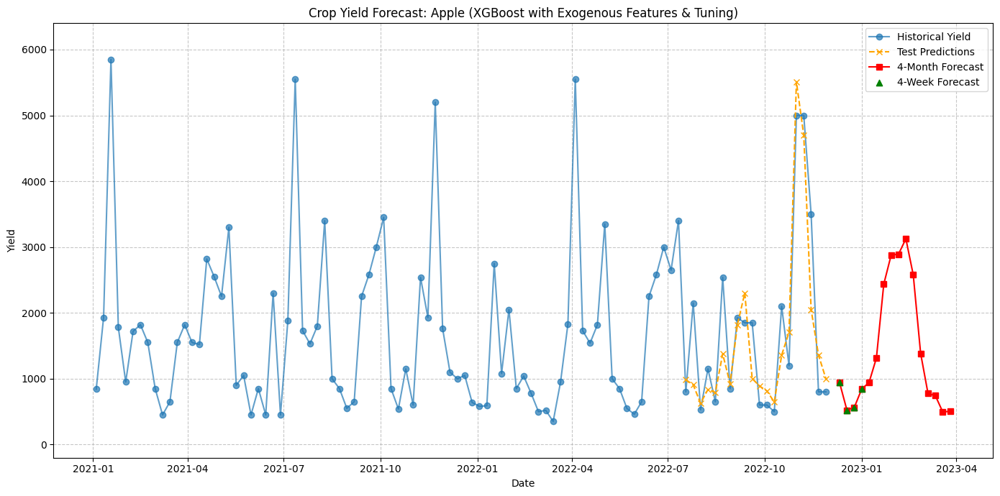


Processing crop: Banana
Best parameters for Banana: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 50}
[Evaluation Metrics] RMSE: 934.53 | MAE: 741.83 | MAPE: 63.11%


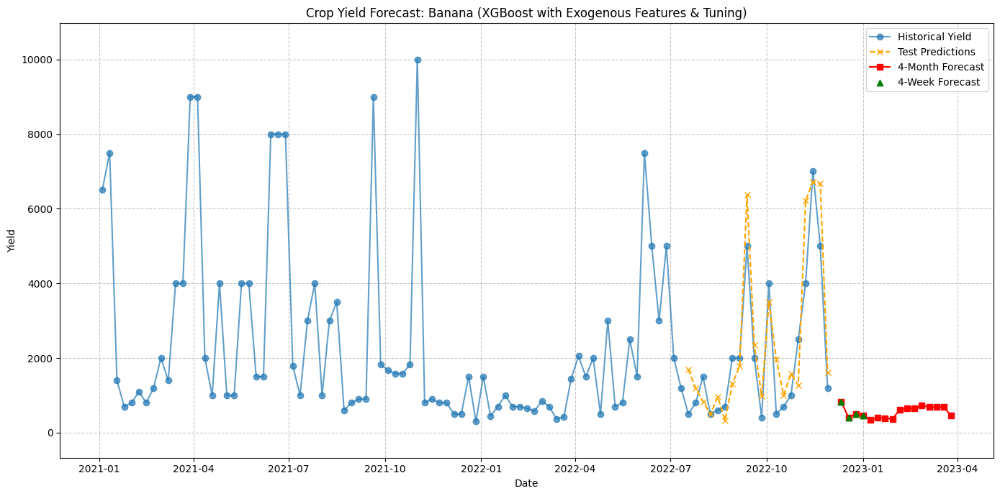


Processing crop: Blackgram
Best parameters for Blackgram: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 775.74 | MAE: 514.01 | MAPE: 5867.87%


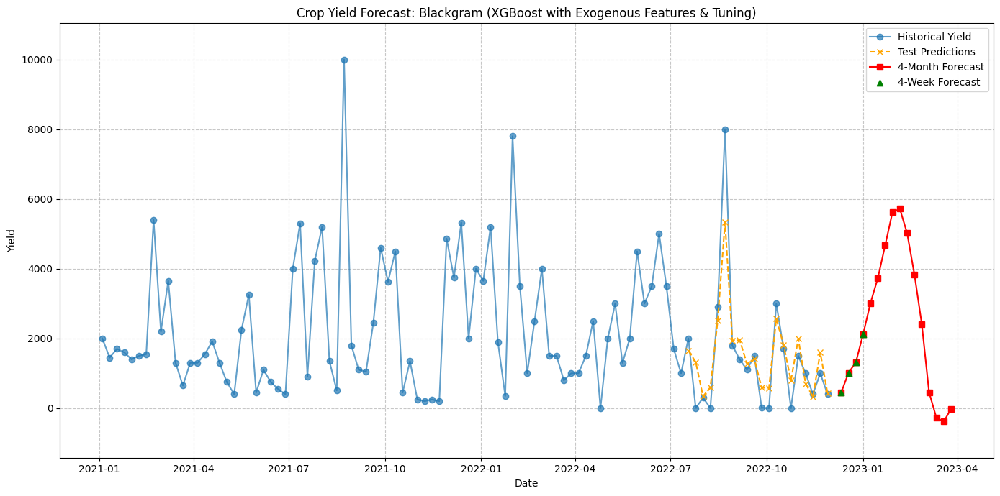


Processing crop: ChickPea
Best parameters for ChickPea: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 1448.58 | MAE: 1076.31 | MAPE: 34.64%


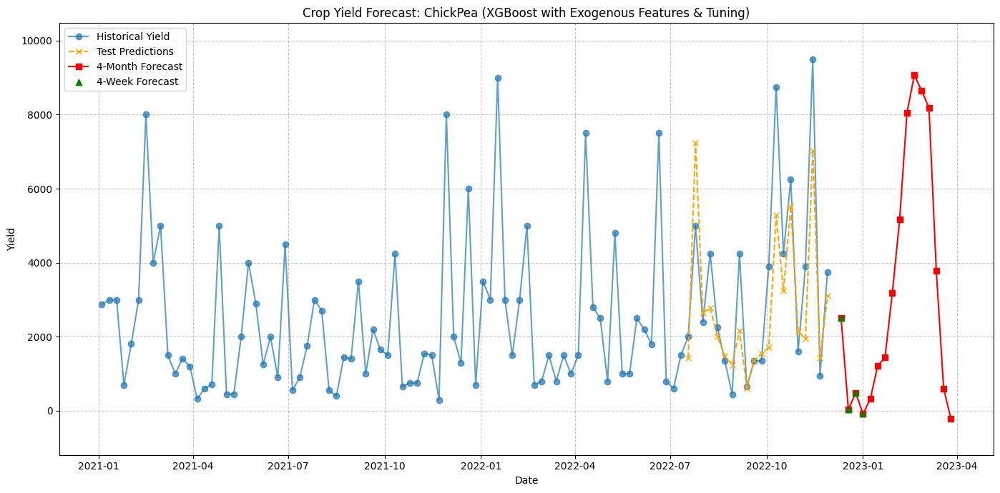


Processing crop: Coconut
Best parameters for Coconut: {'learning_rate': 0.01, 'max_depth': 7, 'n_estimators': 50}
[Evaluation Metrics] RMSE: 1536.50 | MAE: 1387.15 | MAPE: 233.97%


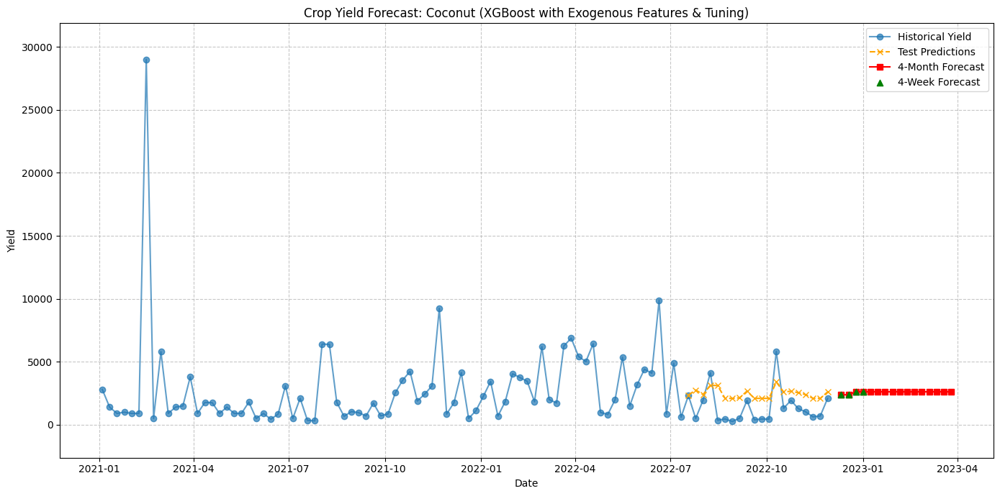


Processing crop: Coffee
Best parameters for Coffee: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 1007.94 | MAE: 834.62 | MAPE: 38.80%


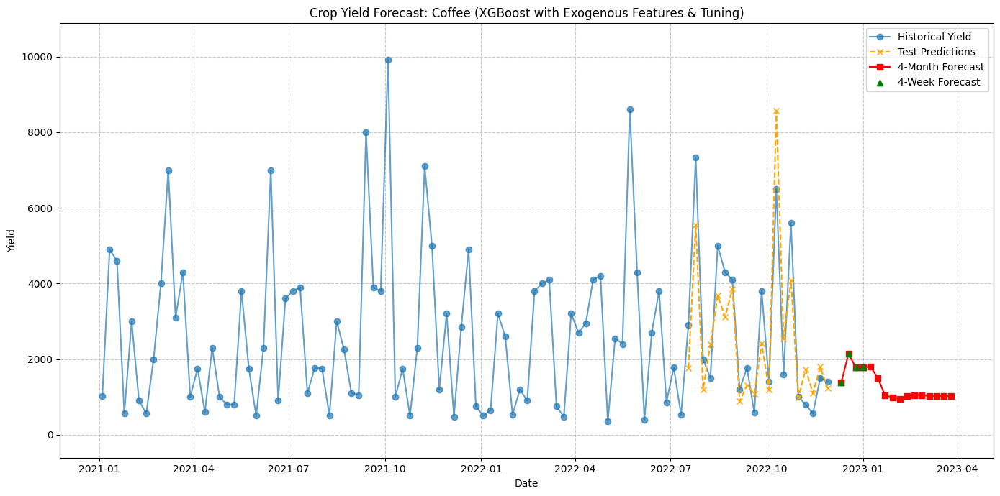


Processing crop: Cotton
Best parameters for Cotton: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 320.71 | MAE: 211.82 | MAPE: 22.82%


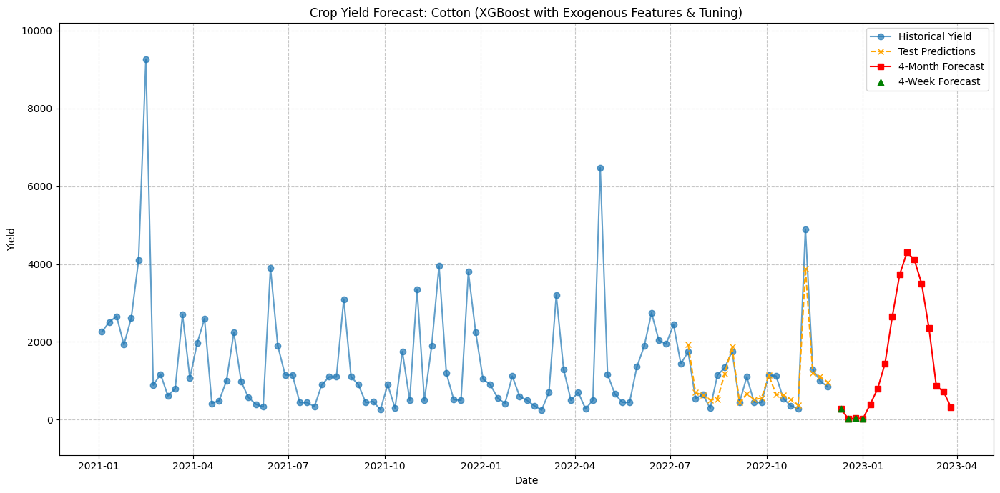


Processing crop: Grapes
Best parameters for Grapes: {'learning_rate': 0.2, 'max_depth': 5, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 1646.09 | MAE: 1147.94 | MAPE: 26.95%


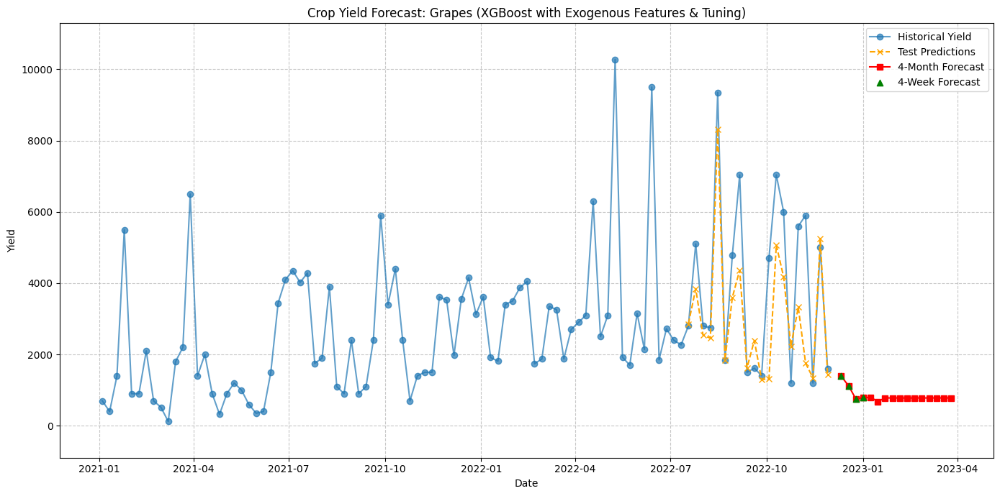


Processing crop: Jute
Best parameters for Jute: {'learning_rate': 0.2, 'max_depth': 5, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 2604.26 | MAE: 1782.80 | MAPE: 44.43%


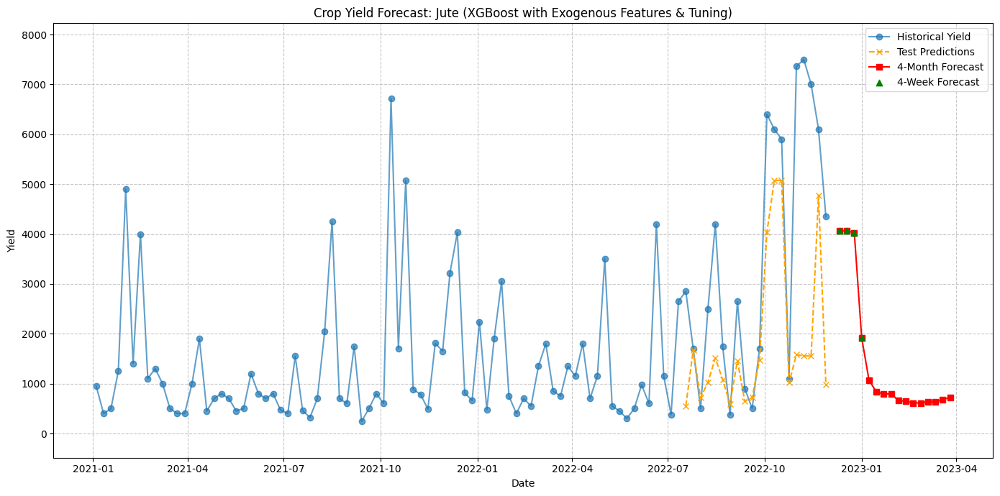


Processing crop: KidneyBeans
Best parameters for KidneyBeans: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 305.94 | MAE: 254.05 | MAPE: 13.62%


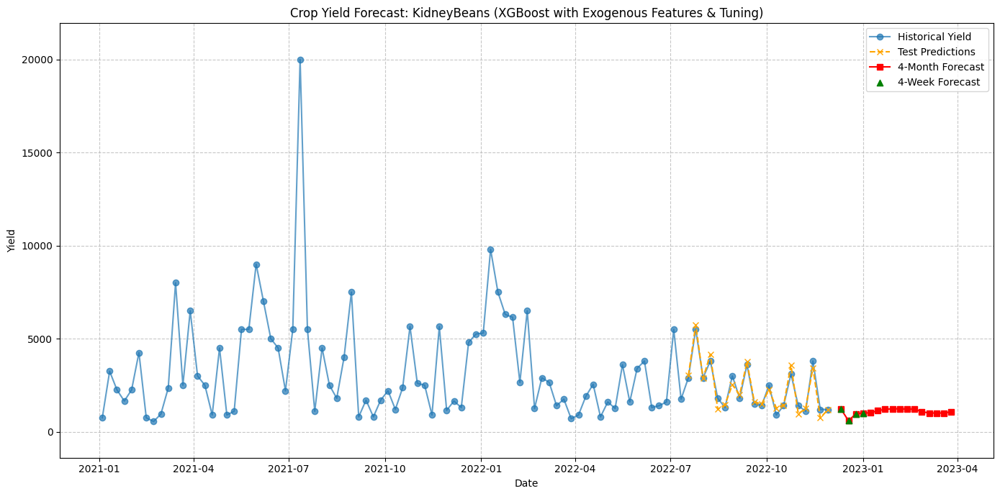


Processing crop: Lentil
Best parameters for Lentil: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 50}
[Evaluation Metrics] RMSE: 1434.33 | MAE: 991.65 | MAPE: 810.36%


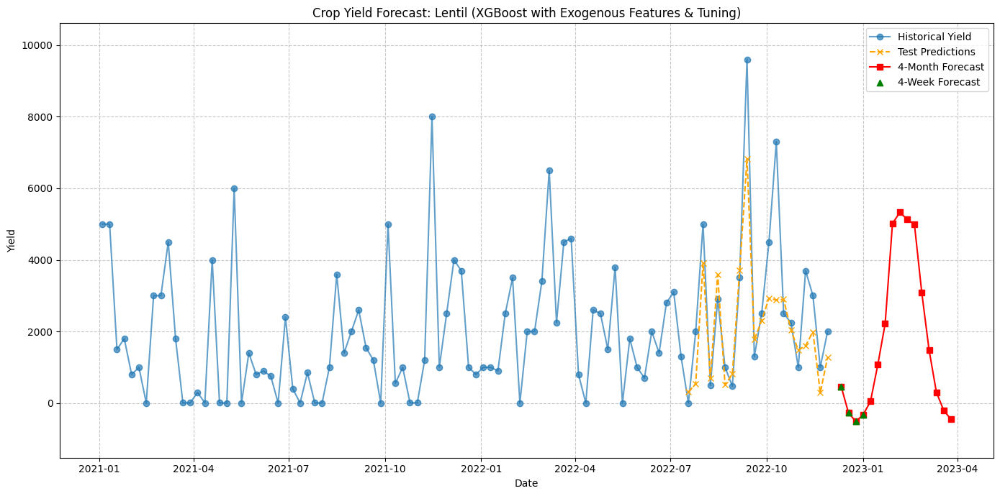


Processing crop: Maize
Best parameters for Maize: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 718.28 | MAE: 539.58 | MAPE: 50.46%


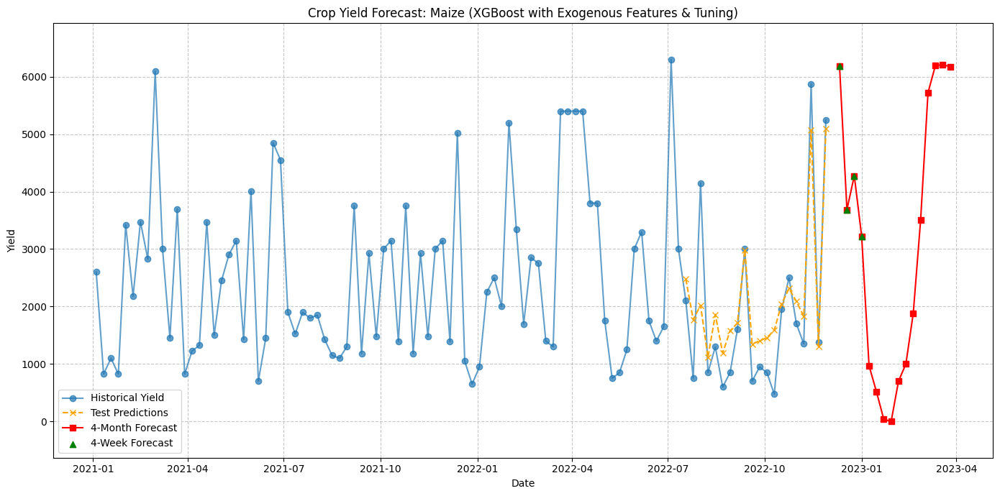


Processing crop: Mango
Best parameters for Mango: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 500.95 | MAE: 370.01 | MAPE: 40.66%


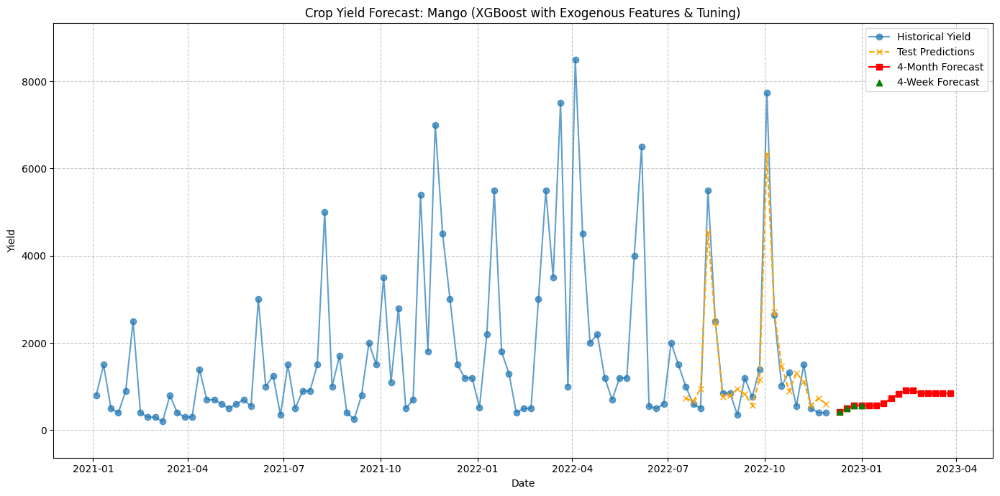


Processing crop: MothBeans
Best parameters for MothBeans: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 100}
[Evaluation Metrics] RMSE: 797.90 | MAE: 603.53 | MAPE: 32.71%


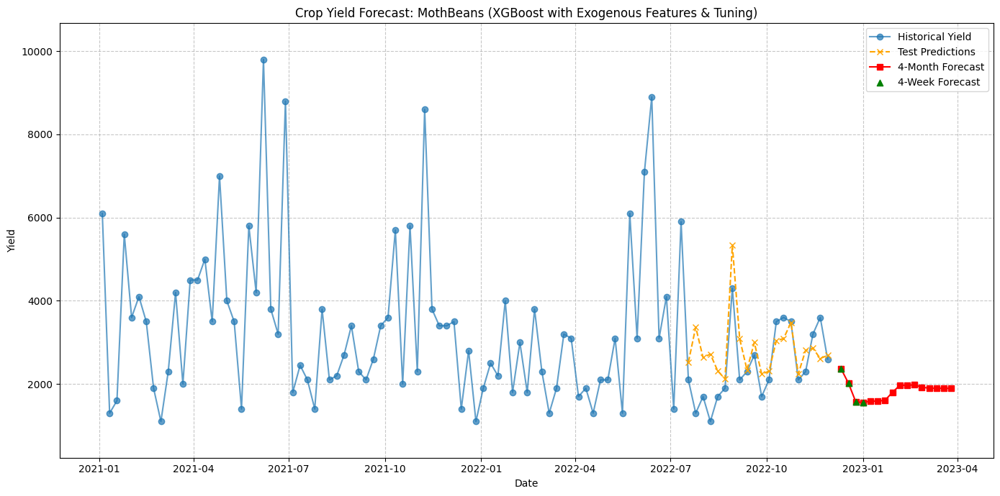


Processing crop: MungBean
Best parameters for MungBean: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 100}
[Evaluation Metrics] RMSE: 826.05 | MAE: 728.34 | MAPE: 71.58%


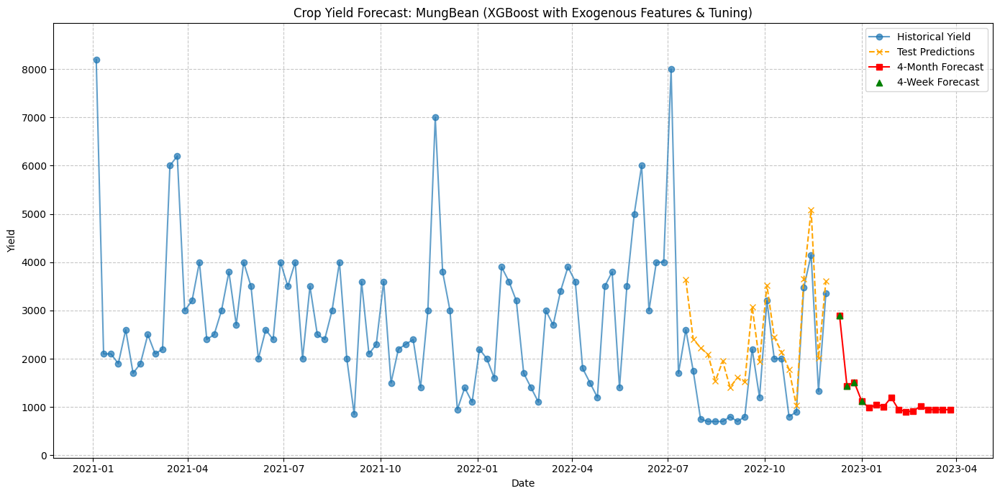


Processing crop: Muskmelon
Best parameters for Muskmelon: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 748.45 | MAE: 562.42 | MAPE: 59.81%


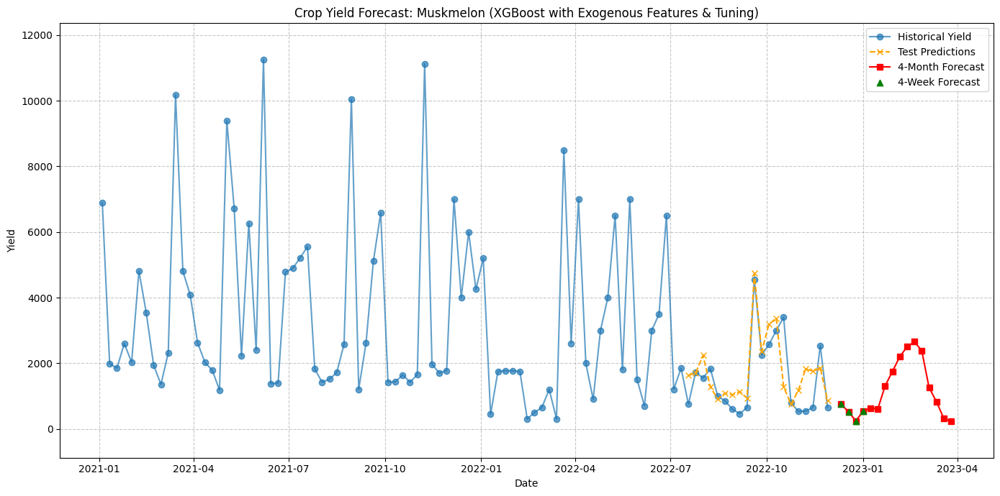


Processing crop: Orange
Best parameters for Orange: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 226.77 | MAE: 174.60 | MAPE: 29.79%


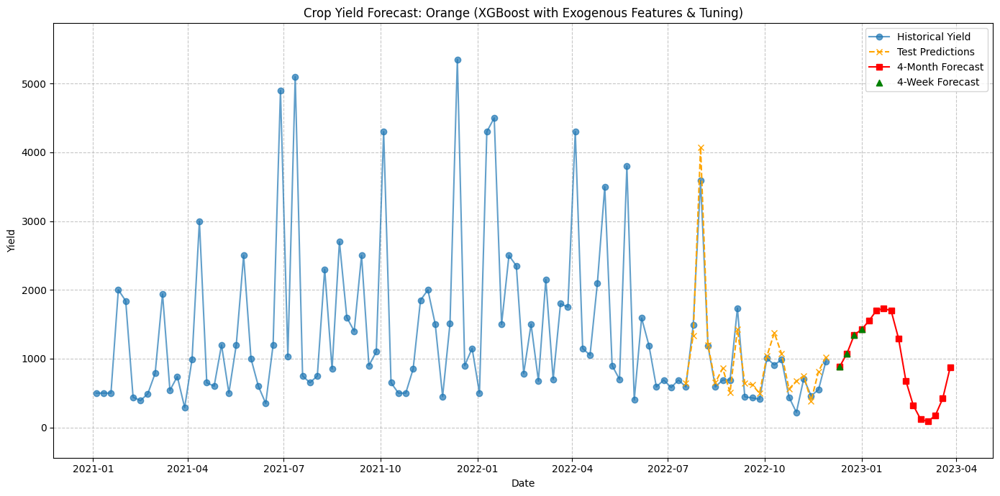


Processing crop: Papaya
Best parameters for Papaya: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 100}
[Evaluation Metrics] RMSE: 852.59 | MAE: 589.19 | MAPE: 49.74%


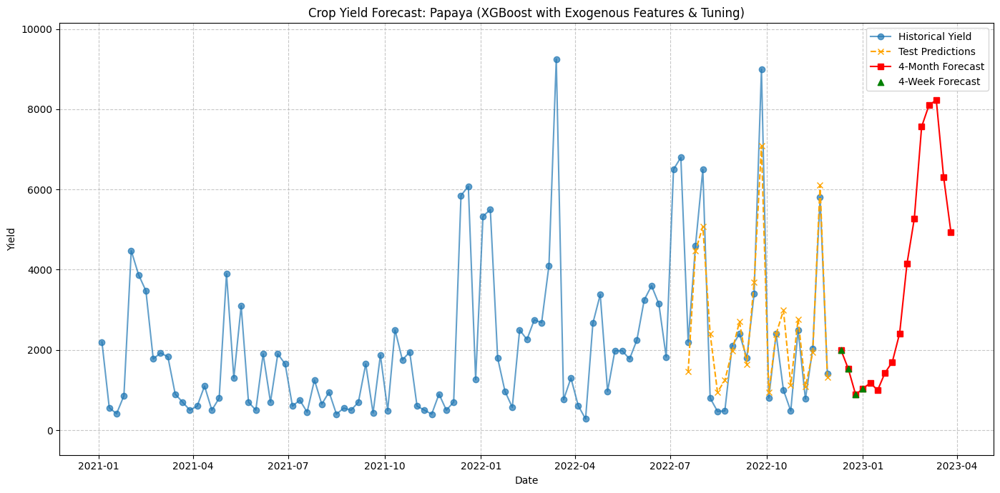


Processing crop: PigeonPeas
Best parameters for PigeonPeas: {'learning_rate': 0.2, 'max_depth': 7, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 1736.86 | MAE: 1218.70 | MAPE: 28.69%


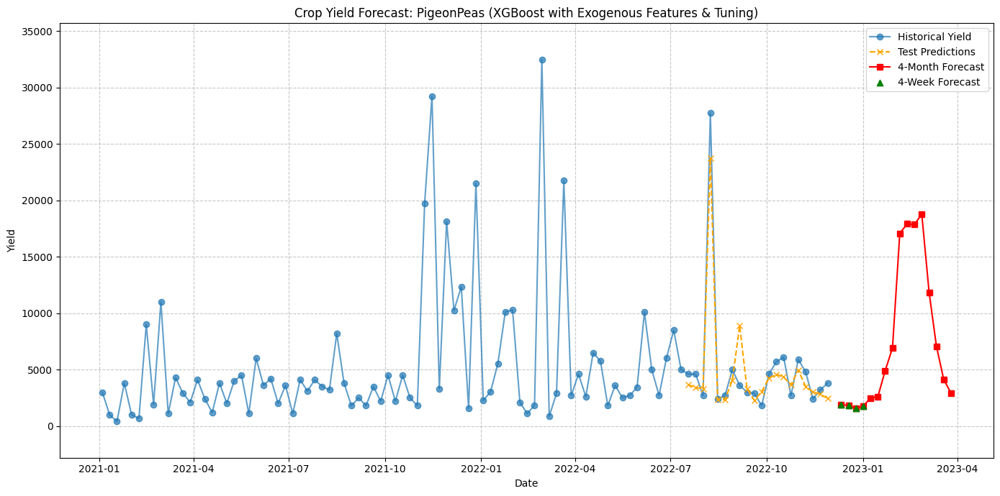


Processing crop: Pomegranate
Best parameters for Pomegranate: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 807.40 | MAE: 526.76 | MAPE: 29.63%


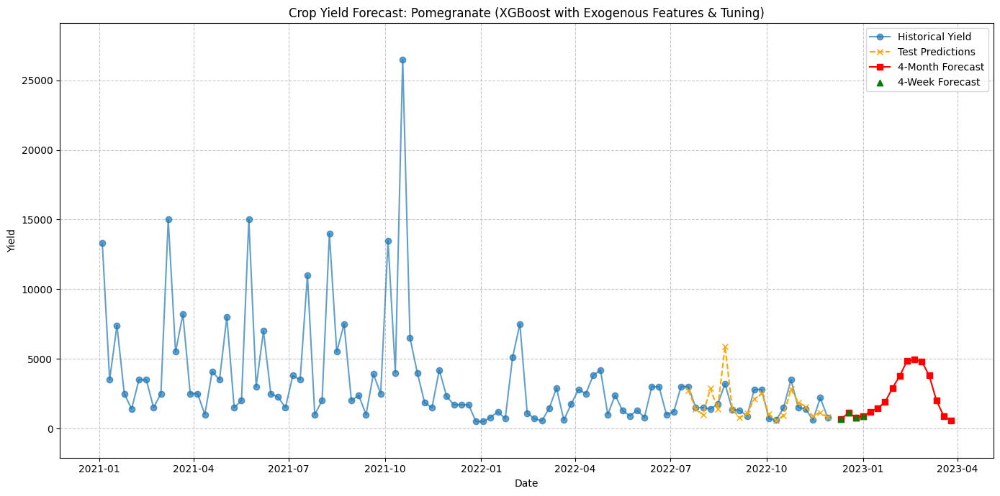


Processing crop: Rice
Best parameters for Rice: {'learning_rate': 0.01, 'max_depth': 7, 'n_estimators': 50}
[Evaluation Metrics] RMSE: 6148.08 | MAE: 4003.32 | MAPE: 143.08%


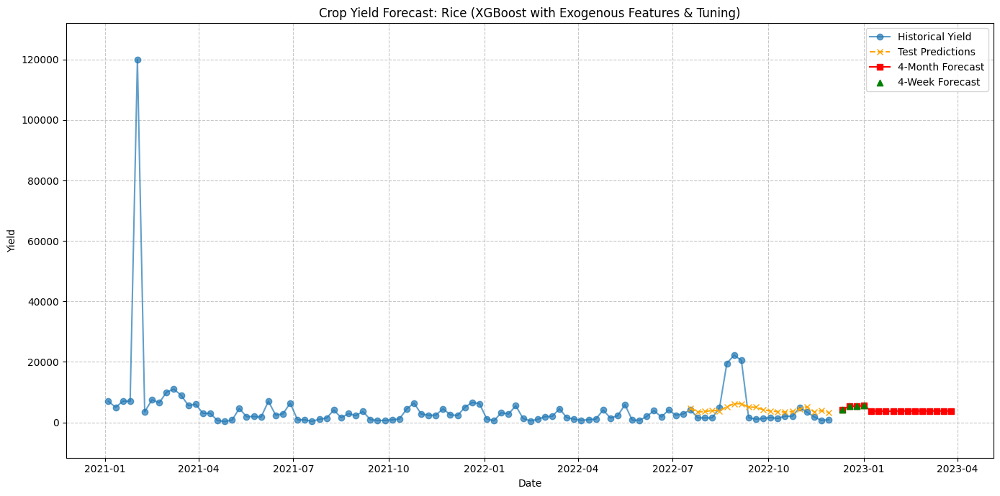


Processing crop: Watermelon
Best parameters for Watermelon: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200}
[Evaluation Metrics] RMSE: 1536.08 | MAE: 1051.72 | MAPE: 23.91%


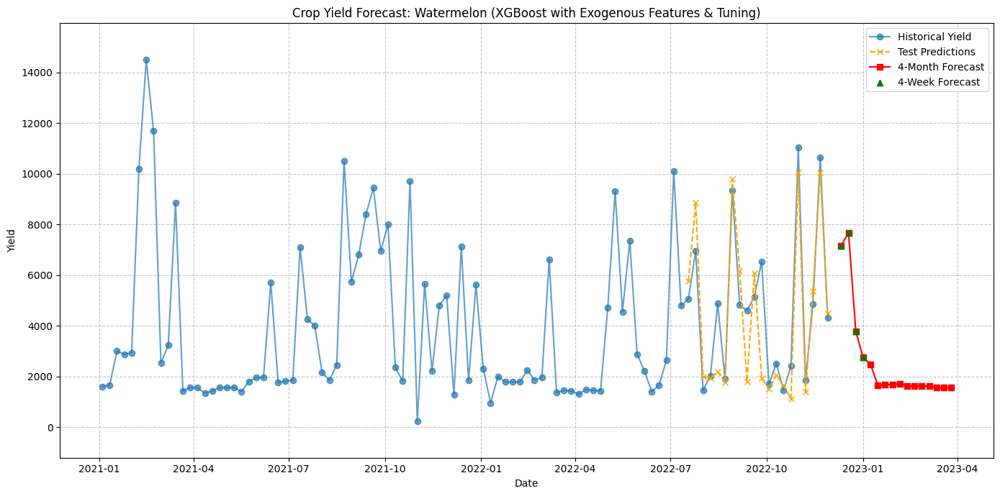



 Final Results Summary:

Apple

4-Week Forecast:
                 Yield
2022-12-11  940.499207
2022-12-18  522.539734
2022-12-25  564.678528
2023-01-01  841.525391

4-Month Forecast:
                  Yield
2022-12-11   940.499207
2022-12-18   522.539734
2022-12-25   564.678528
2023-01-01   841.525391
2023-01-08   942.423645
2023-01-15  1314.392700
2023-01-22  2436.798584
2023-01-29  2877.572754
2023-02-05  2892.375732
2023-02-12  3125.746338
2023-02-19  2576.670654
2023-02-26  1384.407593
2023-03-05   775.929810
2023-03-12   741.875122
2023-03-19   495.593414
2023-03-26   504.346344

Banana

4-Week Forecast:
                 Yield
2022-12-11  831.493652
2022-12-18  410.060760
2022-12-25  506.371796
2023-01-01  457.389771

4-Month Forecast:
                 Yield
2022-12-11  831.493652
2022-12-18  410.060760
2022-12-25  506.371796
2023-01-01  457.389771
2023-01-08  351.966339
2023-01-15  394.016449
2023-01-22  385.728699
2023-01-29  369.103302
2023-02-05  620.133606
2023-02-12  653.0

In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit
import warnings
warnings.filterwarnings("ignore")

exog_features = ['Nitrogen', 'Phosphorus', 'Potassium', 'Temperature', 'Humidity', 'pH_Value', 'Rainfall']

#this builds a DataFrame with lagged yields, rolling stats, lag differences, and optional exogenous features.
def create_features(df, n_lags=4, exog_features=None):
    feature_df = pd.DataFrame()
    feature_df['Yield'] = df['Yield']
    for lag in range(1, n_lags + 1):
        feature_df[f'lag_{lag}'] = df['Yield'].shift(lag)
    feature_df[f'rolling_mean_{n_lags}'] = df['Yield'].rolling(window=n_lags).mean().shift(1)
    feature_df[f'rolling_std_{n_lags}']  = df['Yield'].rolling(window=n_lags).std().shift(1)

    feature_df['lag_diff'] = df['Yield'] - df['Yield'].shift(n_lags)

    if exog_features is not None:
        for feat in exog_features:
            feature_df[feat] = df[feat]

    feature_df = feature_df.dropna()
    return feature_df

#same as in above model
def compute_extra_features(window):
    window = np.array(window)
    roll_mean = window.mean()
    roll_std = window.std()
    diff = window[-1] - window[0]
    return [roll_mean, roll_std, diff]
#same as in above model
def iterative_forecast(model, last_obs, steps, n_lags=4, extra_features_func=None, constant_exog=None):
    preds = []
    current_obs = list(last_obs)
    for _ in range(steps):
        X_pred = np.array(current_obs[-n_lags:]).reshape(1, -1)

        if extra_features_func is not None:
            extra = extra_features_func(current_obs[-n_lags:])
            extra = np.array(extra).reshape(1, -1)
            X_pred = np.concatenate([X_pred, extra], axis=1)

        if constant_exog is not None:
            constant_exog_arr = np.array(constant_exog).reshape(1, -1)
            X_pred = np.concatenate([X_pred, constant_exog_arr], axis=1)

        pred = model.predict(X_pred)[0]
        preds.append(pred)
        current_obs.append(pred)
    return preds

df = pd.read_csv('Crop_Data.csv', parse_dates=['Period'])
df['Period'] = pd.to_datetime(df['Period'])
df.set_index('Period', inplace=True)

crop_groups = df.groupby('Crop')
results = {}
n_lags = 4

for crop, group in crop_groups:
    print(f"\n{'='*40}\nProcessing crop: {crop}\n{'='*40}")

    crop_df = group.copy().sort_index()
    crop_df['Yield'] = crop_df['Yield'].ffill().bfill()
    for feat in exog_features:
        if feat in crop_df.columns:
            crop_df[feat] = crop_df[feat].ffill().bfill()

    sup_df = create_features(crop_df, n_lags=n_lags, exog_features=exog_features)
    split_idx = int(len(sup_df) * 0.8)
    train_df = sup_df.iloc[:split_idx]
    test_df = sup_df.iloc[split_idx:]

    X_train = train_df.drop('Yield', axis=1)
    y_train = train_df['Yield']
    X_test = test_df.drop('Yield', axis=1)
    y_test = test_df['Yield']

    tscv = TimeSeriesSplit(n_splits=3)
    param_grid = {
        'n_estimators': [50, 100, 200],
        'max_depth': [3, 5, 7],
        'learning_rate': [0.01, 0.1, 0.2]
    }
    xgb_model = XGBRegressor(objective='reg:squarederror', random_state=42)
    grid_search = GridSearchCV(estimator=xgb_model,
                               param_grid=param_grid,
                               cv=tscv,
                               scoring='neg_mean_squared_error',
                               verbose=0)
    grid_search.fit(X_train, y_train)
    best_params = grid_search.best_params_
    print(f"Best parameters for {crop}: {best_params}")

    model = XGBRegressor(objective='reg:squarederror', random_state=42, **best_params)
    model.fit(X_train, y_train)

    test_pred = model.predict(X_test)

    test_rmse = np.sqrt(mean_squared_error(y_test, test_pred))
    test_mae = mean_absolute_error(y_test, test_pred)
    epsilon = 1e-10
    test_mape = np.mean(np.abs((y_test - test_pred) / (y_test + epsilon))) * 100

    print(f"[Evaluation Metrics] RMSE: {test_rmse:.2f} | MAE: {test_mae:.2f} | MAPE: {test_mape:.2f}%")

    full_X = sup_df.drop('Yield', axis=1)
    full_y = sup_df['Yield']
    full_model = XGBRegressor(objective='reg:squarederror', random_state=42, **best_params)
    full_model.fit(full_X, full_y)

    last_obs = list(crop_df['Yield'].iloc[-n_lags:])

    constant_exog = crop_df[exog_features].iloc[-1].values


    forecast_4w_vals = iterative_forecast(full_model, last_obs, steps=4, n_lags=n_lags,
                                          extra_features_func=compute_extra_features,
                                          constant_exog=constant_exog)
    forecast_4m_vals = iterative_forecast(full_model, last_obs, steps=16, n_lags=n_lags,
                                          extra_features_func=compute_extra_features,
                                          constant_exog=constant_exog)

    last_date = crop_df.index[-1]
    forecast_4w_dates = pd.date_range(start=last_date + pd.DateOffset(weeks=1), periods=4, freq='W')
    forecast_4m_dates = pd.date_range(start=last_date + pd.DateOffset(weeks=1), periods=16, freq='W')

    results[crop] = {
        'Test_RMSE': test_rmse,
        'Test_MAE': test_mae,
        'Test_MAPE': test_mape,
        'Forecast_4_weeks': pd.Series(forecast_4w_vals, index=forecast_4w_dates),
        'Forecast_4_months': pd.Series(forecast_4m_vals, index=forecast_4m_dates)
    }

    plt.figure(figsize=(14, 7))

    plt.plot(crop_df.index, crop_df['Yield'], label='Historical Yield', marker='o', alpha=0.7)

    test_dates = test_df.index
    plt.plot(test_dates, test_pred, label='Test Predictions', linestyle='--', marker='x', color='orange')

    plt.plot(results[crop]['Forecast_4_months'].index, results[crop]['Forecast_4_months'].values,
             label='4-Month Forecast', marker='s', color='red')
    plt.scatter(results[crop]['Forecast_4_weeks'].index, results[crop]['Forecast_4_weeks'].values,
                label='4-Week Forecast', marker='^', color='green', zorder=5)

    plt.title(f"Crop Yield Forecast: {crop} (XGBoost with Exogenous Features & Tuning)")
    plt.xlabel("Date")
    plt.ylabel("Yield")
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()

    all_vals = pd.concat([
        crop_df['Yield'],
        pd.Series(test_pred, index=test_dates),
        results[crop]['Forecast_4_weeks'],
        results[crop]['Forecast_4_months']
    ])
    pad = (all_vals.max() - all_vals.min()) * 0.1
    plt.ylim(all_vals.min() - pad, all_vals.max() + pad)

    plt.show()

print("\n\n Final Results Summary:")
for crop, res in results.items():
    print(f"\n{'='*30}\n{crop}\n{'='*30}")
    print("\n4-Week Forecast:")
    print(res['Forecast_4_weeks'].to_frame(name='Yield') if res['Forecast_4_weeks'] is not None else "No forecast available")
    print("\n4-Month Forecast:")
    print(res['Forecast_4_months'].to_frame(name='Yield') if res['Forecast_4_months'] is not None else "No forecast available")


In [13]:
for crop, res in results.items():
    print(f"\n{'='*30}\n{crop}\n{'='*30}")
    print("Evaluation Metrics:")
    print(f"  RMSE: {res['Test_RMSE']:.2f} | MAE: {res['Test_MAE']:.2f} | MAPE: {res['Test_MAPE']:.2f}%")


Apple
Evaluation Metrics:
  RMSE: 623.25 | MAE: 477.15 | MAPE: 31.07%

Banana
Evaluation Metrics:
  RMSE: 934.53 | MAE: 741.83 | MAPE: 63.11%

Blackgram
Evaluation Metrics:
  RMSE: 775.74 | MAE: 514.01 | MAPE: 5867.87%

ChickPea
Evaluation Metrics:
  RMSE: 1448.58 | MAE: 1076.31 | MAPE: 34.64%

Coconut
Evaluation Metrics:
  RMSE: 1536.50 | MAE: 1387.15 | MAPE: 233.97%

Coffee
Evaluation Metrics:
  RMSE: 1007.94 | MAE: 834.62 | MAPE: 38.80%

Cotton
Evaluation Metrics:
  RMSE: 320.71 | MAE: 211.82 | MAPE: 22.82%

Grapes
Evaluation Metrics:
  RMSE: 1646.09 | MAE: 1147.94 | MAPE: 26.95%

Jute
Evaluation Metrics:
  RMSE: 2604.26 | MAE: 1782.80 | MAPE: 44.43%

KidneyBeans
Evaluation Metrics:
  RMSE: 305.94 | MAE: 254.05 | MAPE: 13.62%

Lentil
Evaluation Metrics:
  RMSE: 1434.33 | MAE: 991.65 | MAPE: 810.36%

Maize
Evaluation Metrics:
  RMSE: 718.28 | MAE: 539.58 | MAPE: 50.46%

Mango
Evaluation Metrics:
  RMSE: 500.95 | MAE: 370.01 | MAPE: 40.66%

MothBeans
Evaluation Metrics:
  RMSE: 797.9

# Prophet

## 5th model: prophet without exo


Processing crop: Apple


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/g2ow70cr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/5twtxymx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=55649', 'data', 'file=/tmp/tmp1y2nc7oi/g2ow70cr.json', 'init=/tmp/tmp1y2nc7oi/5twtxymx.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelfguiqz09/prophet_model-20250406233643.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1

[Evaluation Metrics]
RMSE: 1379.85 | MAE: 1078.50 | MAPE: 99.30%


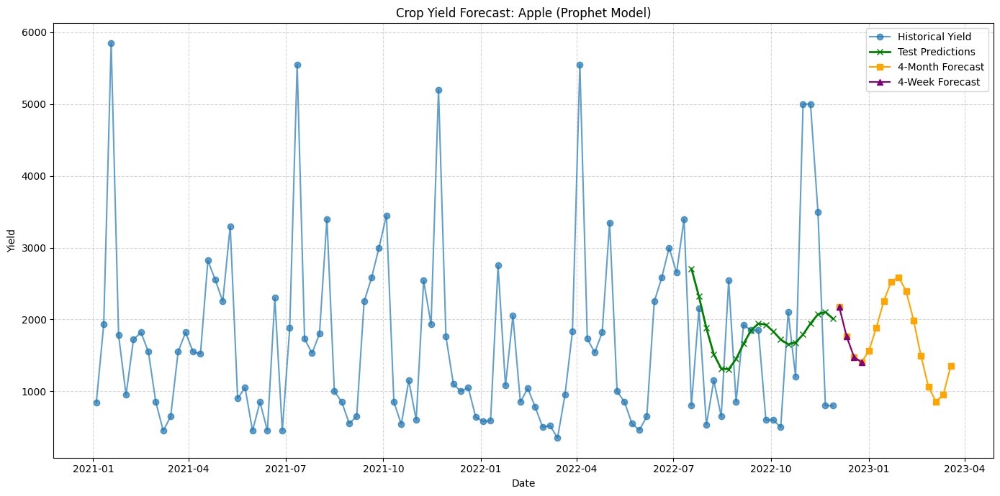

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/kk0dkw1g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/ruqu5l9j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65671', 'data', 'file=/tmp/tmp1y2nc7oi/kk0dkw1g.json', 'init=/tmp/tmp1y2nc7oi/ruqu5l9j.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modele5vi2zm7/prophet_model-20250406233644.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Banana


23:36:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/5hvs6lyy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/2j1rydsl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=72339', 'data', 'file=/tmp/tmp1y2nc7oi/5hvs6lyy.json', 'init=/tmp/tmp1y2nc7oi/2j1rydsl.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model03c8mt4z/prophet_model-20250406233644.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2239.52 | MAE: 1532.40 | MAPE: 75.88%


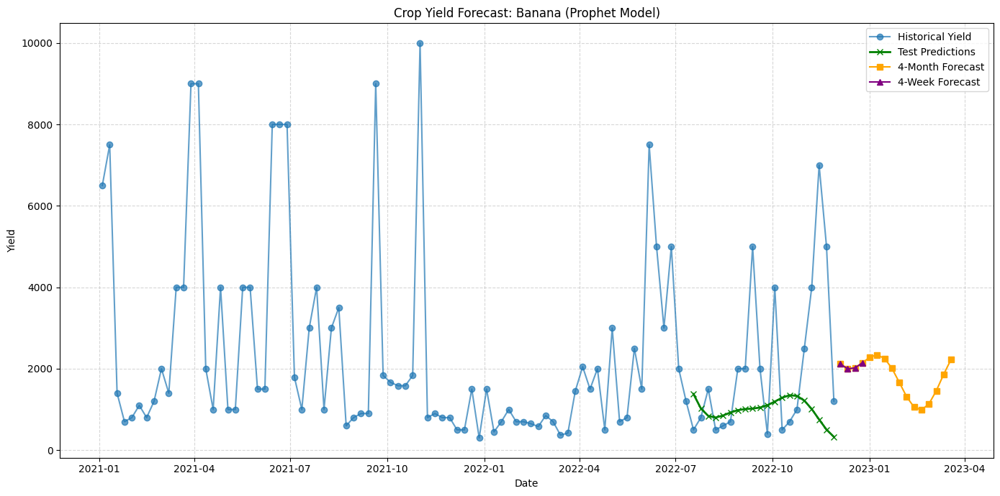

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/6ari5hu2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/b7b3a2ar.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5632', 'data', 'file=/tmp/tmp1y2nc7oi/6ari5hu2.json', 'init=/tmp/tmp1y2nc7oi/b7b3a2ar.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modeluimv7bic/prophet_model-20250406233644.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Blackgram


23:36:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/ztff191h.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/r2p5niad.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=71261', 'data', 'file=/tmp/tmp1y2nc7oi/ztff191h.json', 'init=/tmp/tmp1y2nc7oi/r2p5niad.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelv5ymcxrq/prophet_model-20250406233645.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2681.06 | MAE: 2270.57 | MAPE: 22849.98%


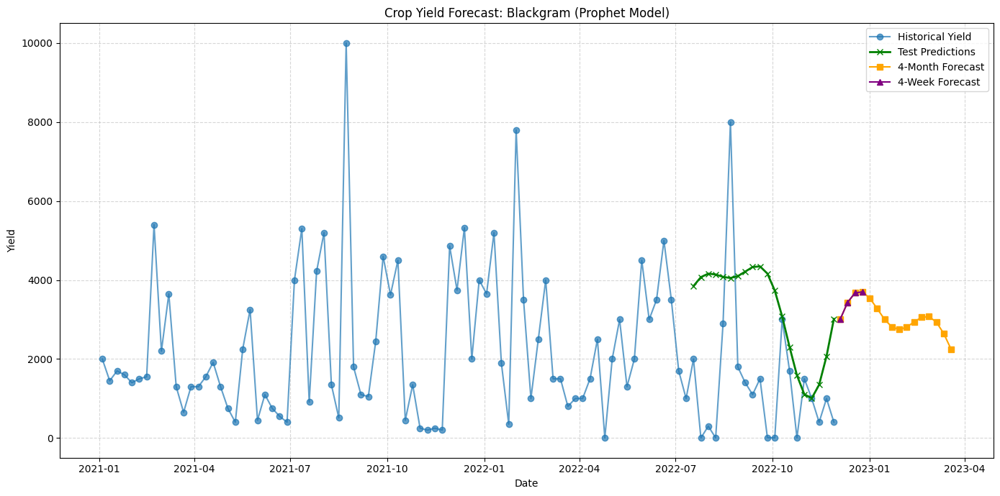

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/8rgsqbpf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/50yn553z.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77123', 'data', 'file=/tmp/tmp1y2nc7oi/8rgsqbpf.json', 'init=/tmp/tmp1y2nc7oi/50yn553z.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelz0grczhk/prophet_model-20250406233645.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: ChickPea


23:36:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/tuqvd2ta.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/b43_t22p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38071', 'data', 'file=/tmp/tmp1y2nc7oi/tuqvd2ta.json', 'init=/tmp/tmp1y2nc7oi/b43_t22p.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model226gv8c0/prophet_model-20250406233646.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 3050.63 | MAE: 2290.49 | MAPE: 86.08%


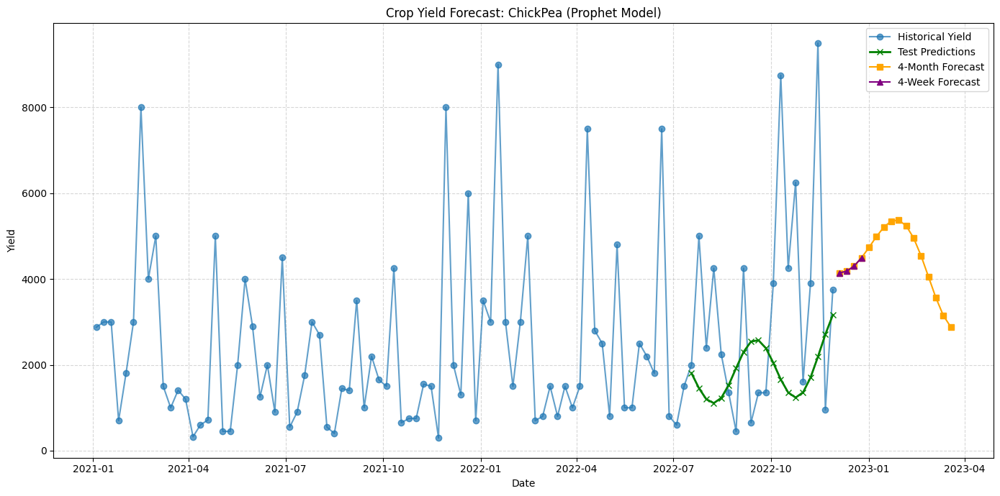

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/1jx8gtd4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/3jscf059.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=57968', 'data', 'file=/tmp/tmp1y2nc7oi/1jx8gtd4.json', 'init=/tmp/tmp1y2nc7oi/3jscf059.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model61loq4mc/prophet_model-20250406233646.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Coconut


23:36:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/h2db8r0w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/1y0whnpa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61881', 'data', 'file=/tmp/tmp1y2nc7oi/h2db8r0w.json', 'init=/tmp/tmp1y2nc7oi/1y0whnpa.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modeldfhop21i/prophet_model-20250406233647.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 4399.87 | MAE: 3834.24 | MAPE: 570.38%


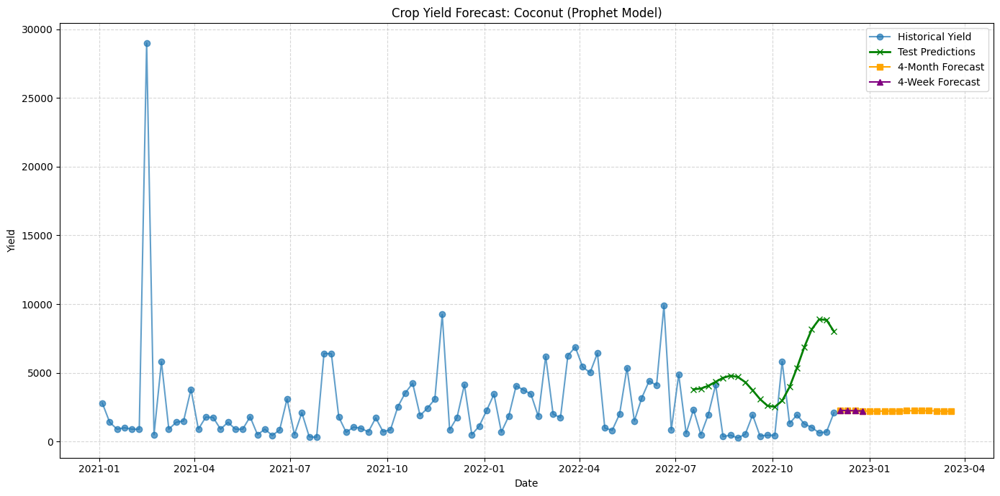

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/z0bypnjm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/7q_t_0zy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63421', 'data', 'file=/tmp/tmp1y2nc7oi/z0bypnjm.json', 'init=/tmp/tmp1y2nc7oi/7q_t_0zy.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model_5s4b_b0/prophet_model-20250406233648.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Coffee


23:36:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/w9faql45.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/36wfet98.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68007', 'data', 'file=/tmp/tmp1y2nc7oi/w9faql45.json', 'init=/tmp/tmp1y2nc7oi/36wfet98.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelf6pnt19k/prophet_model-20250406233648.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2405.47 | MAE: 2060.47 | MAPE: 128.94%


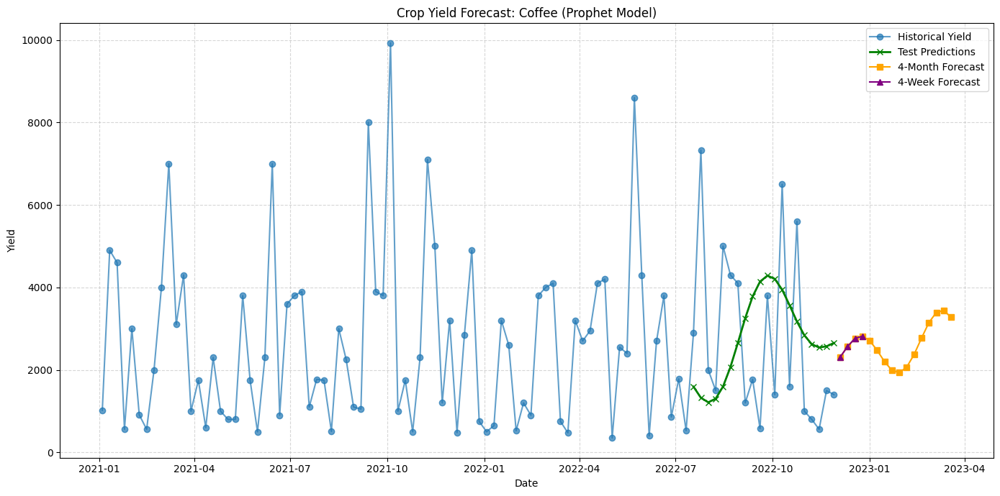

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/g46c8us6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/s5t95z3n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=34364', 'data', 'file=/tmp/tmp1y2nc7oi/g46c8us6.json', 'init=/tmp/tmp1y2nc7oi/s5t95z3n.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelh0txxng3/prophet_model-20250406233649.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Cotton


23:36:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/_dg862zu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/ebxmzysb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36542', 'data', 'file=/tmp/tmp1y2nc7oi/_dg862zu.json', 'init=/tmp/tmp1y2nc7oi/ebxmzysb.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model015spg76/prophet_model-20250406233650.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 4213.49 | MAE: 2996.14 | MAPE: 454.22%


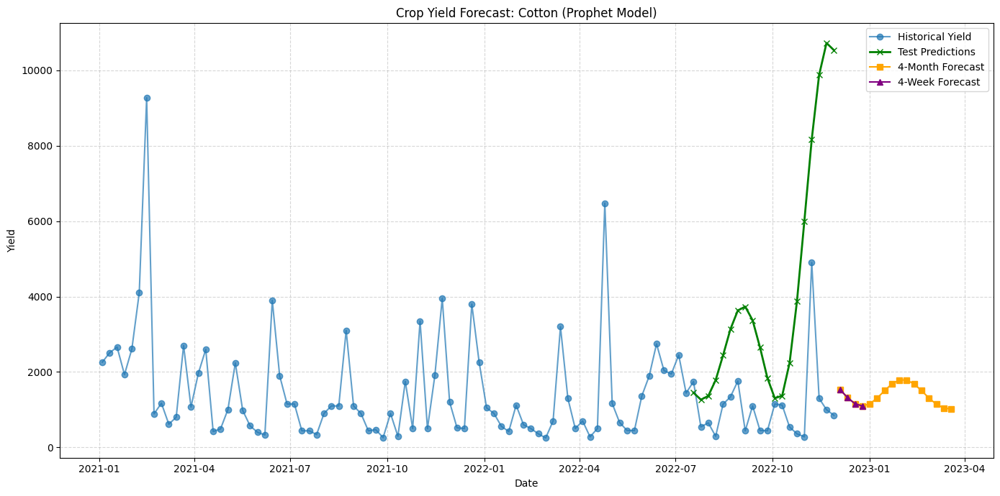

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/a6y67yg6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/5gqz8fkr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79585', 'data', 'file=/tmp/tmp1y2nc7oi/a6y67yg6.json', 'init=/tmp/tmp1y2nc7oi/5gqz8fkr.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelnv13kod4/prophet_model-20250406233651.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Grapes


23:36:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/cmqum28c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/19fog99i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60578', 'data', 'file=/tmp/tmp1y2nc7oi/cmqum28c.json', 'init=/tmp/tmp1y2nc7oi/19fog99i.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelvs7fnicl/prophet_model-20250406233651.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2683.28 | MAE: 2210.55 | MAPE: 80.40%


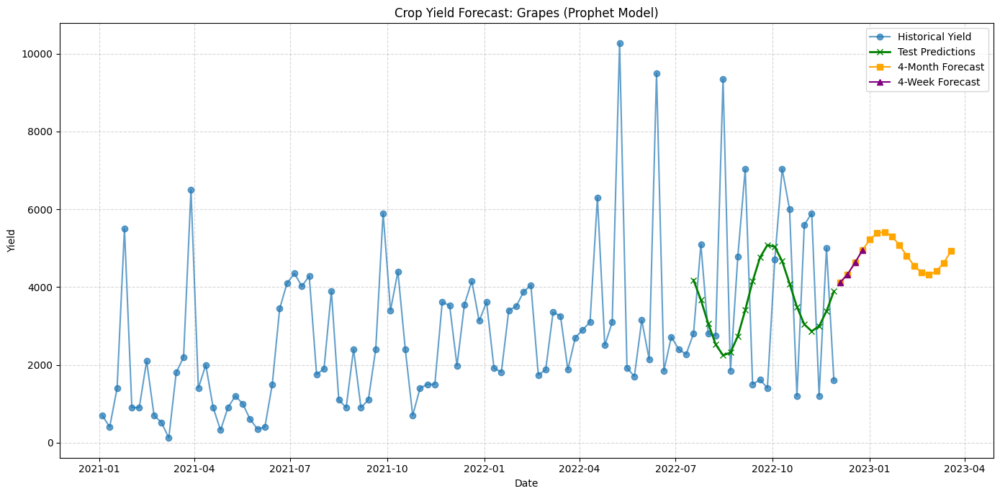

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/dmo6fgsc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/71kdioy6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6237', 'data', 'file=/tmp/tmp1y2nc7oi/dmo6fgsc.json', 'init=/tmp/tmp1y2nc7oi/71kdioy6.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelc_rmmtke/prophet_model-20250406233652.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Jute


23:36:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/nhtdh11e.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/5ckpcbw1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38693', 'data', 'file=/tmp/tmp1y2nc7oi/nhtdh11e.json', 'init=/tmp/tmp1y2nc7oi/5ckpcbw1.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelamq3gpg9/prophet_model-20250406233652.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2650.88 | MAE: 2156.99 | MAPE: 83.66%


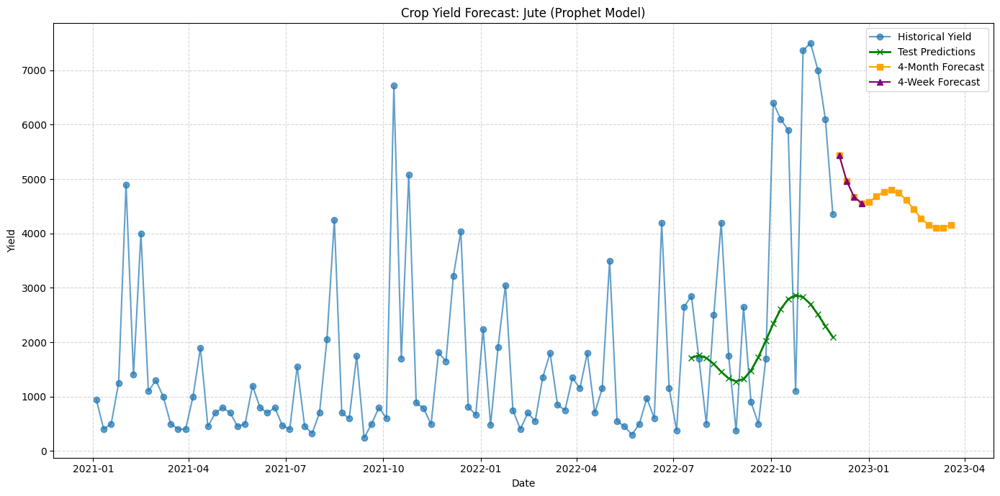

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/fcirgt7k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/3_qfpyxx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=18731', 'data', 'file=/tmp/tmp1y2nc7oi/fcirgt7k.json', 'init=/tmp/tmp1y2nc7oi/3_qfpyxx.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelqovf2q5p/prophet_model-20250406233653.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: KidneyBeans


23:36:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/qjoebzpq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/gteg2mvx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19164', 'data', 'file=/tmp/tmp1y2nc7oi/qjoebzpq.json', 'init=/tmp/tmp1y2nc7oi/gteg2mvx.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelrbdpvr6b/prophet_model-20250406233653.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2114.56 | MAE: 1860.44 | MAPE: 83.54%


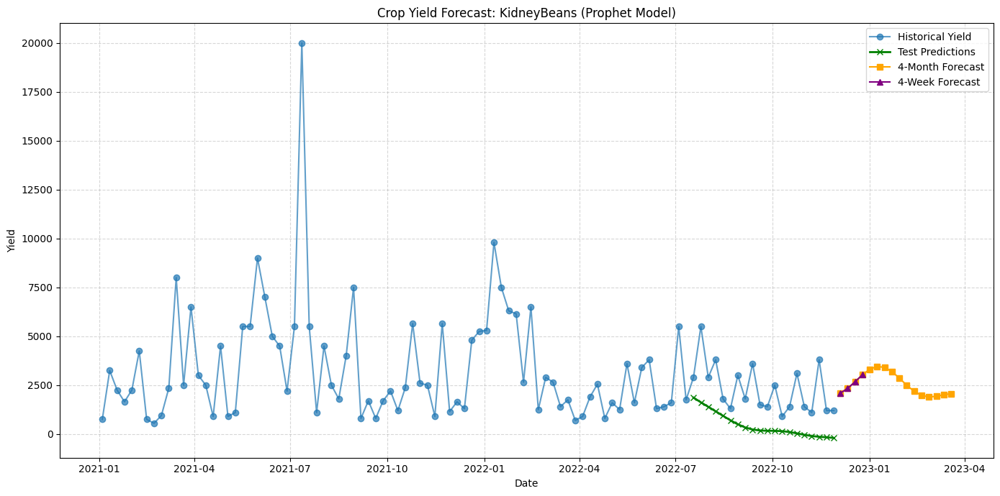

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/9hb24813.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/0heecn5s.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53943', 'data', 'file=/tmp/tmp1y2nc7oi/9hb24813.json', 'init=/tmp/tmp1y2nc7oi/0heecn5s.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelxp710o8y/prophet_model-20250406233654.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Lentil


23:36:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/j9xdxr5w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/t30773ls.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42521', 'data', 'file=/tmp/tmp1y2nc7oi/j9xdxr5w.json', 'init=/tmp/tmp1y2nc7oi/t30773ls.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelmm8qcs27/prophet_model-20250406233654.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:54 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2547.47 | MAE: 1867.61 | MAPE: 3192.47%


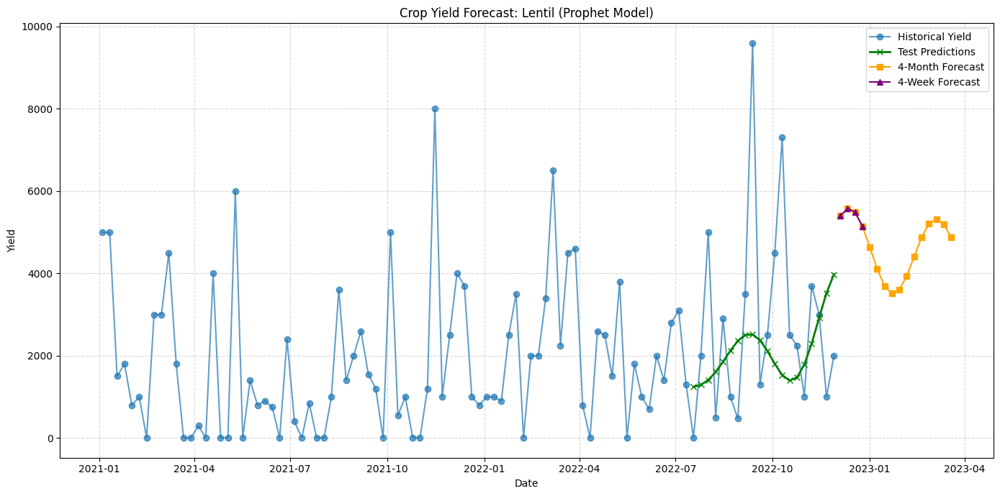

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/kotwvwi4.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/c9ss8odb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30982', 'data', 'file=/tmp/tmp1y2nc7oi/kotwvwi4.json', 'init=/tmp/tmp1y2nc7oi/c9ss8odb.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelcg_87f2b/prophet_model-20250406233655.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Maize


23:36:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/nf0iabbf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/q9hxppjl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=60849', 'data', 'file=/tmp/tmp1y2nc7oi/nf0iabbf.json', 'init=/tmp/tmp1y2nc7oi/q9hxppjl.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelh_4ra2yi/prophet_model-20250406233656.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:56 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 1610.77 | MAE: 1400.28 | MAPE: 126.07%


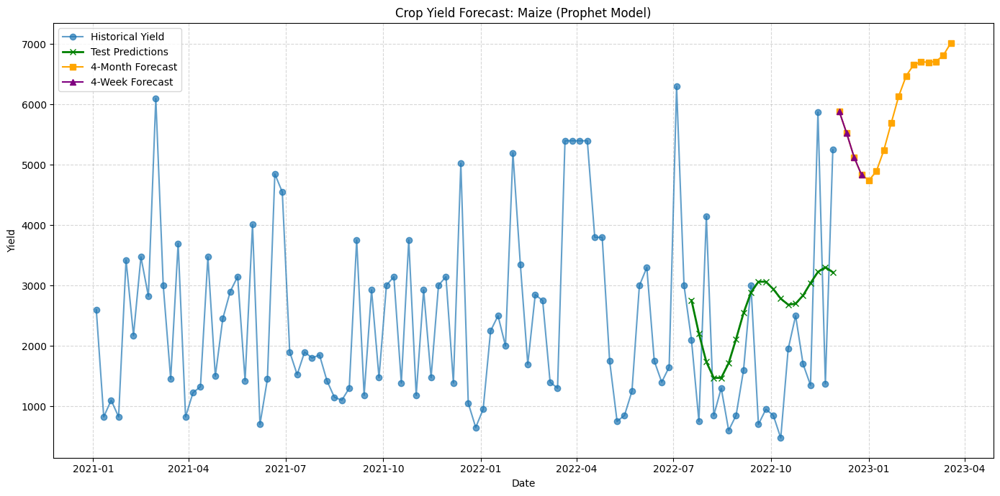

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/4mbfwu_c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/zsgpmxx0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=91221', 'data', 'file=/tmp/tmp1y2nc7oi/4mbfwu_c.json', 'init=/tmp/tmp1y2nc7oi/zsgpmxx0.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model917hvxf3/prophet_model-20250406233656.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Mango


23:36:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/waug09vq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/dpht89ju.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=39236', 'data', 'file=/tmp/tmp1y2nc7oi/waug09vq.json', 'init=/tmp/tmp1y2nc7oi/dpht89ju.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelamub20qm/prophet_model-20250406233657.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 4258.03 | MAE: 3587.76 | MAPE: 525.72%


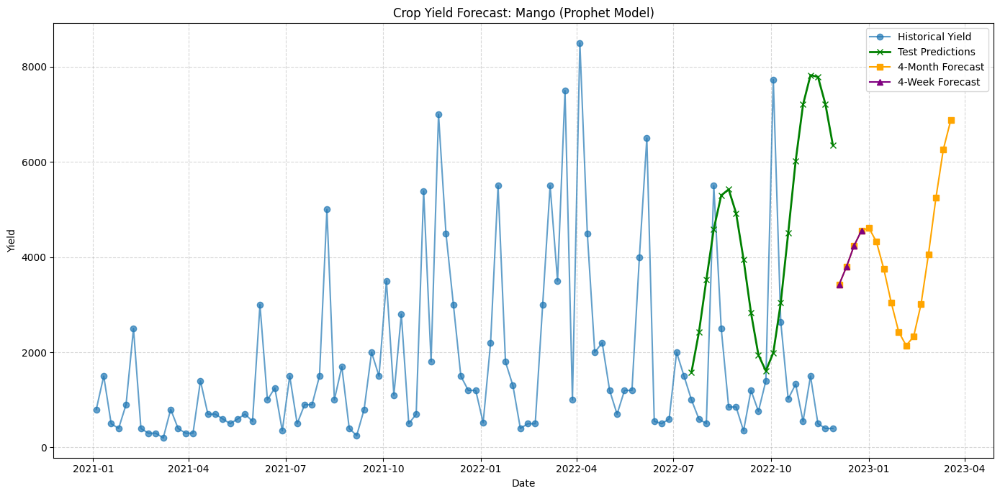

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/l66ygk17.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/swuyy5kx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=68334', 'data', 'file=/tmp/tmp1y2nc7oi/l66ygk17.json', 'init=/tmp/tmp1y2nc7oi/swuyy5kx.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model8ko3fj82/prophet_model-20250406233657.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: MothBeans


23:36:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/2vybxl80.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/crar6lvz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35115', 'data', 'file=/tmp/tmp1y2nc7oi/2vybxl80.json', 'init=/tmp/tmp1y2nc7oi/crar6lvz.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelroc6q_gi/prophet_model-20250406233658.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 816.78 | MAE: 563.08 | MAPE: 24.16%


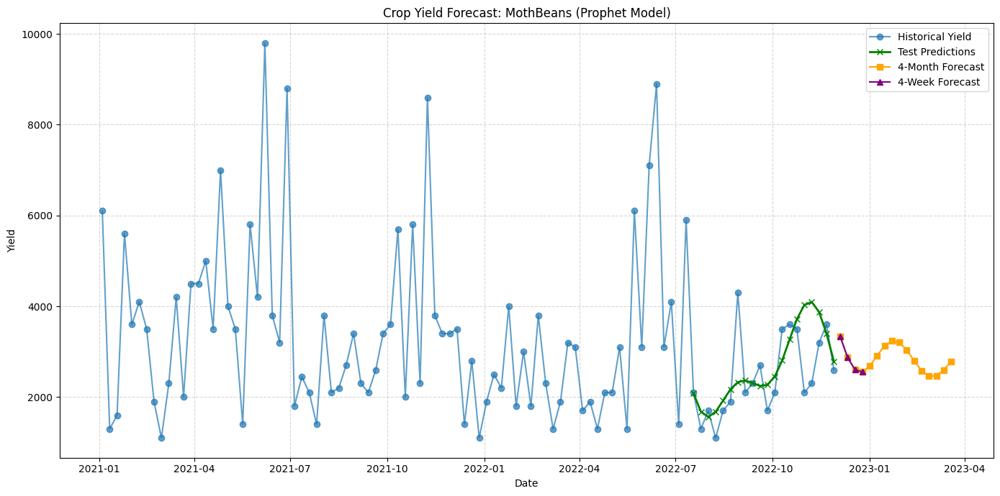

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/fhz_3cof.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/i6zjmo6o.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97936', 'data', 'file=/tmp/tmp1y2nc7oi/fhz_3cof.json', 'init=/tmp/tmp1y2nc7oi/i6zjmo6o.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelkmem2vud/prophet_model-20250406233658.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:36:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: MungBean


23:36:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/a9yzhs50.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/j92mhpbm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=59143', 'data', 'file=/tmp/tmp1y2nc7oi/a9yzhs50.json', 'init=/tmp/tmp1y2nc7oi/j92mhpbm.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modeldk9qk8ja/prophet_model-20250406233659.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:36:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:36:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 1406.85 | MAE: 1220.85 | MAPE: 130.62%


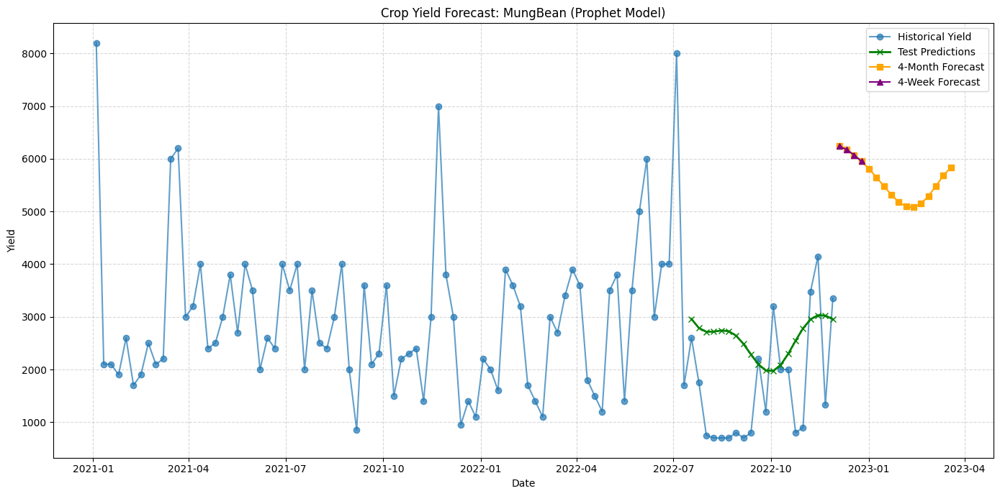

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/nzwvwnk6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/_kqjy1m1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41827', 'data', 'file=/tmp/tmp1y2nc7oi/nzwvwnk6.json', 'init=/tmp/tmp1y2nc7oi/_kqjy1m1.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelili17n30/prophet_model-20250406233700.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Muskmelon


23:37:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/0s5jsbaw.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/emp53imc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58851', 'data', 'file=/tmp/tmp1y2nc7oi/0s5jsbaw.json', 'init=/tmp/tmp1y2nc7oi/emp53imc.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model_am22x7f/prophet_model-20250406233700.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:00 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 1364.20 | MAE: 1165.50 | MAPE: 147.35%


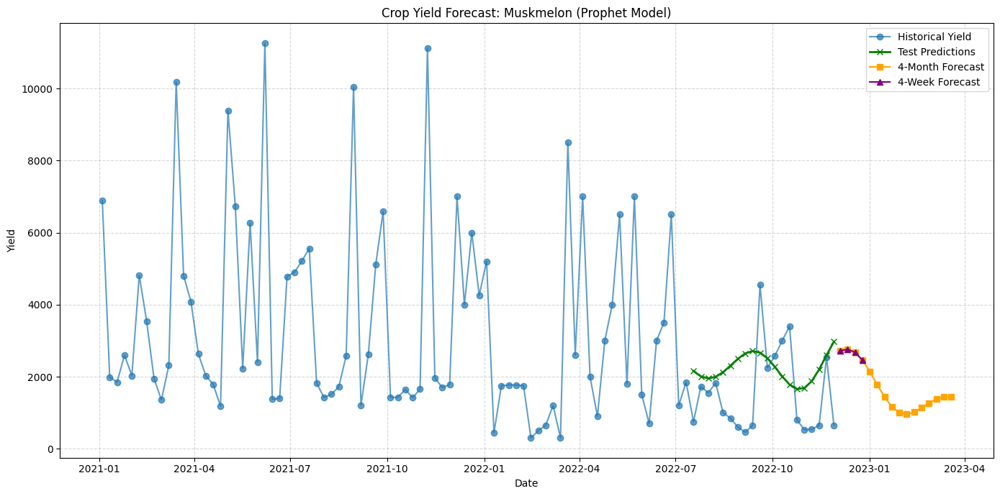

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/buanhw5y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/jfm_w3ch.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90705', 'data', 'file=/tmp/tmp1y2nc7oi/buanhw5y.json', 'init=/tmp/tmp1y2nc7oi/jfm_w3ch.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelaozxk19s/prophet_model-20250406233701.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Orange


23:37:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/rdnwnd7y.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/bmop0ag3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78177', 'data', 'file=/tmp/tmp1y2nc7oi/rdnwnd7y.json', 'init=/tmp/tmp1y2nc7oi/bmop0ag3.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelbp7r9b46/prophet_model-20250406233702.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:02 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 1515.43 | MAE: 1431.87 | MAPE: 248.52%


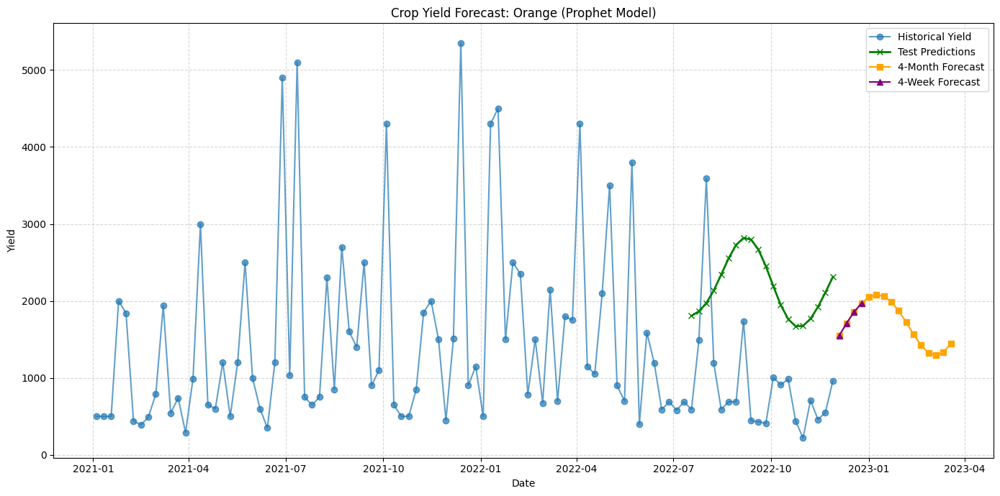

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/w52opchq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/d03780b7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82483', 'data', 'file=/tmp/tmp1y2nc7oi/w52opchq.json', 'init=/tmp/tmp1y2nc7oi/d03780b7.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelrclwuf31/prophet_model-20250406233703.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Papaya


23:37:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/zjxd4avl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/p66lmfn7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=58086', 'data', 'file=/tmp/tmp1y2nc7oi/zjxd4avl.json', 'init=/tmp/tmp1y2nc7oi/p66lmfn7.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelzegteif1/prophet_model-20250406233703.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2317.76 | MAE: 1863.77 | MAPE: 103.36%


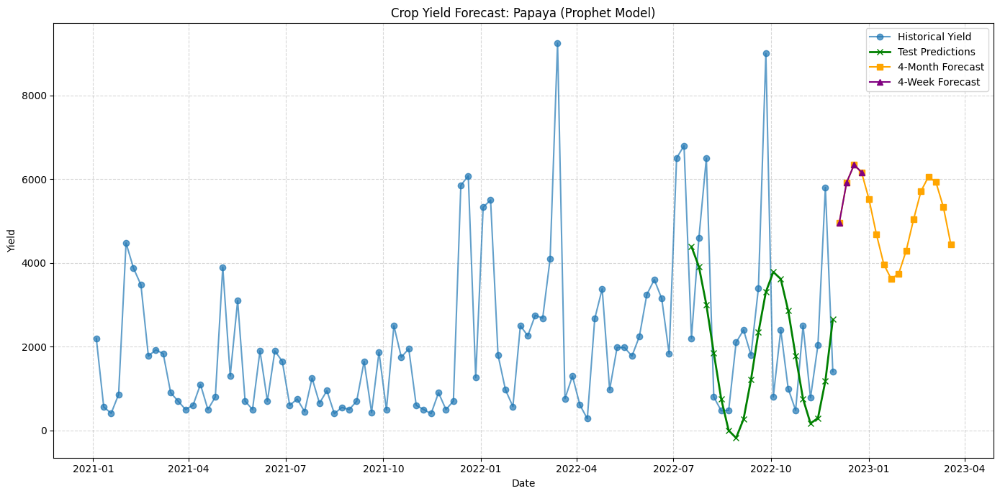

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/digtc_s2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/mkug60pe.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95955', 'data', 'file=/tmp/tmp1y2nc7oi/digtc_s2.json', 'init=/tmp/tmp1y2nc7oi/mkug60pe.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelm_2iim7a/prophet_model-20250406233704.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: PigeonPeas


23:37:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/dcpcbc_n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/ylcnf95y.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41734', 'data', 'file=/tmp/tmp1y2nc7oi/dcpcbc_n.json', 'init=/tmp/tmp1y2nc7oi/ylcnf95y.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model28o8kdcq/prophet_model-20250406233705.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 10304.19 | MAE: 7136.71 | MAPE: 189.41%


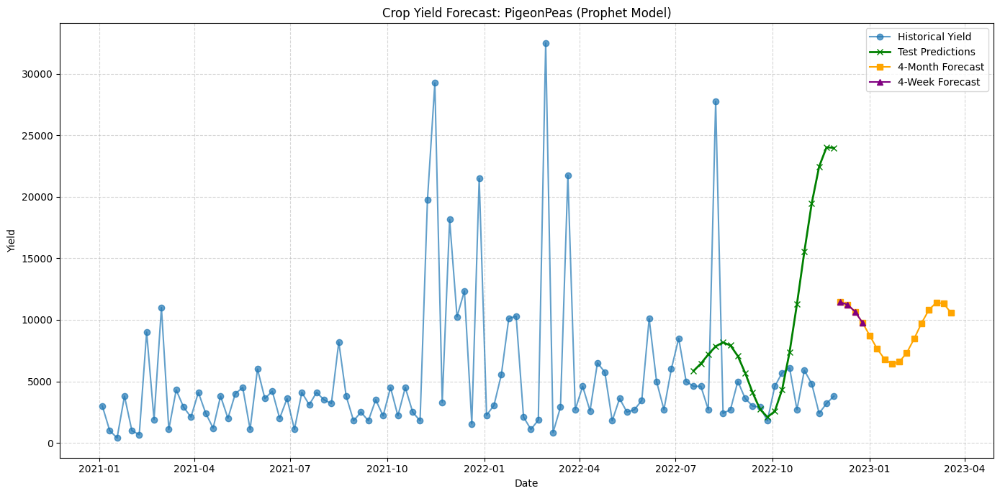

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/h_816hbd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/srrcy34h.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30416', 'data', 'file=/tmp/tmp1y2nc7oi/h_816hbd.json', 'init=/tmp/tmp1y2nc7oi/srrcy34h.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modeln4zb5y24/prophet_model-20250406233706.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Pomegranate


23:37:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/99k8g140.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/bs0dhtgs.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82501', 'data', 'file=/tmp/tmp1y2nc7oi/99k8g140.json', 'init=/tmp/tmp1y2nc7oi/bs0dhtgs.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelrm8dp4rv/prophet_model-20250406233706.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 1865.63 | MAE: 1579.79 | MAPE: 95.93%


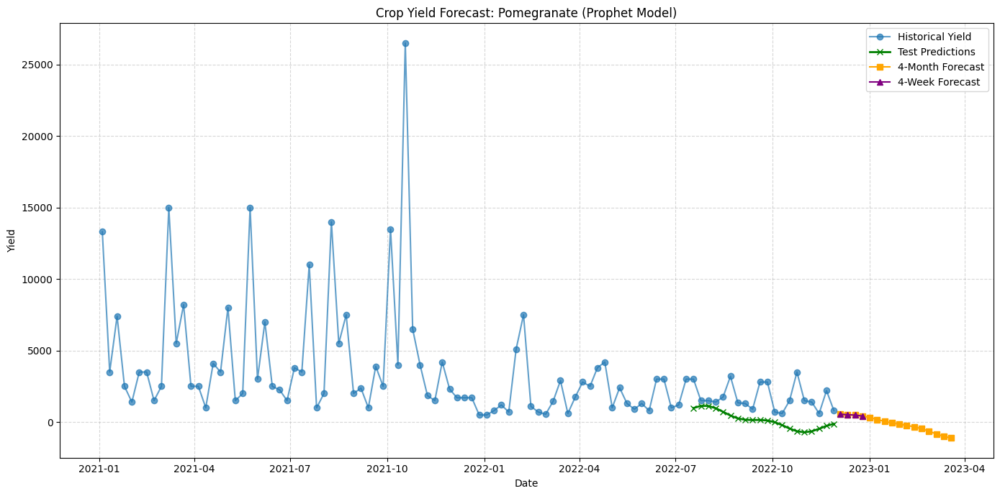

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/pvzso62k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/ql6th732.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=38596', 'data', 'file=/tmp/tmp1y2nc7oi/pvzso62k.json', 'init=/tmp/tmp1y2nc7oi/ql6th732.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model3mmevr4j/prophet_model-20250406233707.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Rice


23:37:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/8v43tzbu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/fbml9_y7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=63626', 'data', 'file=/tmp/tmp1y2nc7oi/8v43tzbu.json', 'init=/tmp/tmp1y2nc7oi/fbml9_y7.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modeluto_bg1z/prophet_model-20250406233708.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:08 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 7922.50 | MAE: 4292.40 | MAPE: 76.64%


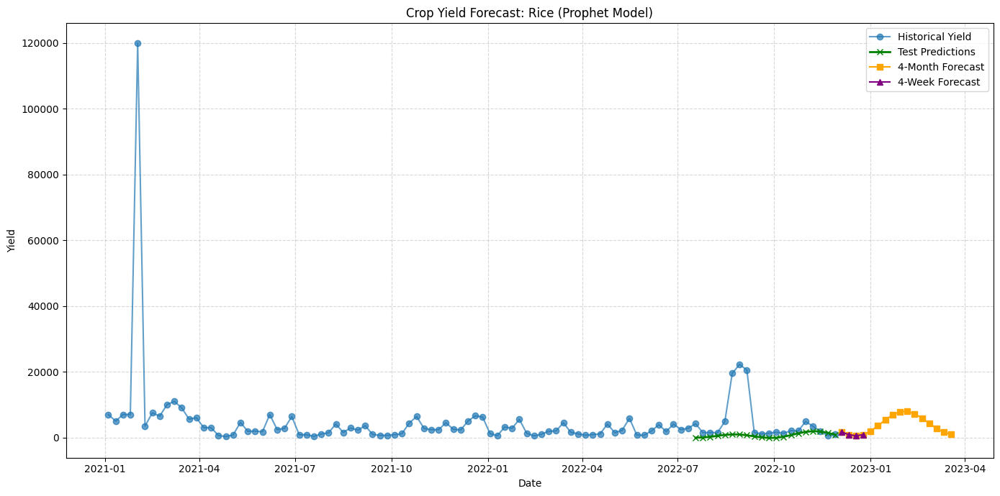

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/5rygrxu_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/7oww5jnj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82827', 'data', 'file=/tmp/tmp1y2nc7oi/5rygrxu_.json', 'init=/tmp/tmp1y2nc7oi/7oww5jnj.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model183nt0ts/prophet_model-20250406233709.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Watermelon


23:37:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/8so0yj2s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/66snh6bn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82708', 'data', 'file=/tmp/tmp1y2nc7oi/8so0yj2s.json', 'init=/tmp/tmp1y2nc7oi/66snh6bn.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelcvycj0f8/prophet_model-20250406233710.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:10 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 3288.06 | MAE: 2316.70 | MAPE: 54.16%


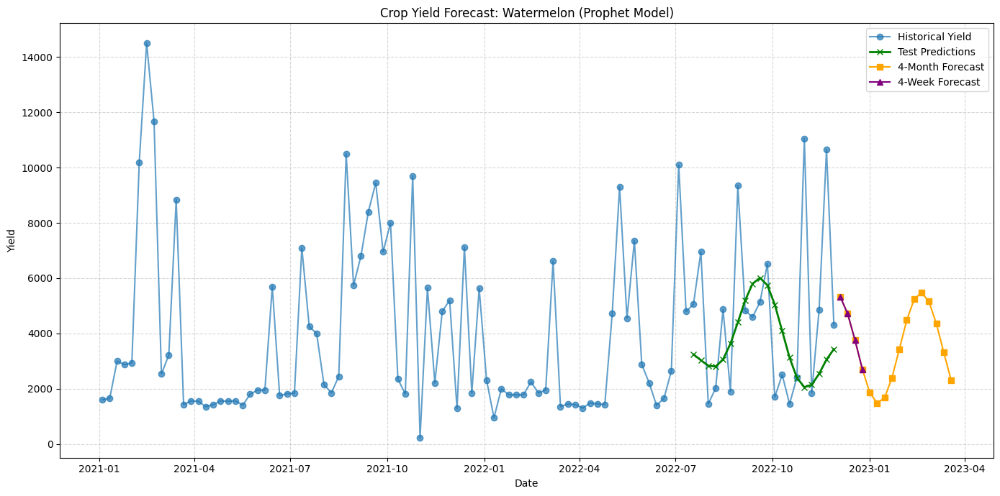



 Final Results Summary:

Apple
Evaluation Metrics:
  RMSE: 1379.85 | MAE: 1078.50 | MAPE: 99.30%

4-Week Forecast:
                  Yield
ds                     
2022-12-04  2176.864931
2022-12-11  1762.241289
2022-12-18  1476.930703
2022-12-25  1405.745746

4-Month Forecast:
                  Yield
ds                     
2022-12-04  2176.864931
2022-12-11  1762.241289
2022-12-18  1476.930703
2022-12-25  1405.745746
2023-01-01  1563.971861
2023-01-08  1888.911857
2023-01-15  2258.182857
2023-01-22  2529.588525
2023-01-29  2589.626241
2023-02-05  2394.195329
2023-02-12  1987.190727
2023-02-19  1489.806605
2023-02-26  1063.183810
2023-03-05   856.188611
2023-03-12   955.449319
2023-03-19  1354.406197

Banana
Evaluation Metrics:
  RMSE: 2239.52 | MAE: 1532.40 | MAPE: 75.88%

4-Week Forecast:
                  Yield
ds                     
2022-12-04  2120.837836
2022-12-11  1995.810311
2022-12-18  2020.715703
2022-12-25  2145.918027

4-Month Forecast:
                  Yield
ds       

In [14]:
import pandas as pd
from prophet import Prophet
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
import numpy as np
import warnings
warnings.filterwarnings("ignore")

df = pd.read_csv('Crop_Data.csv', parse_dates=['Period'])
df = df.rename(columns={'Period': 'ds', 'Yield': 'y'})

crop_groups = df.groupby('Crop')
results = {}

for crop, group in crop_groups:
    print(f"\n{'='*40}\nProcessing crop: {crop}\n{'='*40}")

    crop_df = group.copy().sort_values('ds')

    train_size = int(len(crop_df) * 0.8)
    train_data = crop_df.iloc[:train_size]
    test_data = crop_df.iloc[train_size:]
#bulding prophet model
    try:
        model = Prophet(
            seasonality_mode='multiplicative',
            yearly_seasonality=5,
            weekly_seasonality=True,
            changepoint_prior_scale=0.05,
            seasonality_prior_scale=10.0

        )
        model.fit(train_data[['ds', 'y']])

        future_test = test_data[['ds']].copy()

        forecast_test = model.predict(future_test)
        test_data = test_data.merge(
            forecast_test[['ds', 'yhat']],
            on='ds',
            how='left'
        )
        if not test_data['yhat'].isnull().all():
            test_rmse = np.sqrt(mean_squared_error(test_data['y'], test_data['yhat']))
            test_mae = mean_absolute_error(test_data['y'], test_data['yhat'])
            test_mape = np.mean(np.abs((test_data['y'] - test_data['yhat']) / test_data['y'])) * 100
        else:
            test_rmse = test_mae = test_mape = None

        print(f"[Evaluation Metrics]")
        print(f"RMSE: {test_rmse:.2f} | MAE: {test_mae:.2f} | MAPE: {test_mape:.2f}%")

        full_model = Prophet(
            seasonality_mode='multiplicative',
            yearly_seasonality=5,
            weekly_seasonality=True,
            changepoint_prior_scale=0.05,
            seasonality_prior_scale=10.0

        )

        full_model.fit(crop_df[['ds', 'y']])

        future_4w = full_model.make_future_dataframe(periods=4, freq='W')
        forecast_4w = full_model.predict(future_4w)

        future_4m = full_model.make_future_dataframe(periods=16, freq='W')
        forecast_4m = full_model.predict(future_4m)


        results[crop] = {
            'Test_RMSE': test_rmse,
            'Test_MAE': test_mae,
            'Test_MAPE': test_mape,
            'Forecast_4_weeks': forecast_4w.tail(4).set_index('ds')['yhat'],
            'Forecast_4_months': forecast_4m.tail(16).set_index('ds')['yhat']
        }

        plt.figure(figsize=(14, 7))

        plt.plot(crop_df['ds'], crop_df['y'],
                label='Historical Yield',
                marker='o',
                alpha=0.7)

        plt.plot(test_data['ds'], test_data['yhat'],
                label='Test Predictions',
                marker='x',
                color='green',
                linewidth=2)

        plt.plot(forecast_4m.tail(16)['ds'],
                forecast_4m.tail(16)['yhat'],
                label='4-Month Forecast',
                marker='s',
                color='orange',
                linestyle='-')

        plt.plot(forecast_4w.tail(4)['ds'],
                forecast_4w.tail(4)['yhat'],
                label='4-Week Forecast',
                marker='^',
                color='purple',
                linestyle='-')


        plt.title(f"Crop Yield Forecast: {crop} (Prophet Model)")
        plt.xlabel("Date")
        plt.ylabel("Yield")
        plt.legend()
        plt.grid(True, which='both', linestyle='--', alpha=0.5)
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"Model failed for {crop}: {str(e)}")


print("\n\n Final Results Summary:")
for crop, res in results.items():
    print(f"\n{'='*30}\n{crop}\n{'='*30}")
    print(f"Evaluation Metrics:")

    metrics = []
    for metric in ['Test_RMSE', 'Test_MAE', 'Test_MAPE']:
        value = res[metric]
        metrics.append(f"{value:.2f}" if value is not None else "N/A")

    print(f"  RMSE: {metrics[0]} | MAE: {metrics[1]} | MAPE: {metrics[2]}%")

    print("\n4-Week Forecast:")
    print(res['Forecast_4_weeks'].to_frame(name='Yield') if res['Forecast_4_weeks'] is not None else "No forecast available")

    print("\n4-Month Forecast:")
    print(res['Forecast_4_months'].to_frame(name='Yield') if res['Forecast_4_months'] is not None else "No forecast available")

## 6th model: prohpet with exo

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/07b6_lho.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/ubbimbqy.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=51532', 'data', 'file=/tmp/tmp1y2nc7oi/07b6_lho.json', 'init=/tmp/tmp1y2nc7oi/ubbimbqy.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelwy12qho2/prophet_model-20250406233729.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Apple


23:37:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/qkjp63i1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/ihb2yrgh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=47342', 'data', 'file=/tmp/tmp1y2nc7oi/qkjp63i1.json', 'init=/tmp/tmp1y2nc7oi/ihb2yrgh.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelboi3ctzg/prophet_model-20250406233729.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 1484.65 | MAE: 1202.51 | MAPE: 100.50%


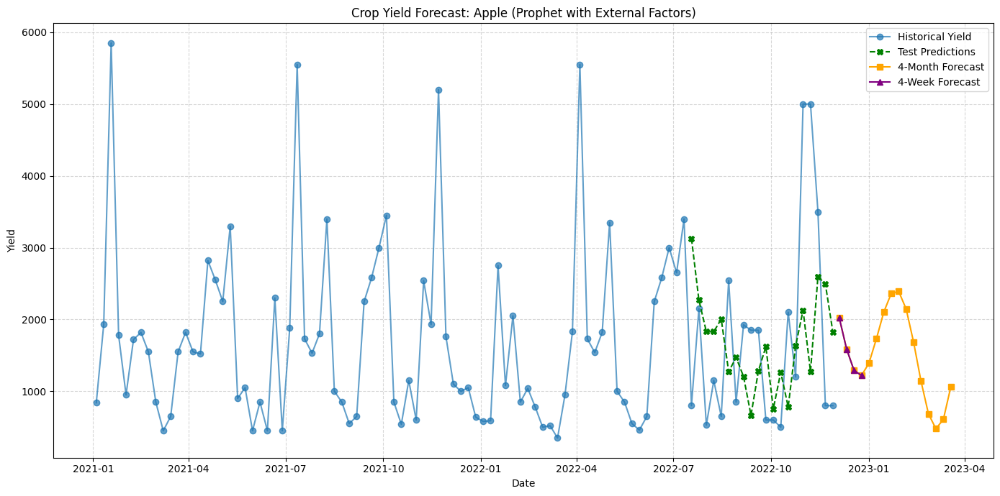

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/oef_wukd.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/byfy5qln.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3565', 'data', 'file=/tmp/tmp1y2nc7oi/oef_wukd.json', 'init=/tmp/tmp1y2nc7oi/byfy5qln.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modeleywpfi5a/prophet_model-20250406233730.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Banana


23:37:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/5vrb826r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/lg4v2uso.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22342', 'data', 'file=/tmp/tmp1y2nc7oi/5vrb826r.json', 'init=/tmp/tmp1y2nc7oi/lg4v2uso.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelp67j9op5/prophet_model-20250406233731.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2408.31 | MAE: 1648.56 | MAPE: 80.32%


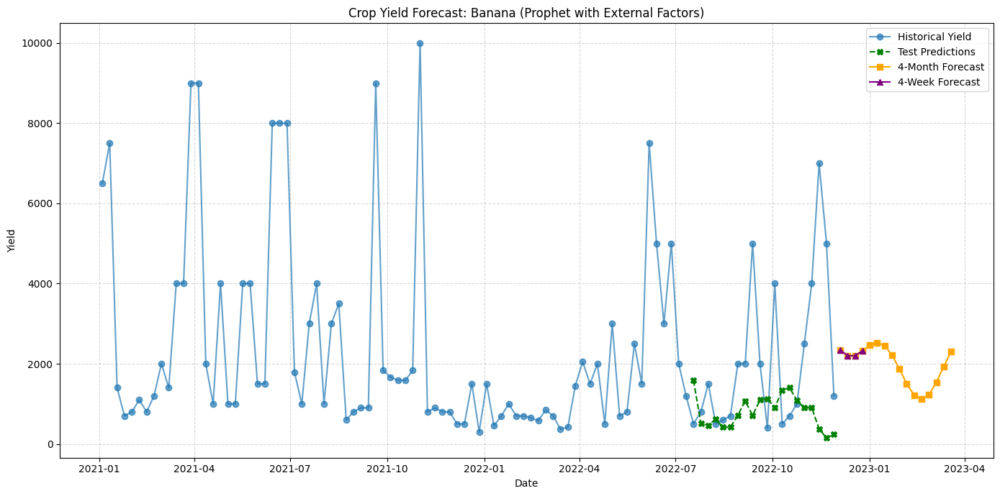

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/1beij50s.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/gosynq0v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=33298', 'data', 'file=/tmp/tmp1y2nc7oi/1beij50s.json', 'init=/tmp/tmp1y2nc7oi/gosynq0v.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelc3lg_4e2/prophet_model-20250406233732.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Blackgram


23:37:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/h1d_quht.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/_wld1v5a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61674', 'data', 'file=/tmp/tmp1y2nc7oi/h1d_quht.json', 'init=/tmp/tmp1y2nc7oi/_wld1v5a.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelcz_a61qv/prophet_model-20250406233733.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 3182.16 | MAE: 2586.69 | MAPE: 30795.91%


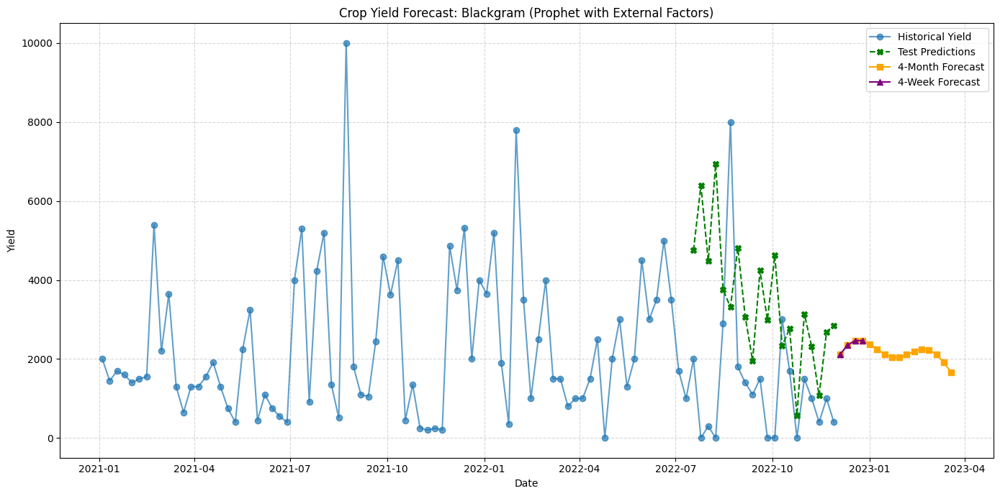

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/pjk_y22b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/w8vjchu0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36743', 'data', 'file=/tmp/tmp1y2nc7oi/pjk_y22b.json', 'init=/tmp/tmp1y2nc7oi/w8vjchu0.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelg4ntiivc/prophet_model-20250406233734.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: ChickPea


23:37:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/mdh3sa45.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/14ltekqr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6348', 'data', 'file=/tmp/tmp1y2nc7oi/mdh3sa45.json', 'init=/tmp/tmp1y2nc7oi/14ltekqr.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model2oqh5ilw/prophet_model-20250406233734.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 3094.43 | MAE: 2350.39 | MAPE: 96.49%


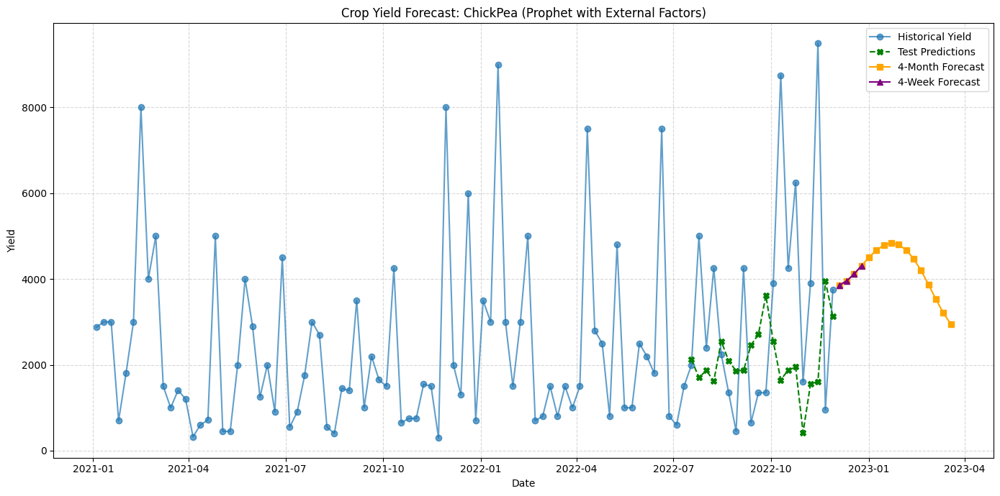

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/yy26bcm2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/azp49awi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46880', 'data', 'file=/tmp/tmp1y2nc7oi/yy26bcm2.json', 'init=/tmp/tmp1y2nc7oi/azp49awi.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelm427kehn/prophet_model-20250406233735.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Coconut


23:37:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/m8_19qj2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/7sbkrmdn.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73243', 'data', 'file=/tmp/tmp1y2nc7oi/m8_19qj2.json', 'init=/tmp/tmp1y2nc7oi/7sbkrmdn.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model0vk42z9g/prophet_model-20250406233735.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2581.61 | MAE: 1980.84 | MAPE: 254.27%


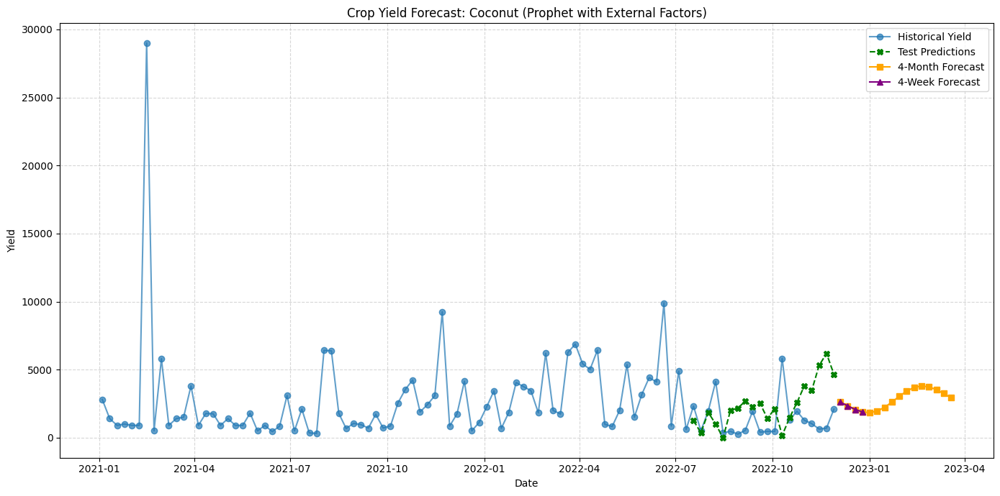

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/03wb9mkb.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/fnrb9z_e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26619', 'data', 'file=/tmp/tmp1y2nc7oi/03wb9mkb.json', 'init=/tmp/tmp1y2nc7oi/fnrb9z_e.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model8i1mt923/prophet_model-20250406233736.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Coffee


23:37:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/rw1kgne6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/rhuusxhg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12365', 'data', 'file=/tmp/tmp1y2nc7oi/rw1kgne6.json', 'init=/tmp/tmp1y2nc7oi/rhuusxhg.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modeltz8v7qo6/prophet_model-20250406233737.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2883.37 | MAE: 2417.48 | MAPE: 165.63%


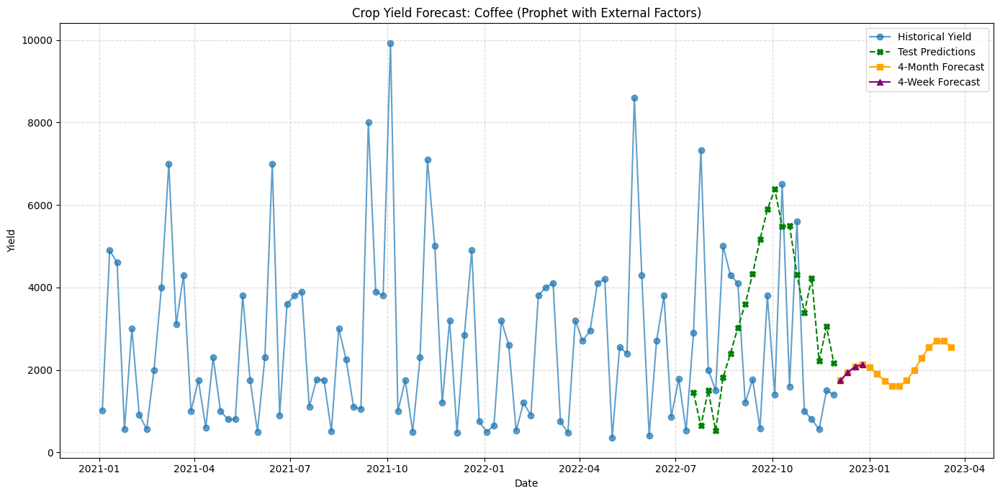

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/s4184kbi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/w6y6vurc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=26568', 'data', 'file=/tmp/tmp1y2nc7oi/s4184kbi.json', 'init=/tmp/tmp1y2nc7oi/w6y6vurc.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model95ennj1f/prophet_model-20250406233737.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Cotton


23:37:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/z92tgs0a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/k7vmf3xj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=97519', 'data', 'file=/tmp/tmp1y2nc7oi/z92tgs0a.json', 'init=/tmp/tmp1y2nc7oi/k7vmf3xj.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelolvcypxn/prophet_model-20250406233738.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 8138.33 | MAE: 5782.71 | MAPE: 826.65%


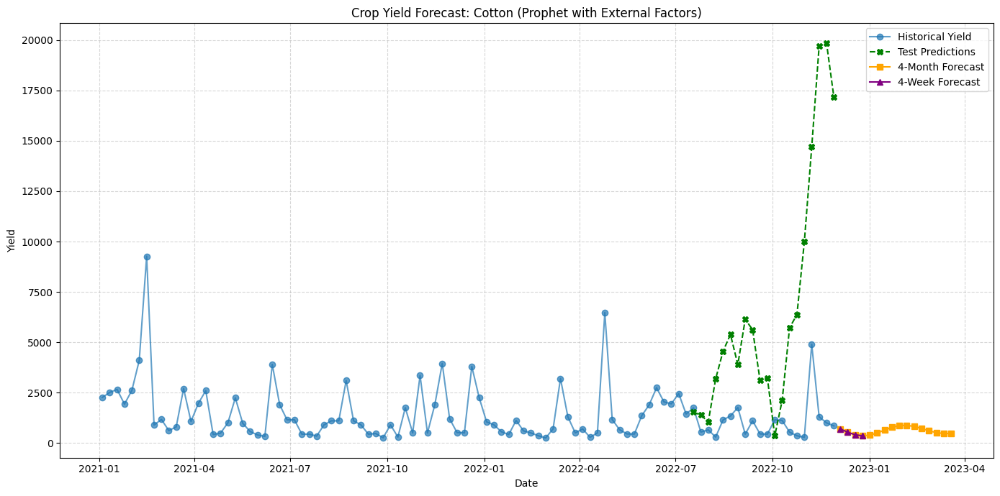

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/n7j6sw3n.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/lwgm05yg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70061', 'data', 'file=/tmp/tmp1y2nc7oi/n7j6sw3n.json', 'init=/tmp/tmp1y2nc7oi/lwgm05yg.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelt8qa7_f_/prophet_model-20250406233739.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Grapes


23:37:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/_6efoabz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/3xxyyo3l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12762', 'data', 'file=/tmp/tmp1y2nc7oi/_6efoabz.json', 'init=/tmp/tmp1y2nc7oi/3xxyyo3l.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelr1w0tj_5/prophet_model-20250406233739.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 3074.11 | MAE: 2553.70 | MAPE: 95.84%


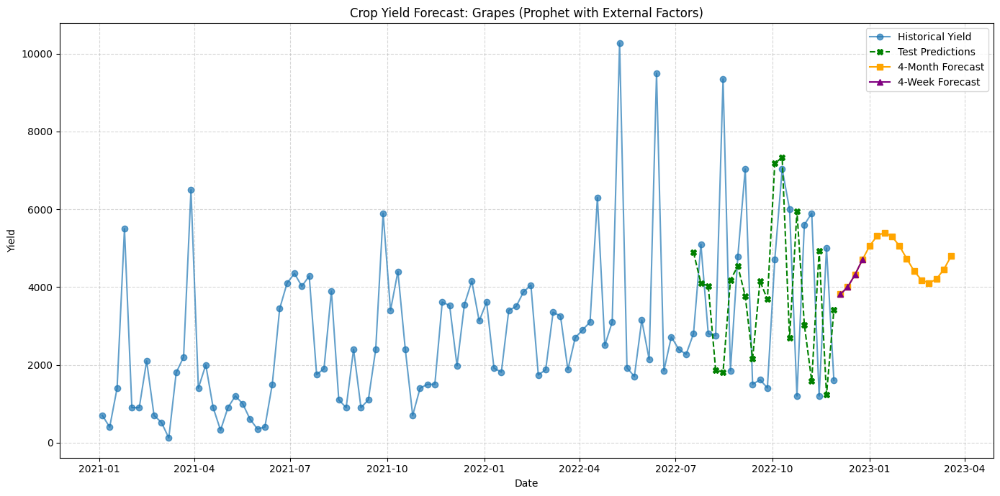

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/4zjcn1m1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/fzx1rr88.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=80117', 'data', 'file=/tmp/tmp1y2nc7oi/4zjcn1m1.json', 'init=/tmp/tmp1y2nc7oi/fzx1rr88.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelqnbbxcf2/prophet_model-20250406233740.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:40 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Jute


23:37:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/5tiedlyl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/e16khz4v.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41788', 'data', 'file=/tmp/tmp1y2nc7oi/5tiedlyl.json', 'init=/tmp/tmp1y2nc7oi/e16khz4v.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model2ry67m08/prophet_model-20250406233741.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2636.96 | MAE: 2051.36 | MAPE: 90.75%


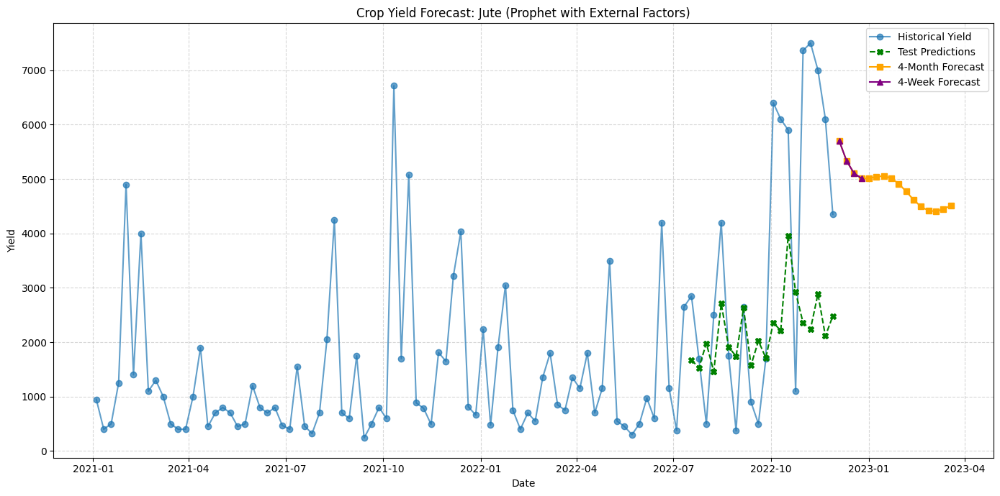

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/yfz9nxgv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/rlwo0h7i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13181', 'data', 'file=/tmp/tmp1y2nc7oi/yfz9nxgv.json', 'init=/tmp/tmp1y2nc7oi/rlwo0h7i.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model8sfnwoqb/prophet_model-20250406233742.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: KidneyBeans


23:37:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/i830h78x.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/c5c47h4r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42964', 'data', 'file=/tmp/tmp1y2nc7oi/i830h78x.json', 'init=/tmp/tmp1y2nc7oi/c5c47h4r.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelgz4ntg84/prophet_model-20250406233743.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 1999.39 | MAE: 1669.30 | MAPE: 69.93%


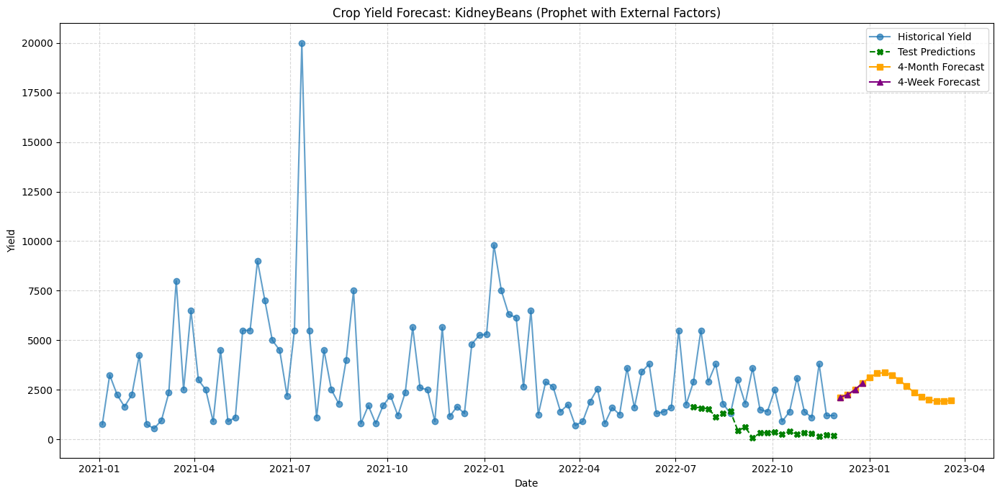

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/tyzqeq6_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/o55zl0xp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65006', 'data', 'file=/tmp/tmp1y2nc7oi/tyzqeq6_.json', 'init=/tmp/tmp1y2nc7oi/o55zl0xp.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model4ii0hodj/prophet_model-20250406233744.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Lentil


23:37:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/cyn1jndk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/rl981v8b.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22552', 'data', 'file=/tmp/tmp1y2nc7oi/cyn1jndk.json', 'init=/tmp/tmp1y2nc7oi/rl981v8b.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelnpf97h13/prophet_model-20250406233744.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2693.70 | MAE: 1858.47 | MAPE: 2080.36%


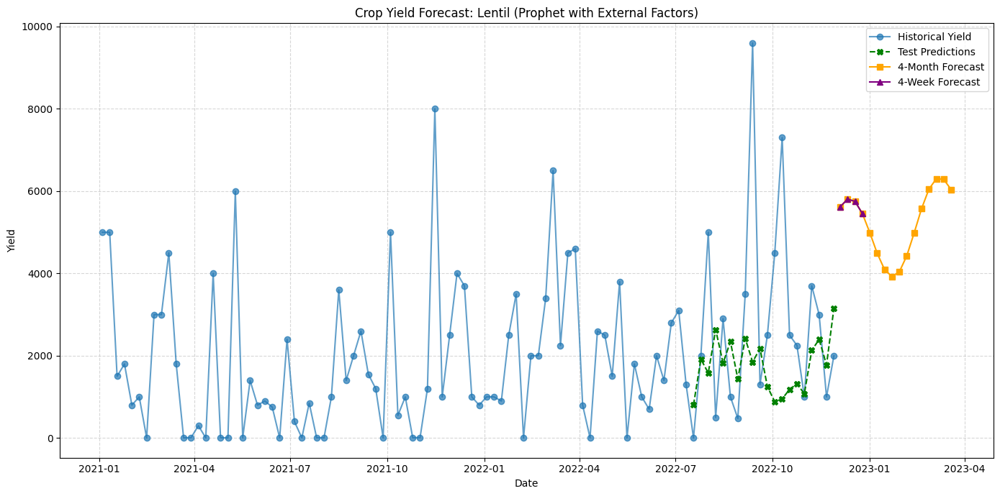

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/05dfcjdz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/kpe3smsw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53911', 'data', 'file=/tmp/tmp1y2nc7oi/05dfcjdz.json', 'init=/tmp/tmp1y2nc7oi/kpe3smsw.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model1oztqlb7/prophet_model-20250406233745.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Maize


23:37:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/1y6c6130.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/4gv0cam6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=95394', 'data', 'file=/tmp/tmp1y2nc7oi/1y6c6130.json', 'init=/tmp/tmp1y2nc7oi/4gv0cam6.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelqdx_bwv9/prophet_model-20250406233745.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 1701.75 | MAE: 1492.64 | MAPE: 143.51%


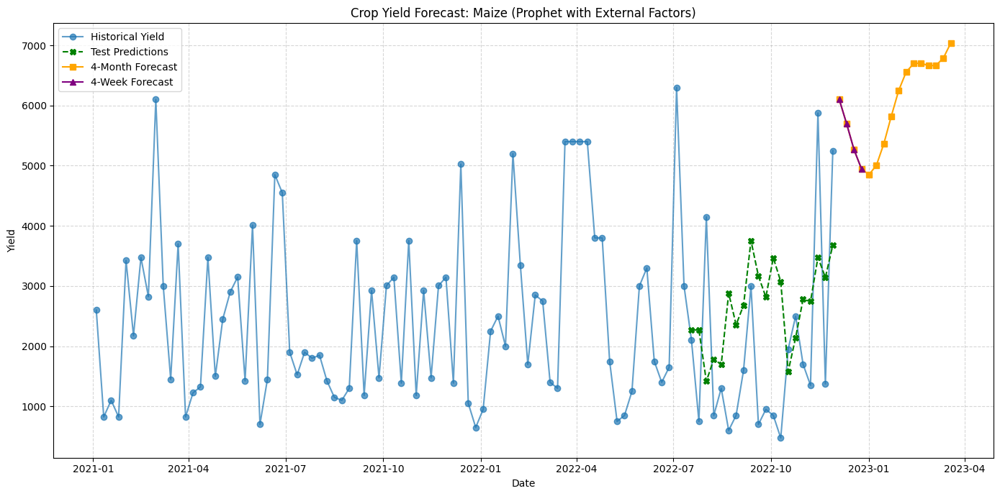

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/nsitwmzz.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/vszxfssx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42132', 'data', 'file=/tmp/tmp1y2nc7oi/nsitwmzz.json', 'init=/tmp/tmp1y2nc7oi/vszxfssx.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model1d7iec04/prophet_model-20250406233746.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Mango


23:37:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/klj0tyls.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/k03piguv.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=46472', 'data', 'file=/tmp/tmp1y2nc7oi/klj0tyls.json', 'init=/tmp/tmp1y2nc7oi/k03piguv.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelfins8ce9/prophet_model-20250406233747.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 4900.20 | MAE: 4184.67 | MAPE: 582.94%


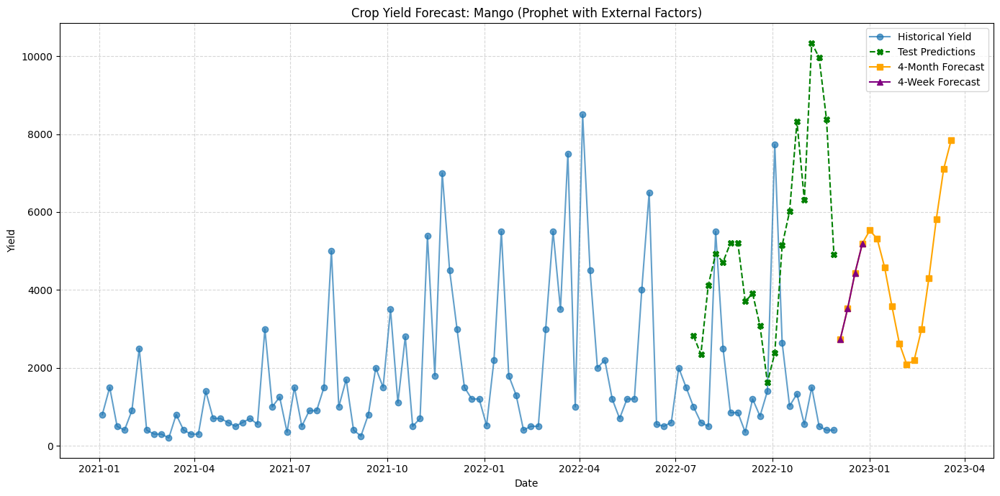

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/k8wvtn6a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/h3lg0lid.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65717', 'data', 'file=/tmp/tmp1y2nc7oi/k8wvtn6a.json', 'init=/tmp/tmp1y2nc7oi/h3lg0lid.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model2l4n2zy1/prophet_model-20250406233748.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: MothBeans


23:37:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/6gyzg9gr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/3l7npz28.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12646', 'data', 'file=/tmp/tmp1y2nc7oi/6gyzg9gr.json', 'init=/tmp/tmp1y2nc7oi/3l7npz28.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelbbj7wfgg/prophet_model-20250406233749.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:49 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:49 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 899.54 | MAE: 707.05 | MAPE: 29.68%


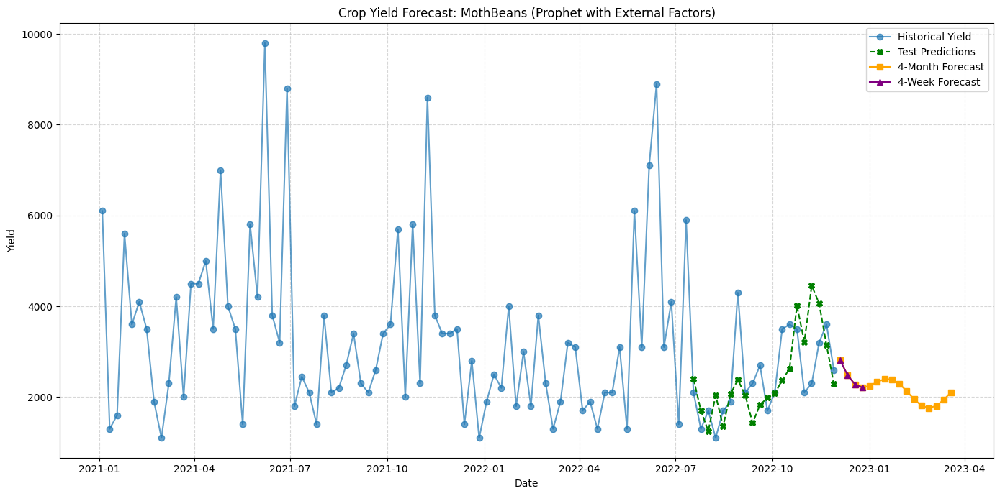

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/qa319oe3.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/eflo9q5w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4086', 'data', 'file=/tmp/tmp1y2nc7oi/qa319oe3.json', 'init=/tmp/tmp1y2nc7oi/eflo9q5w.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model21llp9yf/prophet_model-20250406233751.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: MungBean


23:37:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/5r10e2pu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/dbzuynup.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22819', 'data', 'file=/tmp/tmp1y2nc7oi/5r10e2pu.json', 'init=/tmp/tmp1y2nc7oi/dbzuynup.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelcmkklq5r/prophet_model-20250406233752.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:52 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 1206.08 | MAE: 1087.78 | MAPE: 104.11%


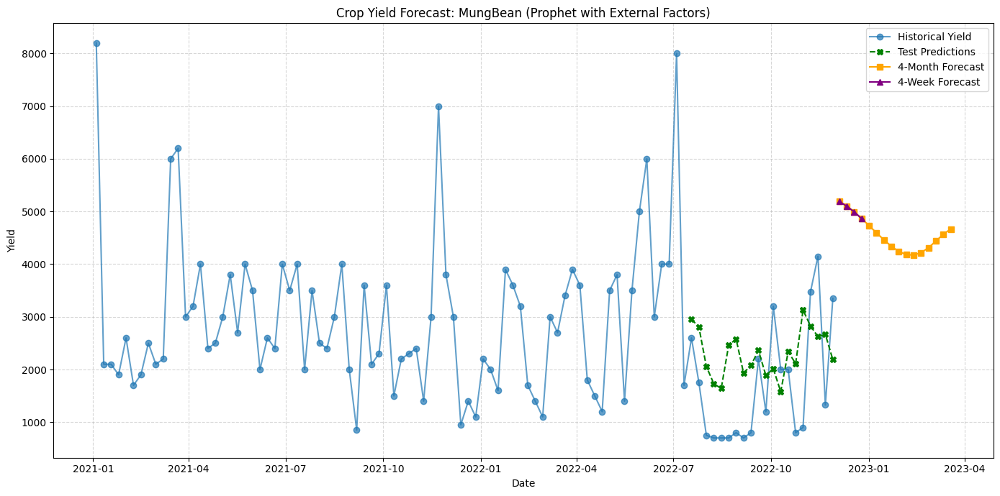

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/iqcvxwik.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/jqljjf2c.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42009', 'data', 'file=/tmp/tmp1y2nc7oi/iqcvxwik.json', 'init=/tmp/tmp1y2nc7oi/jqljjf2c.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modellezv7639/prophet_model-20250406233754.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:54 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Muskmelon


23:37:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/btodu_4k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/v2bcc64j.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50069', 'data', 'file=/tmp/tmp1y2nc7oi/btodu_4k.json', 'init=/tmp/tmp1y2nc7oi/v2bcc64j.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelt15dbiz_/prophet_model-20250406233755.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:55 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:55 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 1229.62 | MAE: 1042.37 | MAPE: 126.04%


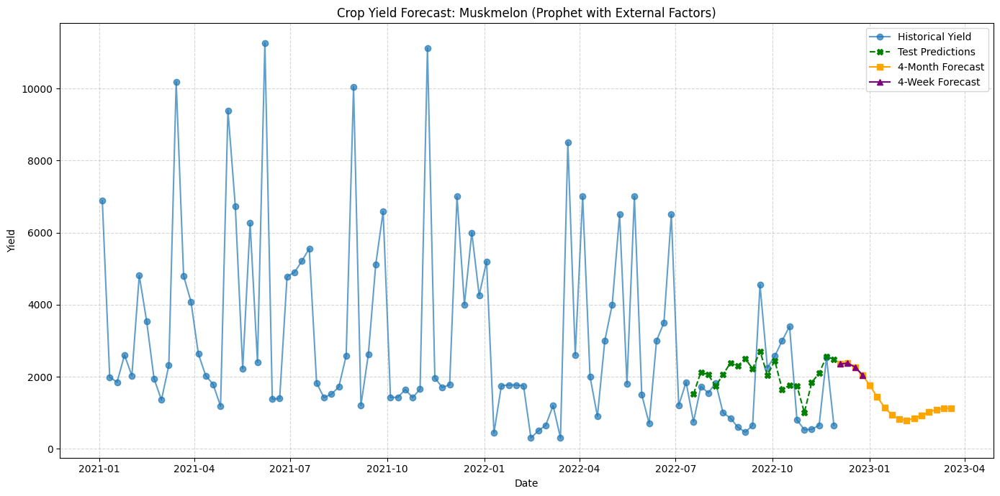

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/hqk7uvby.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/f7a16gn9.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75508', 'data', 'file=/tmp/tmp1y2nc7oi/hqk7uvby.json', 'init=/tmp/tmp1y2nc7oi/f7a16gn9.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modeltkz4coyr/prophet_model-20250406233756.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Orange


23:37:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/u6unht90.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/815yzb9_.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=20966', 'data', 'file=/tmp/tmp1y2nc7oi/u6unht90.json', 'init=/tmp/tmp1y2nc7oi/815yzb9_.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelxd9tklaj/prophet_model-20250406233757.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 1265.53 | MAE: 1037.15 | MAPE: 122.87%


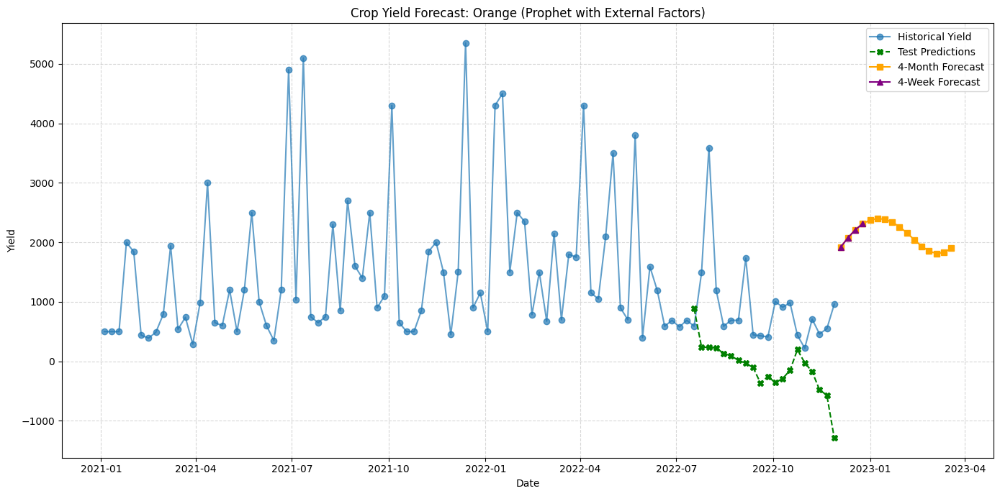

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/5kcusrgk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/hcyru7q3.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43742', 'data', 'file=/tmp/tmp1y2nc7oi/5kcusrgk.json', 'init=/tmp/tmp1y2nc7oi/hcyru7q3.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modeldgf3rwwt/prophet_model-20250406233758.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:37:58 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Papaya


23:37:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/i1_vctf5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/h483_xvj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=27103', 'data', 'file=/tmp/tmp1y2nc7oi/i1_vctf5.json', 'init=/tmp/tmp1y2nc7oi/h483_xvj.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelnis03mm9/prophet_model-20250406233759.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:37:59 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:37:59 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2787.87 | MAE: 2326.92 | MAPE: 144.88%


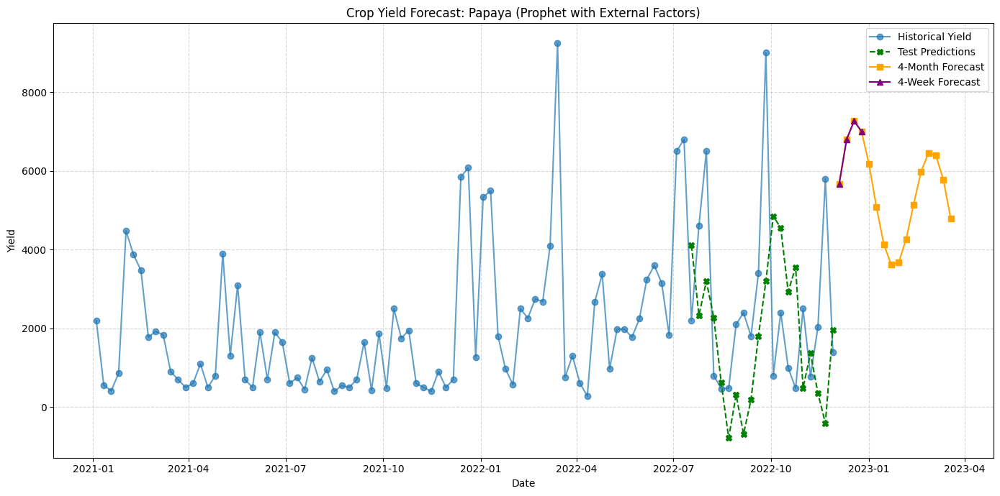

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/aleznhyi.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/7nacux2x.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=12107', 'data', 'file=/tmp/tmp1y2nc7oi/aleznhyi.json', 'init=/tmp/tmp1y2nc7oi/7nacux2x.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelltcjxaud/prophet_model-20250406233800.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:38:00 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: PigeonPeas


23:38:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/toc0ifdv.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/k8e2skse.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=79077', 'data', 'file=/tmp/tmp1y2nc7oi/toc0ifdv.json', 'init=/tmp/tmp1y2nc7oi/k8e2skse.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modeleqw7gjd8/prophet_model-20250406233801.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:38:01 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:38:01 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 11651.06 | MAE: 8918.63 | MAPE: 231.70%


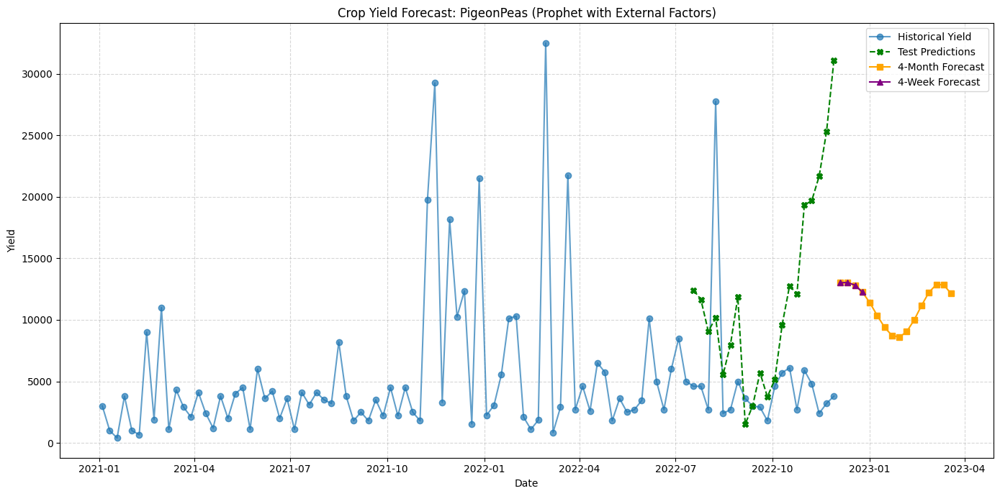

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/ziqzlz3q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/cgdgok_e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29827', 'data', 'file=/tmp/tmp1y2nc7oi/ziqzlz3q.json', 'init=/tmp/tmp1y2nc7oi/cgdgok_e.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_model3u6j5v_j/prophet_model-20250406233802.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:38:02 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Pomegranate


23:38:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/xynamsga.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/hd8y4z6p.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=77741', 'data', 'file=/tmp/tmp1y2nc7oi/xynamsga.json', 'init=/tmp/tmp1y2nc7oi/hd8y4z6p.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelykdt4yps/prophet_model-20250406233803.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:38:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:38:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 2082.95 | MAE: 1807.05 | MAPE: 115.74%


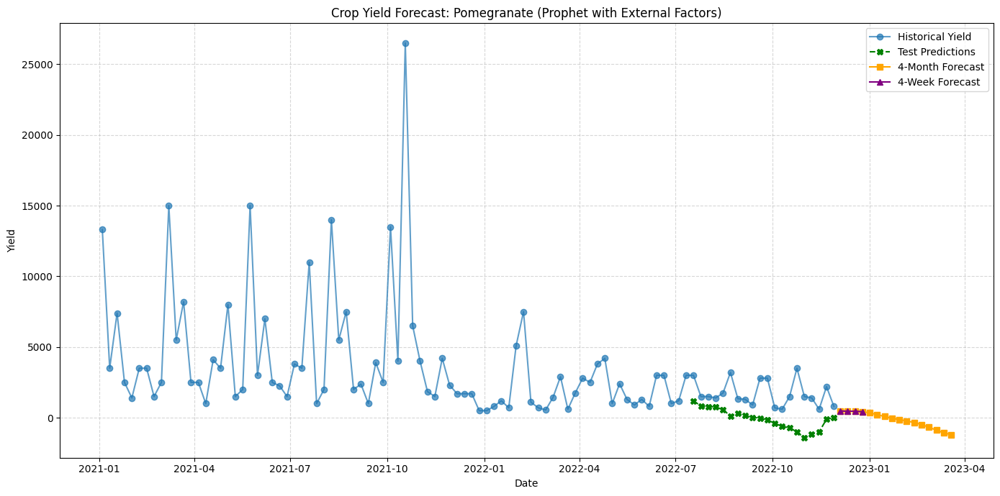

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/22rdib08.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/dvwp7_bi.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=14580', 'data', 'file=/tmp/tmp1y2nc7oi/22rdib08.json', 'init=/tmp/tmp1y2nc7oi/dvwp7_bi.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modeltqd7ax0a/prophet_model-20250406233804.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:38:04 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Rice


23:38:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/2tzndv_c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/0ozr5ylo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=29616', 'data', 'file=/tmp/tmp1y2nc7oi/2tzndv_c.json', 'init=/tmp/tmp1y2nc7oi/0ozr5ylo.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelpb8647r5/prophet_model-20250406233806.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:38:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:38:06 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 12842.15 | MAE: 10212.27 | MAPE: 405.45%


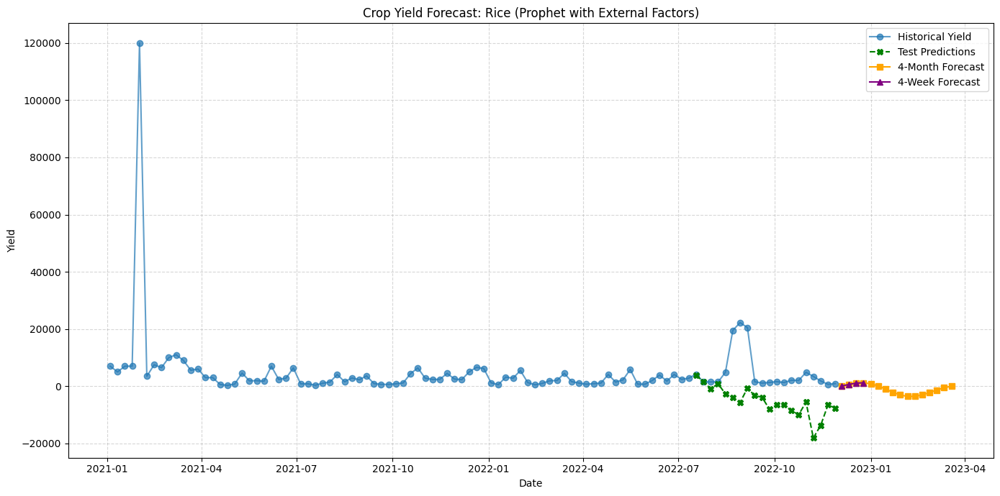

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/89kagl8f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/z70ox6j0.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=30007', 'data', 'file=/tmp/tmp1y2nc7oi/89kagl8f.json', 'init=/tmp/tmp1y2nc7oi/z70ox6j0.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelo3xzq77n/prophet_model-20250406233807.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
23:38:07 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



Processing crop: Watermelon


23:38:08 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/abaymwev.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp1y2nc7oi/pj6ln8rm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=40767', 'data', 'file=/tmp/tmp1y2nc7oi/abaymwev.json', 'init=/tmp/tmp1y2nc7oi/pj6ln8rm.json', 'output', 'file=/tmp/tmp1y2nc7oi/prophet_modelfnygc8vm/prophet_model-20250406233809.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
23:38:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
23:38:09 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


[Evaluation Metrics]
RMSE: 3296.80 | MAE: 2507.29 | MAPE: 63.46%


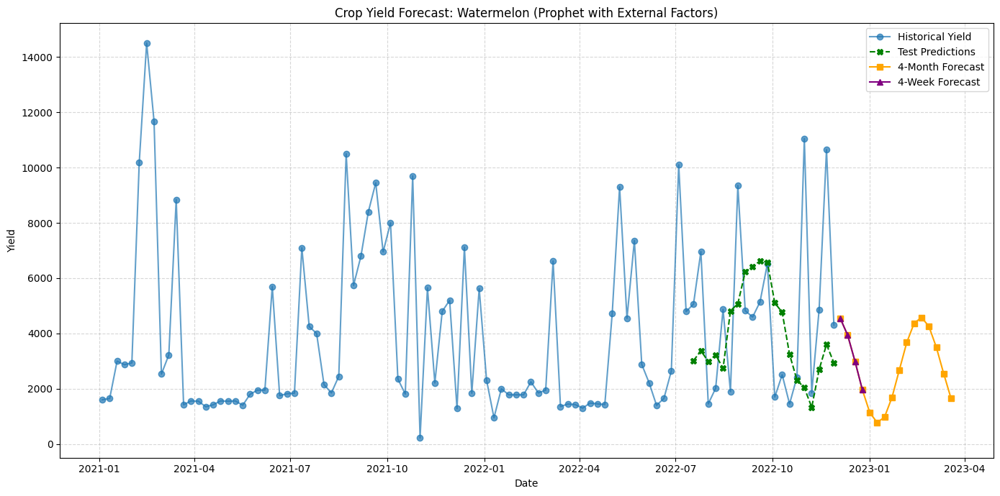



 Final Results Summary:

Apple
Evaluation Metrics:
  RMSE: 1484.65 | MAE: 1202.51 | MAPE: 100.50%

4-Week Forecast:
                  Yield
ds                     
2022-12-04  2025.943889
2022-12-11  1586.430794
2022-12-18  1289.045726
2022-12-25  1220.392869

4-Month Forecast:
                  Yield
ds                     
2022-12-04  2025.943889
2022-12-11  1586.430794
2022-12-18  1289.045726
2022-12-25  1220.392869
2023-01-01  1391.393644
2023-01-08  1730.347813
2023-01-15  2104.384843
2023-01-22  2363.106713
2023-01-29  2390.232330
2023-02-05  2145.744425
2023-02-12  1683.699326
2023-02-19  1138.722403
2023-02-26   684.686697
2023-03-05   478.613394
2023-03-12   608.152744
2023-03-19  1060.212726

Banana
Evaluation Metrics:
  RMSE: 2408.31 | MAE: 1648.56 | MAPE: 80.32%

4-Week Forecast:
                  Yield
ds                     
2022-12-04  2343.620546
2022-12-11  2198.057447
2022-12-18  2203.685283
2022-12-25  2318.446576

4-Month Forecast:
                  Yield
ds      

In [15]:
import pandas as pd
from prophet import Prophet
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
import numpy as np
import warnings
warnings.filterwarnings("ignore")

df = pd.read_csv('Crop_Data.csv', parse_dates=['Period'])
df = df.rename(columns={'Period': 'ds', 'Yield': 'y'})
exog_features = ['Nitrogen', 'Phosphorus', 'Potassium', 'Temperature', 'Humidity', 'pH_Value', 'Rainfall']

crop_groups = df.groupby('Crop')
results = {}

for crop, group in crop_groups:
    print(f"\n{'='*40}\nProcessing crop: {crop}\n{'='*40}")

    crop_df = group.copy().sort_values('ds')

    crop_df[exog_features] = crop_df[exog_features].ffill().bfill() #adding external feautes here

    train_size = int(len(crop_df) * 0.8)
    train_data = crop_df.iloc[:train_size]
    test_data = crop_df.iloc[train_size:]

    try:
        model = Prophet(
            seasonality_mode='multiplicative',
            yearly_seasonality=5,
            weekly_seasonality=True,
            changepoint_prior_scale=0.05,
            seasonality_prior_scale=10.0
        )
        for feature in exog_features:
            model.add_regressor(feature)

        train_df = train_data[['ds', 'y'] + exog_features].copy()
        model.fit(train_df)

        future_test = test_data[['ds'] + exog_features].copy()
        forecast_test = model.predict(future_test)
        test_data = test_data.merge(
            forecast_test[['ds', 'yhat']],
            on='ds',
            how='left'
        )

        test_rmse = np.sqrt(mean_squared_error(test_data['y'], test_data['yhat']))
        test_mae = mean_absolute_error(test_data['y'], test_data['yhat'])
        test_mape = np.mean(np.abs((test_data['y'] - test_data['yhat']) / test_data['y'])) * 100

        print(f"[Evaluation Metrics]")
        print(f"RMSE: {test_rmse:.2f} | MAE: {test_mae:.2f} | MAPE: {test_mape:.2f}%")

        full_model = Prophet(
            seasonality_mode='multiplicative',
            yearly_seasonality=5,
            weekly_seasonality=True,
            changepoint_prior_scale=0.05,
            seasonality_prior_scale=10.0
        )

        for feature in exog_features:
            full_model.add_regressor(feature)

        full_model.fit(crop_df[['ds', 'y'] + exog_features])

        future_4w = full_model.make_future_dataframe(periods=4, freq='W')
        future_4m = full_model.make_future_dataframe(periods=16, freq='W')

        last_values = crop_df[exog_features].iloc[-1]

        future_4w[exog_features] = last_values.values
        future_4m[exog_features] = last_values.values

        forecast_4w = full_model.predict(future_4w)
        forecast_4m = full_model.predict(future_4m)

        results[crop] = {
            'Test_RMSE': test_rmse,
            'Test_MAE': test_mae,
            'Test_MAPE': test_mape,
            'Forecast_4_weeks': forecast_4w.tail(4).set_index('ds')['yhat'],
            'Forecast_4_months': forecast_4m.tail(16).set_index('ds')['yhat']
        }

        plt.figure(figsize=(14, 7))
        plt.plot(crop_df['ds'], crop_df['y'], label='Historical Yield', marker='o', alpha=0.7)
        plt.plot(test_data['ds'], test_data['yhat'], label='Test Predictions',marker='X', linestyle='--', color='green')
        plt.plot(forecast_4m.tail(16)['ds'], forecast_4m.tail(16)['yhat'],
                label='4-Month Forecast', marker='s', color='orange')
        plt.plot(forecast_4w.tail(4)['ds'], forecast_4w.tail(4)['yhat'],
                label='4-Week Forecast', marker='^', color='purple')

        plt.title(f"Crop Yield Forecast: {crop} (Prophet with External Factors)")
        plt.xlabel("Date")
        plt.ylabel("Yield")
        plt.legend()
        plt.grid(True, linestyle='--', alpha=0.5)
        plt.tight_layout()
        plt.show()

    except Exception as e:
        print(f"Model failed for {crop}: {str(e)}")
        results[crop] = {
            'Test_RMSE': None,
            'Test_MAE': None,
            'Test_MAPE': None,
            'Forecast_4_weeks': None,
            'Forecast_4_months': None
        }


print("\n\n Final Results Summary:")
for crop, res in results.items():
    print(f"\n{'='*30}\n{crop}\n{'='*30}")
    print(f"Evaluation Metrics:")

    metrics = []
    for metric in ['Test_RMSE', 'Test_MAE', 'Test_MAPE']:
        value = res[metric]
        metrics.append(f"{value:.2f}" if value is not None else "N/A")

    print(f"  RMSE: {metrics[0]} | MAE: {metrics[1]} | MAPE: {metrics[2]}%")

    print("\n4-Week Forecast:")
    print(res['Forecast_4_weeks'].to_frame(name='Yield') if res['Forecast_4_weeks'] is not None else "No forecast available")

    print("\n4-Month Forecast:")
    print(res['Forecast_4_months'].to_frame(name='Yield') if res['Forecast_4_months'] is not None else "No forecast available")

# References

In [ ]:
#references
# https://www.sktime.net/en/stable/api_reference/auto_generated/sktime.forecasting.sarimax.SARIMAX.html
# https://www.analyticsvidhya.com/blog/2024/01/xgboost-for-time-series-forecasting/
# https://facebook.github.io/prophet/docs/quick_start.html